# Data Cleaning Pipeline

In [1]:
# Only need to assign the two values below first, then run all
watershed = 'DryCreek'
main_str = 'LG'

In [2]:
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib.pyplot as plt
import copy
from pandas.plotting import register_matplotlib_converters
from sklearn import linear_model
from sklearn.metrics import r2_score
import copy
import os
import matplotlib.backends.backend_pdf
lm = linear_model.LinearRegression()
np.random.seed(50)
plt.rcParams.update({'figure.max_open_warning': 0})
register_matplotlib_converters()
os.getcwd()

'/Volumes/GoogleDrive/My Drive/DataReleasePaper/ReleaseData/2-DryCreek'

In [3]:
# local functions
import sys
sys.path.insert(1, './Functions')

from Abnormal_data_values_control import outvalues,threC
from Source_QC_functions_EM import interpolateQC, regressorFunc, funcClimateCatalog, AssembleClimateCatalog

In [4]:
# Read the original data table
table = pd.read_csv('1_'+watershed+'_Download_Aggregation.csv',header = 0,index_col = 'DateTime',
                    parse_dates = True, infer_datetime_format = True,low_memory=False)
display(table.head(2))
display(table.tail(2))

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
2020-05-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.218182,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-05-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.108333,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
# Check all the station names
all_stations = table.columns.str.extract(r'([^_]+)')[0]
print('All stations names: ', all_stations.unique())
print ('  ')
nameStrflwStation=[]
nameHydrMetStation=[]
for i in np.arange(len(table.columns)):
    if table.columns[i][-9:]=='Discharge':  ### 
        if not all_stations[i] in nameStrflwStation:
            nameStrflwStation.append(all_stations[i]) ### 
    else:
        if not all_stations[i] in nameHydrMetStation:
            nameHydrMetStation.append(all_stations[i])  ### 

print('Discharge stations :',nameStrflwStation)
print('  ')
print('Meteorology stations:',nameHydrMetStation)                  

All stations names:  ['TL' 'BSG' 'LG' 'C1E' 'C1W' 'C2E' 'C2M' 'BRW' 'LDP' 'SCR' 'LW' 'HN' 'HS'
 'MHN' 'MHS' 'MLN' 'MLS' 'LN' 'LS']
  
Discharge stations : ['TL', 'BSG', 'LG', 'C1E', 'C1W', 'C2E', 'C2M']
  
Meteorology stations: ['BRW', 'LDP', 'SCR', 'TL', 'LW', 'HN', 'HS', 'MHN', 'MHS', 'MLN', 'MLS', 'LN', 'LS']


In [6]:
for i in table.columns:
    if i.split('_')[0] == main_str :
        print(i)

LG_Discharge


In [7]:
len(nameHydrMetStation)

13

#  1. Trim the original table

In [8]:
# Trim the data and let the table start with first non nan value, end with last non nan value
# Identify the first non nan value in each column as the starting date.
# Identify the last non nan value in each column as the ending date.

t = table.notna() 
t = ~np.isnan(table)
col = len(t.columns)
b = np.zeros([table.shape[1]])
c = np.array([table.shape[0]] * table.shape[1])

for i in range(col):
    if any(t.iloc[:,i]): # Since some are empty
        b[i] = list(np.where(t.iloc[:,i] == True))[0][0] # the first non nan value location
        c[i] = list(np.where(t.iloc[:,i] == True))[0][-1] # the last non nan value location
        
st_tab = b.min()
table1 = table.iloc[int(b.min()):int(c.max()) + 1,:] 

# Display the trimmed table
display(table1.head(2))
display(table1.tail(2))
print('trimmed row number is ', int(table.shape[0] -  table1.shape[0]))

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
2020-05-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.218182,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-05-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.108333,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


trimmed row number is  0


### Drop columns without data

In [9]:
tt = copy.deepcopy(table1)
for dd in np.arange(len(tt.columns)):
    if all(pd.isna(tt.iloc[:,dd])):
        print('The empty column is ', dd,tt.columns[dd])
        table1.drop(columns = tt.columns[dd], axis=1, inplace = True)

var_number = table1.shape[1] 

if table1.shape[1]  == table.shape[1] :
    print('There are no empty columns!')

There are no empty columns!


### Save the original discharge table seperately

In [10]:
DischargeTable = pd.DataFrame(index = table1.index)
for i in np.arange(len(nameStrflwStation)):
    DischargeTable[nameStrflwStation[i]+'_Discharge'] = table1.loc[:,nameStrflwStation[i]+'_Discharge']

DischargeTable.to_csv('1_'+ watershed + '_DischargeTable.csv')

# 2. Data filling method: Interpolation

 
0 TL_Discharge : There are missing data!
0 TL_Discharge index of interpolated length = 71
No filled values are out of original data range
 
1 BSG_Discharge : There are missing data!
0 BSG_Discharge index of interpolated length = 126
No filled values are out of original data range
 
2 LG_Discharge : There are missing data!
0 LG_Discharge index of interpolated length = 381
No filled values are out of original data range
 
3 C1E_Discharge : There are missing data!
0 C1E_Discharge index of interpolated length = 17
No filled values are out of original data range
 
4 C1W_Discharge : There are missing data!
0 C1W_Discharge index of interpolated length = 71
No filled values are out of original data range
 
5 C2E_Discharge : There are missing data!
0 C2E_Discharge index of interpolated length = 91
No filled values are out of original data range
 
6 C2M_Discharge : There are missing data!
0 C2M_Discharge index of interpolated length = 108
No filled values are out of original data range
 
7 BRW

No filled values are out of original data range
 
54 BRW_SoilMoisture_U_55cm : There are missing data!
0 BRW_SoilMoisture_U_55cm index of interpolated length = 49
No filled values are out of original data range
 
55 LDP_SoilMoisture_W_8cm : There are missing data!
0 LDP_SoilMoisture_W_8cm index of interpolated length = 163
No filled values are out of original data range
 
56 LDP_SoilMoisture_E_8cm : There are missing data!
0 LDP_SoilMoisture_E_8cm index of interpolated length = 159
No filled values are out of original data range
 
57 SCR_SoilMoisture_5cm : There are missing data!
0 SCR_SoilMoisture_5cm index of interpolated length = 41
No filled values are out of original data range
 
58 TL_SoilMoisture_P3_5cm : There are missing data!
0 TL_SoilMoisture_P3_5cm index of interpolated length = 180
No filled values are out of original data range
 
59 TL_SoilMoisture_P3_15cm : There are missing data!
0 TL_SoilMoisture_P3_15cm index of interpolated length = 179
No filled values are out of or

No filled values are out of original data range
 
104 HS_SoilMoisture_Pit3_30cm : There are missing data!
0 HS_SoilMoisture_Pit3_30cm index of interpolated length = 36
No filled values are out of original data range
 
105 HS_SoilMoisture_Pit3_80cmBdrk : There are missing data!
0 HS_SoilMoisture_Pit3_80cmBdrk index of interpolated length = 313
No filled values are out of original data range
 
106 HS_SoilMoisture_Pit4_2cm : There are missing data!
0 HS_SoilMoisture_Pit4_2cm index of interpolated length = 198
No filled values are out of original data range
 
107 HS_SoilMoisture_Pit4_15cm : There are missing data!
0 HS_SoilMoisture_Pit4_15cm index of interpolated length = 174
No filled values are out of original data range
 
108 HS_SoilMoisture_Pit4_30cm : There are missing data!
0 HS_SoilMoisture_Pit4_30cm index of interpolated length = 177
No filled values are out of original data range
 
109 HS_SoilMoisture_Pit4_77cmBdrk : There are missing data!
0 HS_SoilMoisture_Pit4_77cmBdrk index of

No filled values are out of original data range
 
152 MLN_SoilMoisture_Pit3_30cm : There are missing data!
0 MLN_SoilMoisture_Pit3_30cm index of interpolated length = 222
No filled values are out of original data range
 
153 MLN_SoilMoisture_Pit3_61cmBdrk : There are missing data!
0 MLN_SoilMoisture_Pit3_61cmBdrk index of interpolated length = 239
No filled values are out of original data range
 
154 MLN_SoilMoisture_Pit4_2cm : There are missing data!
0 MLN_SoilMoisture_Pit4_2cm index of interpolated length = 328
No filled values are out of original data range
 
155 MLN_SoilMoisture_Pit4_15cm : There are missing data!
0 MLN_SoilMoisture_Pit4_15cm index of interpolated length = 319
No filled values are out of original data range
 
156 MLN_SoilMoisture_Pit4_30cm : There are missing data!
0 MLN_SoilMoisture_Pit4_30cm index of interpolated length = 220
No filled values are out of original data range
 
157 MLN_SoilMoisture_Pit4_71cmBdrk : There are missing data!
0 MLN_SoilMoisture_Pit4_71cm

No filled values are out of original data range
 
201 BRW_SoilTemperature_L_30cm : There are missing data!
0 BRW_SoilTemperature_L_30cm index of interpolated length = 42
No filled values are out of original data range
 
202 BRW_SoilTemperature_L_81cm : There are missing data!
0 BRW_SoilTemperature_L_81cm index of interpolated length = 42
No filled values are out of original data range
 
203 BRW_SoilTemperature_U_5cm : There are missing data!
0 BRW_SoilTemperature_U_5cm index of interpolated length = 42
No filled values are out of original data range
 
204 BRW_SoilTemperature_U_15cm : There are missing data!
0 BRW_SoilTemperature_U_15cm index of interpolated length = 42
No filled values are out of original data range
 
205 BRW_SoilTemperature_U_30cm : There are missing data!
0 BRW_SoilTemperature_U_30cm index of interpolated length = 42
No filled values are out of original data range
 
206 BRW_SoilTemperature_U_55cm : There are missing data!
0 BRW_SoilTemperature_U_55cm index of interpo

No filled values are out of original data range
 
249 HN_SoilTemperature_Pit4_45cmBdrk : There are missing data!
0 HN_SoilTemperature_Pit4_45cmBdrk index of interpolated length = 755
No filled values are out of original data range
 
250 HS_SoilTemperature_Pit1_2cm : There are missing data!
0 HS_SoilTemperature_Pit1_2cm index of interpolated length = 138
No filled values are out of original data range
 
251 HS_SoilTemperature_Pit1_15cm : There are missing data!
0 HS_SoilTemperature_Pit1_15cm index of interpolated length = 129
No filled values are out of original data range
 
252 HS_SoilTemperature_Pit1_30cm : There are missing data!
0 HS_SoilTemperature_Pit1_30cm index of interpolated length = 113
No filled values are out of original data range
 
253 HS_SoilTemperature_Pit1_65cmBdrk : There are missing data!
0 HS_SoilTemperature_Pit1_65cmBdrk index of interpolated length = 122
No filled values are out of original data range
 
254 HS_SoilTemperature_Pit2_2cm : There are missing data!
0 H

No filled values are out of original data range
 
296 MHS_SoilTemperature_Pit4_30cm : There are missing data!
0 MHS_SoilTemperature_Pit4_30cm index of interpolated length = 402
No filled values are out of original data range
 
297 MHS_SoilTemperature_Pit4_50cmBdrk : There are missing data!
0 MHS_SoilTemperature_Pit4_50cmBdrk index of interpolated length = 190
No filled values are out of original data range
 
298 MLN_SoilTemperature_Pit1_2cm : There are missing data!
0 MLN_SoilTemperature_Pit1_2cm index of interpolated length = 226
No filled values are out of original data range
 
299 MLN_SoilTemperature_Pit1_15cm : There are missing data!
0 MLN_SoilTemperature_Pit1_15cm index of interpolated length = 216
No filled values are out of original data range
 
300 MLN_SoilTemperature_Pit1_30cm : There are missing data!
0 MLN_SoilTemperature_Pit1_30cm index of interpolated length = 215
No filled values are out of original data range
 
301 MLN_SoilTemperature_Pit1_84cmBdrk : There are missing d

No filled values are out of original data range
 
343 LS_SoilTemperature_Pit1_2cm : There are missing data!
0 LS_SoilTemperature_Pit1_2cm index of interpolated length = 266
No filled values are out of original data range
 
344 LS_SoilTemperature_Pit1_15cm : There are missing data!
0 LS_SoilTemperature_Pit1_15cm index of interpolated length = 156
No filled values are out of original data range
 
345 LS_SoilTemperature_Pit1_30cm : There are missing data!
0 LS_SoilTemperature_Pit1_30cm index of interpolated length = 143
No filled values are out of original data range
 
346 LS_SoilTemperature_Pit2_2cm : There are missing data!
0 LS_SoilTemperature_Pit2_2cm index of interpolated length = 665
No filled values are out of original data range
 
347 LS_SoilTemperature_Pit2_15cm : There are missing data!
0 LS_SoilTemperature_Pit2_15cm index of interpolated length = 157
No filled values are out of original data range
 
348 LS_SoilTemperature_Pit2_30cm : There are missing data!
0 LS_SoilTemperature

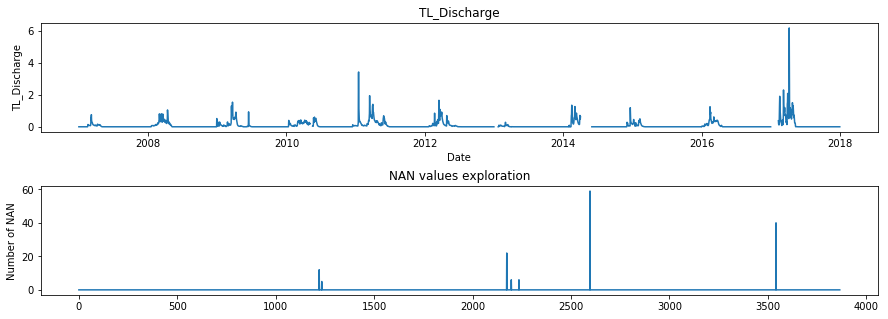

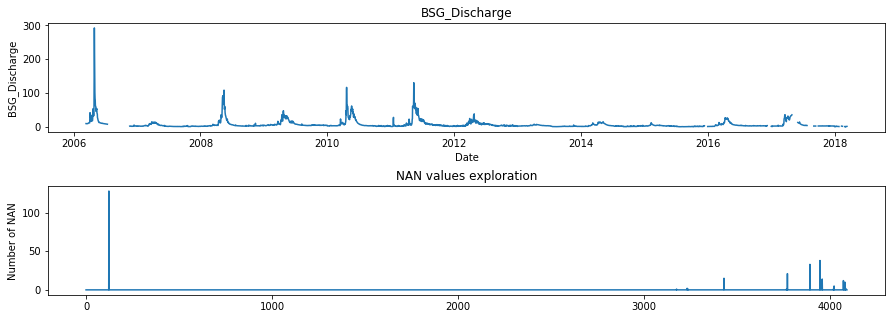

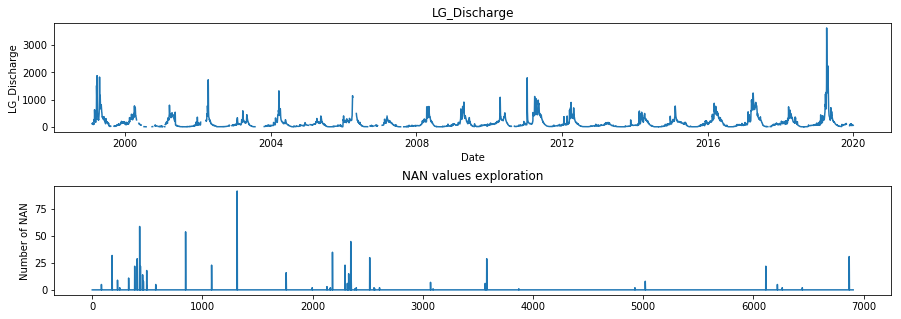

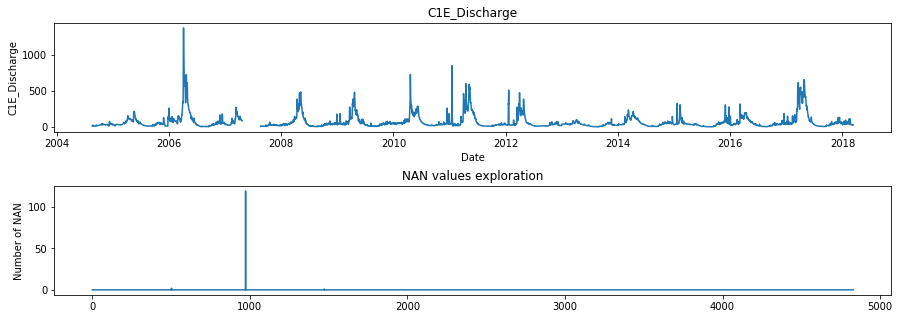

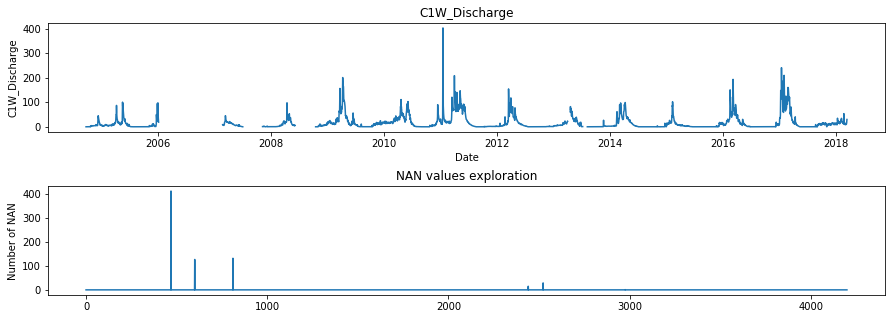

...

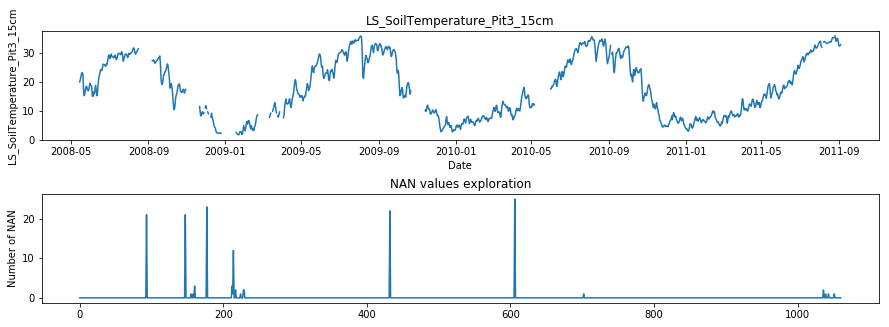

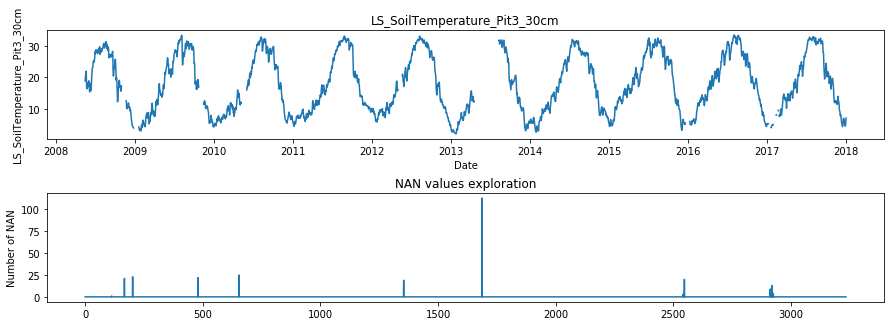

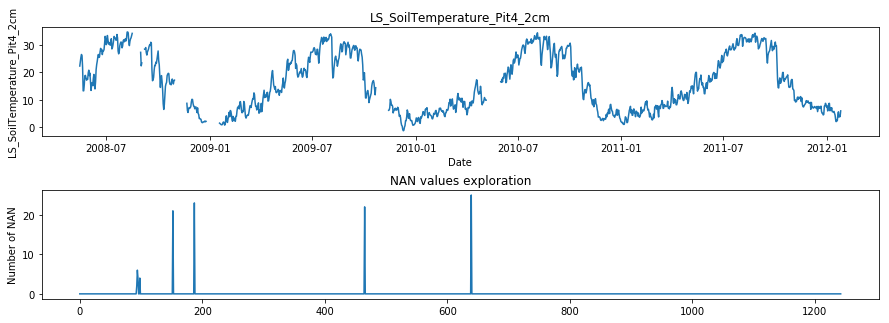

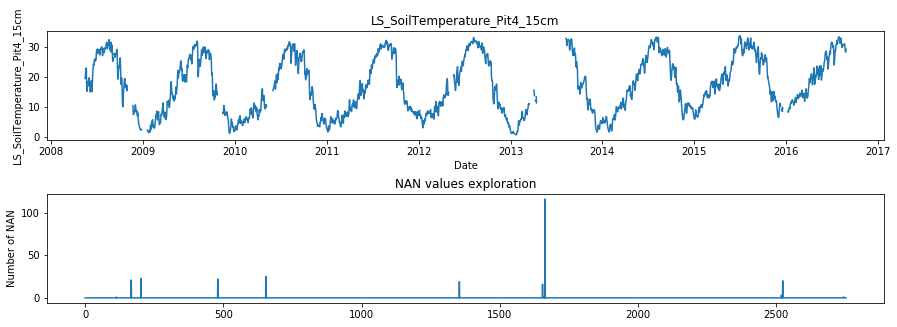

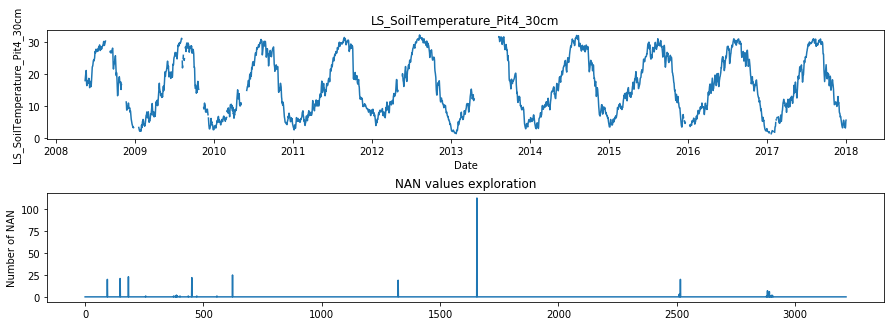

In [11]:
# =====================================
# First data exploration with plots.
# Check the number of Missing values.
# Do interpolation on the missing values positions

# table 2 will be used to be updated with interpolated values
table2 = copy.deepcopy(table1) 

# a dictionary that store data record for each column
y1 = {} 

# a flag table that store indicators
indexUnique = table2.index
ready_columns = pd.unique(table2.columns)  
flag_table2 = pd.DataFrame(np.nan * np.ones([len(indexUnique),len(ready_columns)]),
                 index = indexUnique, columns = ready_columns) 


for i in np.arange(var_number): # column of variable being processed 
    VarName = table2.columns[i]
    y1[i] = table2[VarName].copy(deep = True)
    ind = np.where(~np.isnan(y1[i].to_numpy())) # index where the value of y1 is not NaN
    
    flag_table2[VarName][ind[0]] = int(1) # set indicator 1 to original data positions
    missing_index = list( set(range(ind[0][0],ind[0][-1] + 1)) - set(ind[0]) )
    flag_table2[VarName][missing_index] = int(0) # set indicator 0 to missing data positions
    
    start = ind[0][0]
    end = ind[0][-1]
    y1[i] = y1[i][start:end + 1] # trim y1
    
    
    # Print out whether the column contain missing values
    dim = np.shape(ind)[1] # number of non nan data points 
    if (dim != len(y1[i])): # if non nan data points equal the whole data record length
        print(" ")
        print(i,VarName, ": There are missing data!")

        #===========================
        # For those columns that contain missing values:Plot the data and indicate nan values position and length
        fig1 = plt.figure(figsize=[15,5])
        sp1, sp2 = fig1.add_subplot(211), fig1.add_subplot(212)
        sp1.plot(y1[i])
        sp1.set_title(table2.columns[i])
        sp1.set_xlabel('Date')
        sp1.set_ylabel(table2.columns[i])
    
        index = np.argwhere(~np.isnan(y1[i].to_numpy())) # An array of index that the value is not nan (where data exist)
        lenNAN = (np.diff(index,axis=0)) - 1 # An array that indicate the NAN value number along data record

        pd.DataFrame(lenNAN)
        sp2.plot(lenNAN)
        sp2.set_title("NAN values exploration")
        sp2.set_ylabel('Number of NAN')
        plt.subplots_adjust(hspace=0.5)

        #===========================
        # For those columns that contain missing values: Do Interpolation 
        y2, nanR, whereINT = interpolateQC(pd.DataFrame(y1[i]),inteplimit = 7,name = VarName) # maximum interpolation length is 7 days
        # Update table 3 with interpolated values
        table2.loc[:,VarName] = y2[0] 
        
        # Update flag table with interpolation indicators 2
        flag_table2[VarName][np.reshape(whereINT[0], whereINT[0].shape[0]) + start] = int(2) 
        
        # Check if the value is out of original threshold, don't forget to change flag table as well
        outvalues(table, table2, flag_table2, VarName)

     # else: # if not
        #print(VarName, ": No missing data.")       

### Store the data table and the flag table after interpolation

In [12]:
flag_table2.head(2)

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
table2.to_csv('2_' + watershed + '_Interpolation.csv', sep=',')
flag_table2.to_csv('2_' + watershed + '_Interpolation_Flag.csv', sep=',')
all(table2.columns == flag_table2.columns)

True

# 3. Data filling method: Regression (across stations)

In [14]:
# Some functions to be used
def fromEveryStationPoolAvariable(stnMet,var_nm,ind,allMet,mm):
    for k in np.arange(len(stnMet)): # read the station table
        tabReg2 = allMet[k]
        pp = pd.DataFrame(index=ind) # for a single station multiple variable DF                
        for m in np.arange(len(tabReg2.columns)): # identify the variable from each staion table[ columns of a table]
            nn = pd.DataFrame(index=ind)     
            if str.find(tabReg2.columns[m],var_nm) != -1: # the variable does exist in the column of a table
                a = pd.Series(list(set(nn.index) & set(tabReg2.index)))
                if len(a)!=0:
                    nn.loc[a,tabReg2.columns[m]] = tabReg2.loc[a,tabReg2.columns[m]]                 
                    pp[str(tabReg2.columns[m])] = nn # all the same variables from a single table
        if len(mm.index) == len(pp.index):        
            mm = pd.concat([mm, pp], axis=1)#,join_axes = [mm.index]) # single variable from multiple table indexed based on station i
        else:
            print('Warning: The indexes are different!')
    return mm


def regressionAtStationForAvariable(mm,stnName,var_nm): #stnName = stnMet[i]
    nameTab = pd.Series(mm.columns)
    n_Tab = nameTab.apply(lambda x: x.split('_'))[:]
    stnofInterest = n_Tab.apply(lambda x: x[0] == stnName) # station name is at the beigning
    colInt = np.argwhere(stnofInterest.to_numpy() == 1)  
    mesName = mm.columns # All station single variable    
    
    for col in colInt:
        p = np.delete(np.arange(len(mesName)), col)
        tt = mm.iloc[:,np.r_[col,p]]
        regR = regressorFunc(tt,regThres=0.7)
        # return ind_interp
        # location where Regression happened
        ind_interp = np.argwhere(regR.reshape(len(regR)) != mm.iloc[:,col].to_numpy())
        # plot 
        plt.figure(figsize=[5,1])
        plt.plot(regR,color='black',label= var_nm+' After regression')
        plt.plot(np.array(mm.iloc[:,col]), color='red', label='Raw data')        
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
        plt.title(mm.columns[col])    
        # Update the variable table
        mm.iloc[:,col] = regR
    return mm

### Do regression across all stations

In [15]:
# table3 will be updated with regression values
table3 = copy.deepcopy(table2)
flag_table3 = copy.deepcopy(flag_table2)

In [16]:
# Store tables into a dictionary seperated by stations
stn_table_dic = {}
col_names = pd.Series(table3.columns)
n_tab = col_names.apply(lambda x: x.split('_'))[:]
var_names = n_tab.apply(lambda x: x[1]).unique()
stn_names = n_tab.apply(lambda x: x[0]).unique()
print('var_names:',var_names)

for i in range(len(stn_names)): # column of variable being processed
    station = stn_names[i] 
    #print(station)
    station_lst = []
    for col in col_names:
        if col.split('_')[0] == station:
            station_lst.append(col)
    #print(station_lst)
    stn_table_dic[i] = copy.deepcopy(table3[station_lst])
    
# check if the results of all station have been stored
len(stn_table_dic.keys()) == len(stn_names)

var_names: ['Discharge' 'Precipitation' 'AirTemperature' 'SolarRadiation'
 'RelativeHumidity' 'WindDirection' 'WindSpeed' 'SnowDepth' 'SoilMoisture'
 'SoilTemperature']


True

Finishing regression on Station TL Discharge
Finishing regression on Station TL Precipitation
Finishing regression on Station TL AirTemperature
Finishing regression on Station TL SolarRadiation
Finishing regression on Station TL RelativeHumidity
Finishing regression on Station TL WindDirection
Finishing regression on Station TL WindSpeed
Finishing regression on Station TL SnowDepth
Finishing regression on Station TL SoilMoisture
Finishing regression on Station TL SoilTemperature
Finishing regression on Station BSG Discharge
Finishing regression on Station LG Discharge
Finishing regression on Station C1E Discharge
Finishing regression on Station C1W Discharge
Finishing regression on Station C2E Discharge
Finishing regression on Station C2M Discharge
Finishing regression on Station BRW Precipitation
Finishing regression on Station BRW AirTemperature
Finishing regression on Station BRW SolarRadiation
Finishing regression on Station BRW RelativeHumidity
Finishing regression on Station BRW 

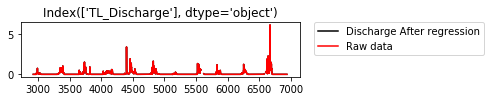

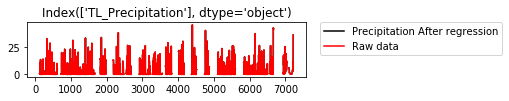

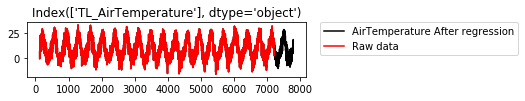

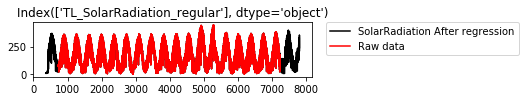

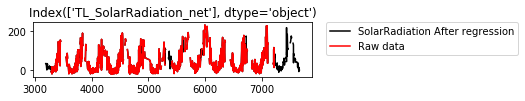

...

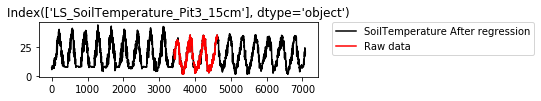

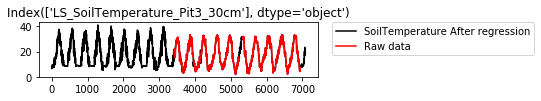

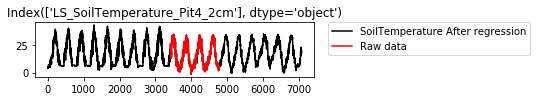

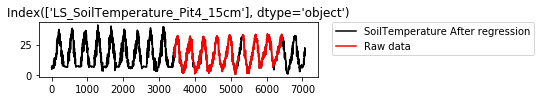

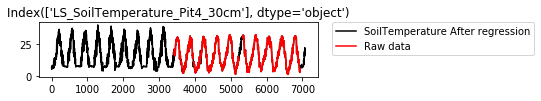

In [17]:
%%time
for i in range(len(stn_names)): # Each met station
    table_reg = stn_table_dic[i]  # extract the table for station i from the dictionary
    
    for j in range(len(var_names)): # loop across variables, not looping for discharge
        var = var_names[j]
        mm = pd.DataFrame(index = table_reg.index) # table for a single variable at a single station
        
        # Fill single variable from multiple stations
        mm = fromEveryStationPoolAvariable(stn_names, var, table_reg.index, stn_table_dic, mm)
        
        # Do regression across stations for met station i, variable j
        result = regressionAtStationForAvariable(mm, stn_names[i], var)
        intersectTable = pd.Series(list(set(result.columns) & set(table_reg.columns)),dtype='object') # column where regression is done
        
        # Update table3 with regression results
        if len(intersectTable) != 0:  
            print('Finishing regression on Station', stn_names[i], var) 
            for k in np.arange(len(intersectTable)):
                table3[intersectTable[k]] = (np.array(result[intersectTable[k]]))    
                

In [18]:
# Write indicators of regression into flag table
for j in range(len(col_names)):
    col = col_names[j]
    for m in table3[col].index:  
        if str(table2[col][m]) == 'nan':
            if str(table3[col][m])!= 'nan':
                flag_table3[col][m] = int(3)

In [19]:
# Check the regression values and delete out of range values
for col in col_names:
    outvalues(table, table3, flag_table3, col)

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
C1E_Discharge More than maximum, value 1752.6190576321058 > 1380.2654166666666 index =  7403
No filled values are out of original data range
C2E_Discharge Less than minimum, value -0.3294767828103774 < 0 index =  3138
C2E_Discharge Less than minimum, value -0.30356044284610306 < 0 index =  3139
C2E_Discharge Less than minimum, value -0.06401941489059632 < 0 index =  3140
C2E_Discharge Less than minimum, value -0.3943910438637502 < 0 index =  3148
C2E_Discharge Less than minimum, value -0.1876773798629909 < 0 index =  3151
C2E_Discharge Less than minimum, value -0.41549434926323064 < 0 index =  3152
C2E_Discharge Less than minimum, value -0.33762191822772075 < 0 index =  3153
C2E_Discharge Less than minimum, value -0.33614098451547647 < 0 index =  3157
C2E_Discharge Less than minimum, value -0.4159879938339787 < 0 index =  3158
C2E_Discharge Les

BRW_RelativeHumidity More than maximum, value 100.17669476524891 > 100.0 index =  2491
BRW_RelativeHumidity More than maximum, value 101.40687675703572 > 100.0 index =  2573
BRW_RelativeHumidity More than maximum, value 101.71338674825535 > 100.0 index =  2644
BRW_RelativeHumidity More than maximum, value 100.17669476524887 > 100.0 index =  2887
BRW_RelativeHumidity More than maximum, value 101.57034687979797 > 100.0 index =  3213
BRW_RelativeHumidity More than maximum, value 100.17263309728335 > 100.0 index =  3324
BRW_RelativeHumidity More than maximum, value 101.93147081656038 > 100.0 index =  3364
BRW_RelativeHumidity More than maximum, value 102.89747734739986 > 100.0 index =  3600
BRW_RelativeHumidity More than maximum, value 101.53874853533122 > 100.0 index =  3620
BRW_RelativeHumidity More than maximum, value 101.97661130865569 > 100.0 index =  3624
BRW_RelativeHumidity More than maximum, value 102.55892365668507 > 100.0 index =  3649
BRW_RelativeHumidity More than maximum, val

SCR_SnowDepth More than maximum, value 1144.2558866390796 > 862.1249999999999 index =  1869
SCR_SnowDepth More than maximum, value 1153.9668308552436 > 862.1249999999999 index =  1870
SCR_SnowDepth More than maximum, value 1214.6413263368604 > 862.1249999999999 index =  1871
SCR_SnowDepth More than maximum, value 1185.121479420477 > 862.1249999999999 index =  1872
SCR_SnowDepth More than maximum, value 1089.742480364694 > 862.1249999999999 index =  1873
SCR_SnowDepth More than maximum, value 972.0367616474693 > 862.1249999999999 index =  1874
SCR_SnowDepth More than maximum, value 938.3131390626137 > 862.1249999999999 index =  1875
SCR_SnowDepth More than maximum, value 920.1434864511057 > 862.1249999999999 index =  1876
SCR_SnowDepth More than maximum, value 904.4493906221423 > 862.1249999999999 index =  1877
SCR_SnowDepth More than maximum, value 902.2590900456725 > 862.1249999999999 index =  1878
SCR_SnowDepth More than maximum, value 900.0687894692026 > 862.1249999999999 index =  1

SCR_SnowDepth More than maximum, value 1122.1582616304695 > 862.1249999999999 index =  3366
SCR_SnowDepth More than maximum, value 1112.1626172632132 > 862.1249999999999 index =  3367
SCR_SnowDepth More than maximum, value 1097.1691507123287 > 862.1249999999999 index =  3368
SCR_SnowDepth More than maximum, value 1092.871957806779 > 862.1249999999999 index =  3369
SCR_SnowDepth More than maximum, value 1066.3414624768648 > 862.1249999999999 index =  3370
SCR_SnowDepth More than maximum, value 1031.8237933768532 > 862.1249999999999 index =  3371
SCR_SnowDepth More than maximum, value 1085.4219331498753 > 862.1249999999999 index =  3372
SCR_SnowDepth More than maximum, value 1139.0200729228973 > 862.1249999999999 index =  3373
SCR_SnowDepth More than maximum, value 1103.848483163346 > 862.1249999999999 index =  3374
SCR_SnowDepth More than maximum, value 1183.0026066340456 > 862.1249999999999 index =  3375
SCR_SnowDepth More than maximum, value 1157.057722916797 > 862.1249999999999 index

SCR_SnowDepth More than maximum, value 1133.850177299153 > 862.1249999999999 index =  7546
SCR_SnowDepth More than maximum, value 1160.3611740739366 > 862.1249999999999 index =  7547
SCR_SnowDepth More than maximum, value 1168.5115142986167 > 862.1249999999999 index =  7548
SCR_SnowDepth More than maximum, value 1157.2861372858704 > 862.1249999999999 index =  7549
SCR_SnowDepth More than maximum, value 1180.6922425464904 > 862.1249999999999 index =  7550
SCR_SnowDepth More than maximum, value 1175.348246574997 > 862.1249999999999 index =  7551
SCR_SnowDepth More than maximum, value 1173.019577939374 > 862.1249999999999 index =  7552
SCR_SnowDepth More than maximum, value 1099.9352084521324 > 862.1249999999999 index =  7553
SCR_SnowDepth More than maximum, value 1111.638261082442 > 862.1249999999999 index =  7554
SCR_SnowDepth More than maximum, value 1112.9220143046446 > 862.1249999999999 index =  7555
SCR_SnowDepth More than maximum, value 1094.5016483023458 > 862.1249999999999 index 

BRW_SoilMoisture_U_5cm Less than minimum, value -0.01175703445903542 < 0 index =  4971
BRW_SoilMoisture_U_5cm Less than minimum, value -0.01364622842313068 < 0 index =  4972
BRW_SoilMoisture_U_5cm Less than minimum, value -0.06654365941777884 < 0 index =  4973
BRW_SoilMoisture_U_5cm Less than minimum, value -0.0457625258127381 < 0 index =  4974
BRW_SoilMoisture_U_5cm Less than minimum, value -0.07598962923825114 < 0 index =  4975
BRW_SoilMoisture_U_5cm Less than minimum, value -0.06843285338187322 < 0 index =  4976
BRW_SoilMoisture_U_5cm Less than minimum, value -0.14211141798156257 < 0 index =  4977
BRW_SoilMoisture_U_5cm Less than minimum, value -0.13644383608927813 < 0 index =  4978
BRW_SoilMoisture_U_5cm Less than minimum, value -0.16289255158660199 < 0 index =  4979
BRW_SoilMoisture_U_5cm Less than minimum, value -0.19123046104802066 < 0 index =  4980
BRW_SoilMoisture_U_5cm Less than minimum, value -0.19123046104802066 < 0 index =  4981
BRW_SoilMoisture_U_5cm Less than minimum, va

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
SCR_SoilMoisture_5cm More than maximum, value 22.788062332436002 > 22.4625 index =  20
SCR_SoilMoisture_5cm More than maximum, value 22.825336185284883 > 22.4625 index =  22
No filled values are out of original data range
No filled values are out of original data range
TL_SoilMoisture_P3_30cm More than maximum, value 80.19438369665897 > 75.31739130434781 index =  5853
TL_SoilMoisture_P3_30cm Less than minimum, value -0.4363880728292333 < 0 index =  6102
TL_SoilMoisture_P3_30cm Less than minimum, value -0.28339777427333157 < 0 index =  6103
TL_SoilMoisture_P3_30cm Less than minimum, value -0.13040747571742894 < 0 index =  6104
TL_SoilMoisture_P3_30cm Less than minimum, value -0.1767969677132042 < 0 index =  6135
TL_SoilMoisture_P3_30cm Less than minim

HN_SoilMoisture_Pit1_15cm More than maximum, value 41.54726618139969 > 39.97500000000001 index =  1875
HN_SoilMoisture_Pit1_15cm More than maximum, value 40.493977348996495 > 39.97500000000001 index =  1876
HN_SoilMoisture_Pit1_15cm More than maximum, value 42.0035035900877 > 39.97500000000001 index =  1877
HN_SoilMoisture_Pit1_15cm More than maximum, value 41.62562503917363 > 39.97500000000001 index =  1878
HN_SoilMoisture_Pit1_15cm More than maximum, value 41.24774648825955 > 39.97500000000001 index =  1879
HN_SoilMoisture_Pit1_15cm More than maximum, value 40.869867937345475 > 39.97500000000001 index =  1880
HN_SoilMoisture_Pit1_15cm More than maximum, value 40.49198938643141 > 39.97500000000001 index =  1881
HN_SoilMoisture_Pit1_15cm More than maximum, value 40.11411083551734 > 39.97500000000001 index =  1882
HN_SoilMoisture_Pit1_30cm More than maximum, value 35.57947063868724 > 34.112500000000004 index =  3405
HN_SoilMoisture_Pit1_30cm More than maximum, value 34.574572235583645 >

HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4534
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4535
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4536
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4537
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4538
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4539
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4540
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4541
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4542
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4543
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4544
HN_SoilMoisture_Pit1_

HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4679
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4731
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4732
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4733
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4734
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4735
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4736
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4737
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4738
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4739
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4740
HN_SoilMoisture_Pit1_

HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4897
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4898
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4899
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4900
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4901
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4902
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4903
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4904
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4905
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4906
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  4907
HN_SoilMoisture_Pit1_

HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5050
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5051
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5052
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5053
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5054
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5055
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5056
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5057
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5058
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5059
HN_SoilMoisture_Pit1_30cm Less than minimum, value -0.9719715721916184 < 0 index =  5060
HN_SoilMoisture_Pit1_

HN_SoilMoisture_Pit1_37cmBdrk More than maximum, value 30.86235921279745 > 30.116666666666664 index =  3455
HN_SoilMoisture_Pit1_37cmBdrk More than maximum, value 30.705290323524647 > 30.116666666666664 index =  3456
No filled values are out of original data range
HN_SoilMoisture_Pit2_15cm More than maximum, value 40.850567981276924 > 39.141666666666666 index =  1874
HN_SoilMoisture_Pit2_15cm More than maximum, value 47.21122675601086 > 39.141666666666666 index =  1875
HN_SoilMoisture_Pit2_15cm More than maximum, value 46.06587943692058 > 39.141666666666666 index =  1876
HN_SoilMoisture_Pit2_15cm More than maximum, value 47.707339765884186 > 39.141666666666666 index =  1877
HN_SoilMoisture_Pit2_15cm More than maximum, value 47.29643425552794 > 39.141666666666666 index =  1878
HN_SoilMoisture_Pit2_15cm More than maximum, value 46.88552874517171 > 39.141666666666666 index =  1879
HN_SoilMoisture_Pit2_15cm More than maximum, value 46.47462323481548 > 39.141666666666666 index =  1880
HN_So

HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 31.520288514653892 > 27.5375 index =  1875
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 30.743104846405245 > 27.5375 index =  1876
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 31.85692956881506 > 27.5375 index =  1877
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 31.57810667682464 > 27.5375 index =  1878
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 31.299283784834202 > 27.5375 index =  1879
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 31.020460892843772 > 27.5375 index =  1880
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 30.741638000853357 > 27.5375 index =  1881
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 30.46281510886292 > 27.5375 index =  1882
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 30.18399221687249 > 27.5375 index =  1883
HN_SoilMoisture_Pit3_54cmBdrk More than maximum, value 29.90516932488206 > 27.5375 index =  1884
HN_SoilMoisture_Pit3_54cm

HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 32.05180069415269 > 30.659090909090914 index =  1875
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 31.2493736684494 > 30.659090909090914 index =  1876
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 32.399376036837 > 30.659090909090914 index =  1877
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 32.111496822362454 > 30.659090909090914 index =  1878
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 31.823617607887893 > 30.659090909090914 index =  1879
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 31.535738393413343 > 30.659090909090914 index =  1880
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 31.247859178938803 > 30.659090909090914 index =  1881
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 30.959979964464246 > 30.659090909090914 index =  1882
HN_SoilMoisture_Pit4_45cmBdrk More than maximum, value 30.672100749989696 > 30.659090909090914 index =  1883
HN_SoilMoisture_Pit4_45cm

HS_SoilMoisture_Pit1_2cm More than maximum, value 389.6058632119885 > 37.7 index =  291
HS_SoilMoisture_Pit1_2cm More than maximum, value 389.49698161031466 > 37.7 index =  292
HS_SoilMoisture_Pit1_2cm More than maximum, value 390.04138961868375 > 37.7 index =  293
HS_SoilMoisture_Pit1_2cm More than maximum, value 389.9325080170099 > 37.7 index =  294
HS_SoilMoisture_Pit1_2cm More than maximum, value 390.80356083040044 > 37.7 index =  295
HS_SoilMoisture_Pit1_2cm More than maximum, value 390.2591528220314 > 37.7 index =  296
HS_SoilMoisture_Pit1_2cm More than maximum, value 390.04138961868375 > 37.7 index =  297
HS_SoilMoisture_Pit1_2cm More than maximum, value 390.2591528220314 > 37.7 index =  298
HS_SoilMoisture_Pit1_2cm More than maximum, value 389.9325080170099 > 37.7 index =  299
HS_SoilMoisture_Pit1_2cm More than maximum, value 388.7348103985979 > 37.7 index =  300
HS_SoilMoisture_Pit1_2cm More than maximum, value 388.1904023902289 > 37.7 index =  301
HS_SoilMoisture_Pit1_2cm Mor

HS_SoilMoisture_Pit1_2cm Less than minimum, value -0.9524419919899856 < 0 index =  475
HS_SoilMoisture_Pit1_2cm Less than minimum, value -5.960995668985561 < 0 index =  476
HS_SoilMoisture_Pit1_2cm More than maximum, value 41.71099893053372 > 37.7 index =  485
HS_SoilMoisture_Pit1_2cm More than maximum, value 46.16607113235398 > 37.7 index =  486
HS_SoilMoisture_Pit1_2cm More than maximum, value 50.621143334174235 > 37.7 index =  487
HS_SoilMoisture_Pit1_2cm More than maximum, value 55.07621553599455 > 37.7 index =  488
HS_SoilMoisture_Pit1_2cm More than maximum, value 59.53128773781481 > 37.7 index =  489
HS_SoilMoisture_Pit1_2cm More than maximum, value 63.98635993963518 > 37.7 index =  490
HS_SoilMoisture_Pit1_2cm More than maximum, value 68.4414321414555 > 37.7 index =  491
HS_SoilMoisture_Pit1_2cm More than maximum, value 72.89650434327575 > 37.7 index =  492
HS_SoilMoisture_Pit1_2cm More than maximum, value 77.35157654509612 > 37.7 index =  493
HS_SoilMoisture_Pit1_2cm More than 

HS_SoilMoisture_Pit1_2cm More than maximum, value 382.6374407048642 > 37.7 index =  630
HS_SoilMoisture_Pit1_2cm More than maximum, value 383.61737511992857 > 37.7 index =  631
HS_SoilMoisture_Pit1_2cm More than maximum, value 384.0529015266238 > 37.7 index =  632
HS_SoilMoisture_Pit1_2cm More than maximum, value 385.6861255517311 > 37.7 index =  633
HS_SoilMoisture_Pit1_2cm More than maximum, value 387.21046797516453 > 37.7 index =  634
HS_SoilMoisture_Pit1_2cm More than maximum, value 387.21046797516453 > 37.7 index =  635
HS_SoilMoisture_Pit1_2cm More than maximum, value 386.88382317014305 > 37.7 index =  636
HS_SoilMoisture_Pit1_2cm More than maximum, value 386.55717836512156 > 37.7 index =  637
HS_SoilMoisture_Pit1_2cm More than maximum, value 386.12165195842636 > 37.7 index =  638
HS_SoilMoisture_Pit1_2cm More than maximum, value 385.57724395005727 > 37.7 index =  639
HS_SoilMoisture_Pit1_2cm More than maximum, value 385.6861255517311 > 37.7 index =  640
HS_SoilMoisture_Pit1_2cm 

HS_SoilMoisture_Pit1_2cm More than maximum, value 343.22230089894276 > 37.7 index =  898
HS_SoilMoisture_Pit1_2cm More than maximum, value 345.6176961357668 > 37.7 index =  899
HS_SoilMoisture_Pit1_2cm More than maximum, value 347.795328169243 > 37.7 index =  900
HS_SoilMoisture_Pit1_2cm More than maximum, value 350.0818418043932 > 37.7 index =  901
HS_SoilMoisture_Pit1_2cm More than maximum, value 352.69500024456477 > 37.7 index =  902
HS_SoilMoisture_Pit1_2cm More than maximum, value 355.41704028641016 > 37.7 index =  903
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.81243552323417 > 37.7 index =  904
HS_SoilMoisture_Pit1_2cm More than maximum, value 359.8811859550366 > 37.7 index =  905
HS_SoilMoisture_Pit1_2cm More than maximum, value 361.1877651751224 > 37.7 index =  906
HS_SoilMoisture_Pit1_2cm More than maximum, value 362.05881798851294 > 37.7 index =  907
HS_SoilMoisture_Pit1_2cm More than maximum, value 362.05881798851294 > 37.7 index =  908
HS_SoilMoisture_Pit1_2cm Mo

HS_SoilMoisture_Pit1_2cm More than maximum, value 358.57460673495086 > 37.7 index =  1050
HS_SoilMoisture_Pit1_2cm More than maximum, value 358.03019872658183 > 37.7 index =  1051
HS_SoilMoisture_Pit1_2cm More than maximum, value 356.83250110816977 > 37.7 index =  1052
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.70355392156034 > 37.7 index =  1053
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.5865808823446 > 37.7 index =  1054
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.4696078431289 > 37.7 index =  1055
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.35263480391325 > 37.7 index =  1056
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.23566176469757 > 37.7 index =  1057
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.1186887254819 > 37.7 index =  1058
HS_SoilMoisture_Pit1_2cm More than maximum, value 357.0017156862662 > 37.7 index =  1059
HS_SoilMoisture_Pit1_2cm More than maximum, value 356.88474264705053 > 37.7 index =  1060
HS_SoilMoistur

HS_SoilMoisture_Pit1_15cm More than maximum, value 321.4820253179903 > 32.43333333333334 index =  178
HS_SoilMoisture_Pit1_15cm More than maximum, value 327.16328750446104 > 32.43333333333334 index =  179
HS_SoilMoisture_Pit1_15cm More than maximum, value 330.8078707938951 > 32.43333333333334 index =  180
HS_SoilMoisture_Pit1_15cm More than maximum, value 334.7740349618087 > 32.43333333333334 index =  181
HS_SoilMoisture_Pit1_15cm More than maximum, value 338.3114246250829 > 32.43333333333334 index =  182
HS_SoilMoisture_Pit1_15cm More than maximum, value 341.42003978371775 > 32.43333333333334 index =  183
HS_SoilMoisture_Pit1_15cm More than maximum, value 344.0998804377134 > 32.43333333333334 index =  184
HS_SoilMoisture_Pit1_15cm More than maximum, value 346.2437529609099 > 32.43333333333334 index =  185
HS_SoilMoisture_Pit1_15cm More than maximum, value 348.8163999887457 > 32.43333333333334 index =  186
HS_SoilMoisture_Pit1_15cm More than maximum, value 351.92501514738063 > 32.43333

HS_SoilMoisture_Pit1_15cm More than maximum, value 39.66998214380972 > 32.43333333333334 index =  335
HS_SoilMoisture_Pit1_15cm More than maximum, value 43.10017818092392 > 32.43333333333334 index =  336
HS_SoilMoisture_Pit1_15cm More than maximum, value 43.63614631172311 > 32.43333333333334 index =  337
HS_SoilMoisture_Pit1_15cm More than maximum, value 46.95914872267771 > 32.43333333333334 index =  338
HS_SoilMoisture_Pit1_15cm More than maximum, value 48.459859488915214 > 32.43333333333334 index =  339
HS_SoilMoisture_Pit1_15cm More than maximum, value 47.280729601157105 > 32.43333333333334 index =  340
HS_SoilMoisture_Pit1_15cm More than maximum, value 45.24405070412047 > 32.43333333333334 index =  341
HS_SoilMoisture_Pit1_15cm More than maximum, value 44.386501694841755 > 32.43333333333334 index =  342
HS_SoilMoisture_Pit1_15cm More than maximum, value 42.13543554548555 > 32.43333333333334 index =  343
HS_SoilMoisture_Pit1_15cm More than maximum, value 39.02682038685052 > 32.43333

HS_SoilMoisture_Pit1_15cm More than maximum, value 315.80076313151955 > 32.43333333333334 index =  533
HS_SoilMoisture_Pit1_15cm More than maximum, value 320.62447630871173 > 32.43333333333334 index =  534
HS_SoilMoisture_Pit1_15cm More than maximum, value 324.9122213551047 > 32.43333333333334 index =  535
HS_SoilMoisture_Pit1_15cm More than maximum, value 328.7711918968584 > 32.43333333333334 index =  536
HS_SoilMoisture_Pit1_15cm More than maximum, value 333.3805178217309 > 32.43333333333334 index =  537
HS_SoilMoisture_Pit1_15cm More than maximum, value 338.6330055035623 > 32.43333333333334 index =  538
HS_SoilMoisture_Pit1_15cm More than maximum, value 343.02794417611517 > 32.43333333333334 index =  539
HS_SoilMoisture_Pit1_15cm More than maximum, value 346.45814021322957 > 32.43333333333334 index =  540
HS_SoilMoisture_Pit1_15cm More than maximum, value 349.5667553718645 > 32.43333333333334 index =  541
HS_SoilMoisture_Pit1_15cm More than maximum, value 352.88975778281906 > 32.433

HS_SoilMoisture_Pit1_15cm More than maximum, value 42.56421005012484 > 32.43333333333334 index =  695
HS_SoilMoisture_Pit1_15cm More than maximum, value 43.63614631172311 > 32.43333333333334 index =  696
HS_SoilMoisture_Pit1_15cm More than maximum, value 41.385080162366904 > 32.43333333333334 index =  697
HS_SoilMoisture_Pit1_15cm More than maximum, value 36.34697973285496 > 32.43333333333334 index =  698
HS_SoilMoisture_Pit1_15cm More than maximum, value 33.881526331179074 > 32.43333333333334 index =  699
HS_SoilMoisture_Pit1_15cm Less than minimum, value -15.641928954660301 < 0 index =  795
HS_SoilMoisture_Pit1_15cm Less than minimum, value -35.68713704654769 < 0 index =  796
HS_SoilMoisture_Pit1_15cm Less than minimum, value -52.194955475160654 < 0 index =  797
HS_SoilMoisture_Pit1_15cm Less than minimum, value -77.9214257535188 < 0 index =  798
HS_SoilMoisture_Pit1_15cm Less than minimum, value -62.056769081864644 < 0 index =  799
HS_SoilMoisture_Pit1_15cm Less than minimum, value 

HS_SoilMoisture_Pit1_15cm More than maximum, value 371.1126742299894 > 32.43333333333334 index =  923
HS_SoilMoisture_Pit1_15cm More than maximum, value 371.1126742299894 > 32.43333333333334 index =  924
HS_SoilMoisture_Pit1_15cm More than maximum, value 372.18461049158765 > 32.43333333333334 index =  925
HS_SoilMoisture_Pit1_15cm More than maximum, value 372.3989977439073 > 32.43333333333334 index =  926
HS_SoilMoisture_Pit1_15cm More than maximum, value 371.9702232392681 > 32.43333333333334 index =  927
HS_SoilMoisture_Pit1_15cm More than maximum, value 372.7205786223868 > 32.43333333333334 index =  928
HS_SoilMoisture_Pit1_15cm More than maximum, value 374.2212893886243 > 32.43333333333334 index =  929
HS_SoilMoisture_Pit1_15cm More than maximum, value 374.54287026710375 > 32.43333333333334 index =  930
HS_SoilMoisture_Pit1_15cm More than maximum, value 374.6500638932637 > 32.43333333333334 index =  931
HS_SoilMoisture_Pit1_15cm More than maximum, value 374.7572575194235 > 32.433333

HS_SoilMoisture_Pit1_15cm More than maximum, value 353.5010555510921 > 32.43333333333334 index =  1057
HS_SoilMoisture_Pit1_15cm More than maximum, value 353.3858959277609 > 32.43333333333334 index =  1058
HS_SoilMoisture_Pit1_15cm More than maximum, value 353.2707363044296 > 32.43333333333334 index =  1059
HS_SoilMoisture_Pit1_15cm More than maximum, value 353.1555766810983 > 32.43333333333334 index =  1060
HS_SoilMoisture_Pit1_15cm More than maximum, value 32.801786420673764 > 32.43333333333334 index =  4161
HS_SoilMoisture_Pit1_30cm Less than minimum, value -63.4799509473742 < 0 index =  126
HS_SoilMoisture_Pit1_30cm Less than minimum, value -41.76966897771561 < 0 index =  127
HS_SoilMoisture_Pit1_30cm Less than minimum, value -26.779236189141926 < 0 index =  128
HS_SoilMoisture_Pit1_30cm Less than minimum, value -17.388677718138933 < 0 index =  129
HS_SoilMoisture_Pit1_30cm Less than minimum, value -11.185740012522169 < 0 index =  130
HS_SoilMoisture_Pit1_30cm Less than minimum, va

HS_SoilMoisture_Pit1_30cm More than maximum, value 303.4410447223713 > 29.29583333333333 index =  237
HS_SoilMoisture_Pit1_30cm More than maximum, value 303.6133485475274 > 29.29583333333333 index =  238
HS_SoilMoisture_Pit1_30cm More than maximum, value 303.78565237268344 > 29.29583333333333 index =  239
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.4748676733074 > 29.29583333333333 index =  240
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.7333234110415 > 29.29583333333333 index =  241
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.7333234110415 > 29.29583333333333 index =  242
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.8194753236195 > 29.29583333333333 index =  243
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.16408297393156 > 29.29583333333333 index =  244
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.16408297393156 > 29.29583333333333 index =  245
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.42253871166554 > 29.2958

HS_SoilMoisture_Pit1_30cm More than maximum, value 34.47477365382339 > 29.29583333333333 index =  378
HS_SoilMoisture_Pit1_30cm Less than minimum, value -0.41675094027076554 < 0 index =  387
HS_SoilMoisture_Pit1_30cm Less than minimum, value -2.312093016986949 < 0 index =  390
HS_SoilMoisture_Pit1_30cm Less than minimum, value -2.48439684214299 < 0 index =  391
HS_SoilMoisture_Pit1_30cm Less than minimum, value -3.345915967923106 < 0 index =  403
HS_SoilMoisture_Pit1_30cm Less than minimum, value -24.625438374691587 < 0 index =  404
HS_SoilMoisture_Pit1_30cm Less than minimum, value -31.000679905464484 < 0 index =  405
HS_SoilMoisture_Pit1_30cm Less than minimum, value -38.06513673686136 < 0 index =  406
HS_SoilMoisture_Pit1_30cm Less than minimum, value -30.56992034257438 < 0 index =  407
HS_SoilMoisture_Pit1_30cm Less than minimum, value -23.247007773443524 < 0 index =  408
HS_SoilMoisture_Pit1_30cm Less than minimum, value -29.88070504195021 < 0 index =  409
HS_SoilMoisture_Pit1_30c

HS_SoilMoisture_Pit1_30cm More than maximum, value 308.35170373931794 > 29.29583333333333 index =  619
HS_SoilMoisture_Pit1_30cm More than maximum, value 307.2317288758038 > 29.29583333333333 index =  620
HS_SoilMoisture_Pit1_30cm More than maximum, value 306.80096931291376 > 29.29583333333333 index =  621
HS_SoilMoisture_Pit1_30cm More than maximum, value 306.80096931291376 > 29.29583333333333 index =  622
HS_SoilMoisture_Pit1_30cm More than maximum, value 306.80096931291376 > 29.29583333333333 index =  623
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.9394501871337 > 29.29583333333333 index =  624
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.50869062424357 > 29.29583333333333 index =  625
HS_SoilMoisture_Pit1_30cm More than maximum, value 305.0779310613535 > 29.29583333333333 index =  626
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.7333234110415 > 29.29583333333333 index =  627
HS_SoilMoisture_Pit1_30cm More than maximum, value 304.7333234110415 > 29.295

HS_SoilMoisture_Pit1_30cm More than maximum, value 288.4506119337976 > 29.29583333333333 index =  910
HS_SoilMoisture_Pit1_30cm More than maximum, value 288.8813714966876 > 29.29583333333333 index =  911
HS_SoilMoisture_Pit1_30cm More than maximum, value 289.22597914699963 > 29.29583333333333 index =  912
HS_SoilMoisture_Pit1_30cm More than maximum, value 291.1213212237158 > 29.29583333333333 index =  913
HS_SoilMoisture_Pit1_30cm More than maximum, value 291.896688436918 > 29.29583333333333 index =  914
HS_SoilMoisture_Pit1_30cm More than maximum, value 293.1889671255882 > 29.29583333333333 index =  915
HS_SoilMoisture_Pit1_30cm More than maximum, value 293.53357477590015 > 29.29583333333333 index =  916
HS_SoilMoisture_Pit1_30cm More than maximum, value 295.17046111488236 > 29.29583333333333 index =  917
HS_SoilMoisture_Pit1_30cm More than maximum, value 294.82585346457023 > 29.29583333333333 index =  918
HS_SoilMoisture_Pit1_30cm More than maximum, value 295.51506876519437 > 29.2958

HS_SoilMoisture_Pit1_30cm More than maximum, value 271.4786851559295 > 29.29583333333333 index =  1007
HS_SoilMoisture_Pit1_30cm More than maximum, value 272.5125081068656 > 29.29583333333333 index =  1008
HS_SoilMoisture_Pit1_30cm More than maximum, value 274.4078501835819 > 29.29583333333333 index =  1009
HS_SoilMoisture_Pit1_30cm More than maximum, value 275.78628078483007 > 29.29583333333333 index =  1010
HS_SoilMoisture_Pit1_30cm More than maximum, value 277.25086329865627 > 29.29583333333333 index =  1011
HS_SoilMoisture_Pit1_30cm More than maximum, value 277.8539266867023 > 29.29583333333333 index =  1012
HS_SoilMoisture_Pit1_30cm More than maximum, value 277.8539266867023 > 29.29583333333333 index =  1013
HS_SoilMoisture_Pit1_30cm More than maximum, value 277.8539266867023 > 29.29583333333333 index =  1014
HS_SoilMoisture_Pit1_30cm More than maximum, value 278.02623051185833 > 29.29583333333333 index =  1015
HS_SoilMoisture_Pit1_30cm More than maximum, value 279.9215725885745 >

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  221
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 230.22098489743837 > 23.716666666666665 index =  222
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 229.57123926439 > 23.716666666666665 index =  223
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 228.14179887168348 > 23.716666666666665 index =  224
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 228.01184974507385 > 23.716666666666665 index =  225
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 228.01184974507385 > 23.716666666666665 index =  226
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 227.55702780194 > 23.716666666666665 index =  227
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 227.2321549854158 > 23.716666666666665 index =  228
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 226.84230760558674 > 23.716666666666665 index =  229
HS_SoilMoisture_Pit1_65cmBdrk More 

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  314
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  315
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  316
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  317
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  318
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.1052472332787 > 23.716666666666665 index =  319
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.91032354336417 > 23.716666666666665 index =  320
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  321
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  322
HS_SoilMoisture_Pit1_65cmBdrk More

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 79.09015065038324 > 23.716666666666665 index =  511
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 84.48303940468489 > 23.716666666666665 index =  512
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 88.77136058280422 > 23.716666666666665 index =  513
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 94.35917302702038 > 23.716666666666665 index =  514
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 99.42718896479775 > 23.716666666666665 index =  515
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 103.780484706222 > 23.716666666666665 index =  516
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 109.82311909357198 > 23.716666666666665 index =  517
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 116.64544824058014 > 23.716666666666665 index =  518
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 125.09214147020916 > 23.716666666666665 index =  519
HS_SoilMoisture_Pit1_65cmBdrk More 

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  617
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.6900183030222 > 23.716666666666665 index =  618
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 232.3001709231932 > 23.716666666666665 index =  619
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.45550160023032 > 23.716666666666665 index =  620
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  621
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  622
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 231.13062878370613 > 23.716666666666665 index =  623
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 230.48088315065775 > 23.716666666666665 index =  624
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 230.1560103341335 > 23.716666666666665 index =  625
HS_SoilMoisture_Pit1_65cmBdrk Mo

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 29.189686032267026 > 23.716666666666665 index =  852
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 33.47800721038636 > 23.716666666666665 index =  853
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 34.452625659958954 > 23.716666666666665 index =  854
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 35.687142362750976 > 23.716666666666665 index =  855
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 37.57140469859119 > 23.716666666666665 index =  856
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 40.820132863833074 > 23.716666666666665 index =  857
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 43.5490645226363 > 23.716666666666665 index =  858
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 46.148047054829924 > 23.716666666666665 index =  859
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 49.006927840242845 > 23.716666666666665 index =  860
HS_SoilMoisture_Pit1_65cmBdrk Mo

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 199.9428383973835 > 23.716666666666665 index =  1004
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 200.8524822836512 > 23.716666666666665 index =  1005
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 202.41187180296734 > 23.716666666666665 index =  1006
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 204.49105782872215 > 23.716666666666665 index =  1007
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 205.2707525883802 > 23.716666666666665 index =  1008
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 206.7001929810867 > 23.716666666666665 index =  1009
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 207.73978599396415 > 23.716666666666665 index =  1010
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 208.8443535701464 > 23.716666666666665 index =  1011
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 209.29917551328026 > 23.716666666666665 index =  1012
HS_SoilMoisture_Pit1_65c

HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.202399314681237 > 23.716666666666665 index =  3384
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.193756718612278 > 23.716666666666665 index =  3385
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.18511412254331 > 23.716666666666665 index =  3386
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.176471526474344 > 23.716666666666665 index =  3387
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.167828930405385 > 23.716666666666665 index =  3388
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.159186334336418 > 23.716666666666665 index =  3389
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.15054373826745 > 23.716666666666665 index =  3390
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 27.067152784210194 > 23.716666666666665 index =  3391
HS_SoilMoisture_Pit1_65cmBdrk More than maximum, value 26.963318165724502 > 23.716666666666665 index =  3392
HS_SoilMoisture_Pit1_

HS_SoilMoisture_Pit2_15cm More than maximum, value 31.090964504434762 > 29.329166666666666 index =  3384
HS_SoilMoisture_Pit2_15cm More than maximum, value 31.056367420060056 > 29.329166666666666 index =  3385
HS_SoilMoisture_Pit2_15cm More than maximum, value 31.021770335685343 > 29.329166666666666 index =  3386
HS_SoilMoisture_Pit2_15cm More than maximum, value 30.987173251310637 > 29.329166666666666 index =  3387
HS_SoilMoisture_Pit2_15cm More than maximum, value 30.952576166935927 > 29.329166666666666 index =  3388
HS_SoilMoisture_Pit2_15cm More than maximum, value 30.91797908256122 > 29.329166666666666 index =  3389
HS_SoilMoisture_Pit2_15cm More than maximum, value 32.40667729305159 > 29.329166666666666 index =  3390
HS_SoilMoisture_Pit2_15cm More than maximum, value 35.53146957645709 > 29.329166666666666 index =  3391
HS_SoilMoisture_Pit2_15cm More than maximum, value 34.7834355746513 > 29.329166666666666 index =  3392
HS_SoilMoisture_Pit2_15cm More than maximum, value 33.795883

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
HS_SoilMoisture_Pit4_2cm Less than minimum, value -38.42114795350163 < 0 index =  126
HS_SoilMoisture_Pit4_2cm Less than minimum, value -25.37679272981454 < 0 index =  127
HS_SoilMoisture_Pit4_2cm Less than minimum, value -16.36997602774494 < 0 index =  128
HS_SoilMoisture_Pit4_2cm Less than minimum, value -10.72777476035655 < 0 index =  129
HS_SoilMoisture_Pit4_2cm Less than minimum, value -7.000816125017366 < 0 index =  130
HS_SoilMoisture_Pit4_2cm Less than minimum, value -4.050307205373773 < 0 index =  131
HS_SoilMoisture_Pit4_2cm Less than minimum, value -1.3068515432491021 < 0 index =  132
HS_SoilMoisture_Pit4_2cm More than maximum, value 25.35125536230186 > 23.5 index =  143
HS_SoilMoisture_Pit4_2cm More than maximum, value 29.440557198299093 

HS_SoilMoisture_Pit4_2cm More than maximum, value 184.5234470799122 > 23.5 index =  261
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.57521039429193 > 23.5 index =  262
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.67873702305133 > 23.5 index =  263
HS_SoilMoisture_Pit4_2cm More than maximum, value 185.04108022370934 > 23.5 index =  264
HS_SoilMoisture_Pit4_2cm More than maximum, value 185.09284353808903 > 23.5 index =  265
HS_SoilMoisture_Pit4_2cm More than maximum, value 185.04108022370934 > 23.5 index =  266
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.83402696619046 > 23.5 index =  267
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.78226365181078 > 23.5 index =  268
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.9375535949499 > 23.5 index =  269
HS_SoilMoisture_Pit4_2cm More than maximum, value 185.24813348122817 > 23.5 index =  270
HS_SoilMoisture_Pit4_2cm More than maximum, value 185.29989679560785 > 23.5 index =  271
HS_SoilMoisture_Pit4_2c

HS_SoilMoisture_Pit4_2cm Less than minimum, value -52.863112665440916 < 0 index =  429
HS_SoilMoisture_Pit4_2cm Less than minimum, value -50.585526832733656 < 0 index =  430
HS_SoilMoisture_Pit4_2cm Less than minimum, value -35.57416566261758 < 0 index =  431
HS_SoilMoisture_Pit4_2cm Less than minimum, value -22.943916953968174 < 0 index =  432
HS_SoilMoisture_Pit4_2cm Less than minimum, value -16.887609171542053 < 0 index =  433
HS_SoilMoisture_Pit4_2cm Less than minimum, value -13.315940479341965 < 0 index =  434
HS_SoilMoisture_Pit4_2cm Less than minimum, value -10.624248131597062 < 0 index =  435
HS_SoilMoisture_Pit4_2cm Less than minimum, value -9.744271787141985 < 0 index =  436
HS_SoilMoisture_Pit4_2cm Less than minimum, value -7.880792469472337 < 0 index =  437
HS_SoilMoisture_Pit4_2cm Less than minimum, value -17.301715686579684 < 0 index =  438
HS_SoilMoisture_Pit4_2cm Less than minimum, value -25.739135930472507 < 0 index =  439
HS_SoilMoisture_Pit4_2cm Less than minimum, va

HS_SoilMoisture_Pit4_2cm More than maximum, value 183.85052399297595 > 23.5 index =  575
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  576
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  577
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  578
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  579
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  580
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  581
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.05757725049483 > 23.5 index =  582
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.2128671936339 > 23.5 index =  583
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.4716837655325 > 23.5 index =  584
HS_SoilMoisture_Pit4_2cm More than maximum, value 184.57521039429193 > 23.5 index =  585
HS_SoilMoisture_Pit4_2c

HS_SoilMoisture_Pit4_2cm Less than minimum, value -3.015040917779544 < 0 index =  825
HS_SoilMoisture_Pit4_2cm Less than minimum, value -3.636200690336093 < 0 index =  827
HS_SoilMoisture_Pit4_2cm Less than minimum, value -8.398425613269506 < 0 index =  828
HS_SoilMoisture_Pit4_2cm Less than minimum, value -8.760768813927417 < 0 index =  829
HS_SoilMoisture_Pit4_2cm Less than minimum, value -8.553715556408712 < 0 index =  830
HS_SoilMoisture_Pit4_2cm Less than minimum, value -8.967822071446285 < 0 index =  831
HS_SoilMoisture_Pit4_2cm Less than minimum, value -9.537218529623116 < 0 index =  832
HS_SoilMoisture_Pit4_2cm Less than minimum, value -9.744271787141985 < 0 index =  833
HS_SoilMoisture_Pit4_2cm Less than minimum, value -10.054851673420284 < 0 index =  834
HS_SoilMoisture_Pit4_2cm Less than minimum, value -18.80285180359136 < 0 index =  835
HS_SoilMoisture_Pit4_2cm Less than minimum, value -47.893834484988695 < 0 index =  836
HS_SoilMoisture_Pit4_2cm Less than minimum, value -3

HS_SoilMoisture_Pit4_2cm More than maximum, value 181.5729381602687 > 23.5 index =  952
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.5729381602687 > 23.5 index =  953
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.5729381602687 > 23.5 index =  954
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.5729381602687 > 23.5 index =  955
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.62470147464842 > 23.5 index =  956
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.62470147464842 > 23.5 index =  957
HS_SoilMoisture_Pit4_2cm More than maximum, value 181.93528136092667 > 23.5 index =  958
HS_SoilMoisture_Pit4_2cm More than maximum, value 182.03880798968606 > 23.5 index =  959
HS_SoilMoisture_Pit4_2cm More than maximum, value 182.03880798968606 > 23.5 index =  960
HS_SoilMoisture_Pit4_2cm More than maximum, value 182.45291450472376 > 23.5 index =  961
HS_SoilMoisture_Pit4_2cm More than maximum, value 182.81525770538175 > 23.5 index =  962
HS_SoilMoisture_Pit4_2cm 

HS_SoilMoisture_Pit4_15cm Less than minimum, value -53.39129436215428 < 0 index =  126
HS_SoilMoisture_Pit4_15cm Less than minimum, value -35.26190097807936 < 0 index =  127
HS_SoilMoisture_Pit4_15cm Less than minimum, value -22.743986498599142 < 0 index =  128
HS_SoilMoisture_Pit4_15cm Less than minimum, value -14.902304439614458 < 0 index =  129
HS_SoilMoisture_Pit4_15cm Less than minimum, value -9.722477758450175 < 0 index =  130
HS_SoilMoisture_Pit4_15cm Less than minimum, value -5.621781635861686 < 0 index =  131
HS_SoilMoisture_Pit4_15cm Less than minimum, value -1.8088536622268756 < 0 index =  132
HS_SoilMoisture_Pit4_15cm More than maximum, value 35.24129551554522 > 31.09166666666667 index =  143
HS_SoilMoisture_Pit4_15cm More than maximum, value 40.92471645737835 > 31.09166666666667 index =  144
HS_SoilMoisture_Pit4_15cm More than maximum, value 47.03978962264158 > 31.09166666666667 index =  145
HS_SoilMoisture_Pit4_15cm More than maximum, value 53.87428316028895 > 31.09166666

HS_SoilMoisture_Pit4_15cm More than maximum, value 256.4630600236022 > 31.09166666666667 index =  260
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.4630600236022 > 31.09166666666667 index =  261
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.5350020608406 > 31.09166666666667 index =  262
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.6788861353174 > 31.09166666666667 index =  263
HS_SoilMoisture_Pit4_15cm More than maximum, value 257.1824803959862 > 31.09166666666667 index =  264
HS_SoilMoisture_Pit4_15cm More than maximum, value 257.25442243322453 > 31.09166666666667 index =  265
HS_SoilMoisture_Pit4_15cm More than maximum, value 257.1824803959862 > 31.09166666666667 index =  266
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.8947122470326 > 31.09166666666667 index =  267
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.8227702097942 > 31.09166666666667 index =  268
HS_SoilMoisture_Pit4_15cm More than maximum, value 257.0385963215094 > 31.0916666

HS_SoilMoisture_Pit4_15cm Less than minimum, value -18.499406301533917 < 0 index =  434
HS_SoilMoisture_Pit4_15cm Less than minimum, value -14.758420365137582 < 0 index =  435
HS_SoilMoisture_Pit4_15cm Less than minimum, value -13.535405732084914 < 0 index =  436
HS_SoilMoisture_Pit4_15cm Less than minimum, value -10.945492391502697 < 0 index =  437
HS_SoilMoisture_Pit4_15cm Less than minimum, value -24.038943168890135 < 0 index =  438
HS_SoilMoisture_Pit4_15cm Less than minimum, value -35.765495238748095 < 0 index =  439
HS_SoilMoisture_Pit4_15cm Less than minimum, value -29.86624818519995 < 0 index =  440
HS_SoilMoisture_Pit4_15cm Less than minimum, value -21.08931964211614 < 0 index =  441
HS_SoilMoisture_Pit4_15cm Less than minimum, value -16.41308722162066 < 0 index =  442
HS_SoilMoisture_Pit4_15cm Less than minimum, value -57.204222335789176 < 0 index =  443
HS_SoilMoisture_Pit4_15cm Less than minimum, value -40.51366969648212 < 0 index =  444
HS_SoilMoisture_Pit4_15cm Less than 

HS_SoilMoisture_Pit4_15cm More than maximum, value 255.81558168845672 > 31.09166666666667 index =  579
HS_SoilMoisture_Pit4_15cm More than maximum, value 255.81558168845672 > 31.09166666666667 index =  580
HS_SoilMoisture_Pit4_15cm More than maximum, value 255.81558168845672 > 31.09166666666667 index =  581
HS_SoilMoisture_Pit4_15cm More than maximum, value 255.81558168845672 > 31.09166666666667 index =  582
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.03140780017185 > 31.09166666666667 index =  583
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.39111798636384 > 31.09166666666667 index =  584
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.5350020608406 > 31.09166666666667 index =  585
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.6788861353174 > 31.09166666666667 index =  586
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.5350020608406 > 31.09166666666667 index =  587
HS_SoilMoisture_Pit4_15cm More than maximum, value 256.606944098079 > 31.091

HS_SoilMoisture_Pit4_15cm Less than minimum, value -26.772740583949076 < 0 index =  814
HS_SoilMoisture_Pit4_15cm Less than minimum, value -36.98850987180084 < 0 index =  815
HS_SoilMoisture_Pit4_15cm Less than minimum, value -22.52816038688385 < 0 index =  816
HS_SoilMoisture_Pit4_15cm Less than minimum, value -19.866305009063396 < 0 index =  817
HS_SoilMoisture_Pit4_15cm Less than minimum, value -20.513783344208925 < 0 index =  818
HS_SoilMoisture_Pit4_15cm Less than minimum, value -13.103753508654506 < 0 index =  819
HS_SoilMoisture_Pit4_15cm Less than minimum, value -7.5642166412982945 < 0 index =  820
HS_SoilMoisture_Pit4_15cm Less than minimum, value -11.161318503217974 < 0 index =  821
HS_SoilMoisture_Pit4_15cm Less than minimum, value -12.45627517350897 < 0 index =  822
HS_SoilMoisture_Pit4_15cm Less than minimum, value -10.513840168072441 < 0 index =  823
HS_SoilMoisture_Pit4_15cm Less than minimum, value -6.700912194437704 < 0 index =  824
HS_SoilMoisture_Pit4_15cm Less than 

HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  939
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  940
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  941
HS_SoilMoisture_Pit4_15cm More than maximum, value 251.57100149139154 > 31.09166666666667 index =  942
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  943
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  944
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  945
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  946
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 31.09166666666667 index =  947
HS_SoilMoisture_Pit4_15cm More than maximum, value 252.36236390101385 > 3

HS_SoilMoisture_Pit4_15cm More than maximum, value 236.9346900882483 > 31.09166666666667 index =  1059
HS_SoilMoisture_Pit4_15cm More than maximum, value 236.85740174371824 > 31.09166666666667 index =  1060
HS_SoilMoisture_Pit4_30cm Less than minimum, value -192.71095631865524 < 0 index =  126
HS_SoilMoisture_Pit4_30cm Less than minimum, value -130.73695276698413 < 0 index =  127
HS_SoilMoisture_Pit4_30cm Less than minimum, value -87.94537888606897 < 0 index =  128
HS_SoilMoisture_Pit4_30cm Less than minimum, value -61.13916306411625 < 0 index =  129
HS_SoilMoisture_Pit4_30cm Less than minimum, value -43.43230490649603 < 0 index =  130
HS_SoilMoisture_Pit4_30cm Less than minimum, value -29.41437553171295 < 0 index =  131
HS_SoilMoisture_Pit4_30cm Less than minimum, value -16.38016049902035 < 0 index =  132
HS_SoilMoisture_Pit4_30cm Less than minimum, value -1.6244453676699777 < 0 index =  133
HS_SoilMoisture_Pit4_30cm More than maximum, value 29.11662782264284 > 28.92083333333333 index

HS_SoilMoisture_Pit4_30cm More than maximum, value 848.0588176125798 > 28.92083333333333 index =  229
HS_SoilMoisture_Pit4_30cm More than maximum, value 846.8291746849671 > 28.92083333333333 index =  230
HS_SoilMoisture_Pit4_30cm More than maximum, value 847.0751032704898 > 28.92083333333333 index =  231
HS_SoilMoisture_Pit4_30cm More than maximum, value 848.0588176125798 > 28.92083333333333 index =  232
HS_SoilMoisture_Pit4_30cm More than maximum, value 851.7477463954172 > 28.92083333333333 index =  233
HS_SoilMoisture_Pit4_30cm More than maximum, value 852.4855321519847 > 28.92083333333333 index =  234
HS_SoilMoisture_Pit4_30cm More than maximum, value 852.4855321519847 > 28.92083333333333 index =  235
HS_SoilMoisture_Pit4_30cm More than maximum, value 852.7314607375072 > 28.92083333333333 index =  236
HS_SoilMoisture_Pit4_30cm More than maximum, value 854.6988894216872 > 28.92083333333333 index =  237
HS_SoilMoisture_Pit4_30cm More than maximum, value 855.1907465927324 > 28.92083333

HS_SoilMoisture_Pit4_30cm More than maximum, value 91.09063137431349 > 28.92083333333333 index =  342
HS_SoilMoisture_Pit4_30cm More than maximum, value 85.92613107834131 > 28.92083333333333 index =  343
HS_SoilMoisture_Pit4_30cm More than maximum, value 78.7942020981884 > 28.92083333333333 index =  344
HS_SoilMoisture_Pit4_30cm More than maximum, value 70.92448736146821 > 28.92083333333333 index =  345
HS_SoilMoisture_Pit4_30cm More than maximum, value 59.11991525638837 > 28.92083333333333 index =  346
HS_SoilMoisture_Pit4_30cm More than maximum, value 41.658985684290656 > 28.92083333333333 index =  347
HS_SoilMoisture_Pit4_30cm More than maximum, value 43.38048578294797 > 28.92083333333333 index =  348
HS_SoilMoisture_Pit4_30cm More than maximum, value 38.70784265802058 > 28.92083333333333 index =  349
HS_SoilMoisture_Pit4_30cm Less than minimum, value -19.57723211081293 < 0 index =  350
HS_SoilMoisture_Pit4_30cm Less than minimum, value -26.955089676488114 < 0 index =  351
HS_SoilMo

HS_SoilMoisture_Pit4_30cm More than maximum, value 127.85695490992794 > 28.92083333333333 index =  489
HS_SoilMoisture_Pit4_30cm More than maximum, value 137.9195328675571 > 28.92083333333333 index =  490
HS_SoilMoisture_Pit4_30cm More than maximum, value 147.98211082518628 > 28.92083333333333 index =  491
HS_SoilMoisture_Pit4_30cm More than maximum, value 158.04468878281523 > 28.92083333333333 index =  492
HS_SoilMoisture_Pit4_30cm More than maximum, value 168.1072667404444 > 28.92083333333333 index =  493
HS_SoilMoisture_Pit4_30cm More than maximum, value 178.16984469807358 > 28.92083333333333 index =  494
HS_SoilMoisture_Pit4_30cm More than maximum, value 188.23242265570252 > 28.92083333333333 index =  495
HS_SoilMoisture_Pit4_30cm More than maximum, value 170.0337073270373 > 28.92083333333333 index =  496
HS_SoilMoisture_Pit4_30cm More than maximum, value 109.28934670297917 > 28.92083333333333 index =  497
HS_SoilMoisture_Pit4_30cm More than maximum, value 66.00591565101831 > 28.92

HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  613
HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  614
HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  615
HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  616
HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  617
HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  618
HS_SoilMoisture_Pit4_30cm More than maximum, value 868.7168187964701 > 28.92083333333333 index =  619
HS_SoilMoisture_Pit4_30cm More than maximum, value 865.5197471846775 > 28.92083333333333 index =  620
HS_SoilMoisture_Pit4_30cm More than maximum, value 864.290104257065 > 28.92083333333333 index =  621
HS_SoilMoisture_Pit4_30cm More than maximum, value 864.290104257065 > 28.9208333333

HS_SoilMoisture_Pit4_30cm Less than minimum, value -55.48280559709815 < 0 index =  832
HS_SoilMoisture_Pit4_30cm Less than minimum, value -56.4665199391884 < 0 index =  833
HS_SoilMoisture_Pit4_30cm Less than minimum, value -57.942091452323666 < 0 index =  834
HS_SoilMoisture_Pit4_30cm Less than minimum, value -99.50402240562653 < 0 index =  835
HS_SoilMoisture_Pit4_30cm Less than minimum, value -237.71588746927318 < 0 index =  836
HS_SoilMoisture_Pit4_30cm Less than minimum, value -172.29888372028745 < 0 index =  837
HS_SoilMoisture_Pit4_30cm Less than minimum, value -105.16037987264394 < 0 index =  838
HS_SoilMoisture_Pit4_30cm Less than minimum, value -60.64730589307055 < 0 index =  839
HS_SoilMoisture_Pit4_30cm Less than minimum, value -44.90787641963061 < 0 index =  840
HS_SoilMoisture_Pit4_30cm Less than minimum, value -36.5463045118654 < 0 index =  841
HS_SoilMoisture_Pit4_30cm Less than minimum, value -62.86066316277311 < 0 index =  842
HS_SoilMoisture_Pit4_30cm Less than minim

HS_SoilMoisture_Pit4_30cm More than maximum, value 870.1923903096051 > 28.92083333333333 index =  982
HS_SoilMoisture_Pit4_30cm More than maximum, value 869.9464617240826 > 28.92083333333333 index =  983
HS_SoilMoisture_Pit4_30cm More than maximum, value 868.9627473819926 > 28.92083333333333 index =  984
HS_SoilMoisture_Pit4_30cm More than maximum, value 865.5197471846775 > 28.92083333333333 index =  985
HS_SoilMoisture_Pit4_30cm More than maximum, value 797.889386165989 > 28.92083333333333 index =  986
HS_SoilMoisture_Pit4_30cm More than maximum, value 552.2067292290079 > 28.92083333333333 index =  987
HS_SoilMoisture_Pit4_30cm More than maximum, value 573.8484447549881 > 28.92083333333333 index =  988
HS_SoilMoisture_Pit4_30cm More than maximum, value 604.5895179453012 > 28.92083333333333 index =  989
HS_SoilMoisture_Pit4_30cm More than maximum, value 625.985304885759 > 28.92083333333333 index =  990
HS_SoilMoisture_Pit4_30cm More than maximum, value 640.4950914315867 > 28.9208333333

HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -62.939374240552 < 0 index =  126
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -41.410704716305034 < 0 index =  127
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -26.54567099718222 < 0 index =  128
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -17.23366711566282 < 0 index =  129
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -11.082618680163659 < 0 index =  130
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -6.213038668726709 < 0 index =  131
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -1.6851835703731717 < 0 index =  132
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 36.673437923225556 > 32.93478260869565 index =  142
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 42.31189898909974 > 32.93478260869565 index =  143
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 49.06096602249477 > 32.93478260869565 index =  144
HS_SoilMoisture_Pit4_77cmBdrk More than max

HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.2440448674379 > 32.93478260869565 index =  254
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.2440448674379 > 32.93478260869565 index =  255
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.2440448674379 > 32.93478260869565 index =  256
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.2440448674379 > 32.93478260869565 index =  257
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.7566322370628 > 32.93478260869565 index =  258
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 304.671201008792 > 32.93478260869565 index =  259
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 305.01292592187525 > 32.93478260869565 index =  260
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 305.01292592187525 > 32.93478260869565 index =  261
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 305.09835715014606 > 32.93478260869565 index =  262
HS_SoilMoisture_Pit4_77cmBdrk More than maxi

HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -37.73716190065989 < 0 index =  406
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -30.30464504109836 < 0 index =  407
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -23.042990638078567 < 0 index =  408
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -29.6211952149317 < 0 index =  409
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -34.49077522636856 < 0 index =  410
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -24.409890290411603 < 0 index =  411
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -17.831685713558286 < 0 index =  412
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -15.183317637163043 < 0 index =  413
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -11.509774821517642 < 0 index =  414
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -4.931570244664503 < 0 index =  415
HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -14.499867810996388 < 0 index =

HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 288.78099255041917 > 32.93478260869565 index =  546
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 290.7459108006482 > 32.93478260869565 index =  547
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 291.00220448546054 > 32.93478260869565 index =  548
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 292.3691041377936 > 32.93478260869565 index =  549
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 292.96712273568943 > 32.93478260869565 index =  550
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 294.5048848445643 > 32.93478260869565 index =  551
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 294.84660975764757 > 32.93478260869565 index =  552
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 295.5300595838141 > 32.93478260869565 index =  553
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 296.042646953439 > 32.93478260869565 index =  554
HS_SoilMoisture_Pit4_77cmBdrk More than max

HS_SoilMoisture_Pit4_77cmBdrk Less than minimum, value -6.213038668726888 < 0 index =  670
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 37.61318143420449 > 32.93478260869565 index =  678
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 35.64826318397567 > 32.93478260869565 index =  679
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 33.59791370547602 > 32.93478260869565 index =  680
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 36.84430037976719 > 32.93478260869565 index =  681
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 37.69861266247546 > 32.93478260869565 index =  682
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 36.758869151496526 > 32.93478260869565 index =  683
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 33.170757564122006 > 32.93478260869565 index =  688
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 36.929731608038004 > 32.93478260869565 index =  689
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 38.

HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 286.04719324575296 > 32.93478260869565 index =  910
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 286.474349387107 > 32.93478260869565 index =  911
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 286.81607430019034 > 32.93478260869565 index =  912
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 288.6955613221483 > 32.93478260869565 index =  913
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 289.4644423765858 > 32.93478260869565 index =  914
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 290.7459108006482 > 32.93478260869565 index =  915
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 291.0876357137314 > 32.93478260869565 index =  916
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 292.710829050877 > 32.93478260869565 index =  917
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 292.3691041377936 > 32.93478260869565 index =  918
HS_SoilMoisture_Pit4_77cmBdrk More than maximu

HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.74055008244073 > 32.93478260869565 index =  1045
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.74055008244073 > 32.93478260869565 index =  1046
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.74055008244073 > 32.93478260869565 index =  1047
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.74055008244073 > 32.93478260869565 index =  1048
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.74055008244073 > 32.93478260869565 index =  1049
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 283.05710025627417 > 32.93478260869565 index =  1050
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 282.6299441149201 > 32.93478260869565 index =  1051
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 281.690200603941 > 32.93478260869565 index =  1052
HS_SoilMoisture_Pit4_77cmBdrk More than maximum, value 282.3736504301076 > 32.93478260869565 index =  1053
HS_SoilMoisture_Pit4_77cmBdrk Mo

No filled values are out of original data range
MHN_SoilMoisture_Pit1_15cm More than maximum, value 30.01275401247699 > 29.787500000000005 index =  4398
MHN_SoilMoisture_Pit1_30cm More than maximum, value 31.86084946946035 > 27.27083333333333 index =  1875
MHN_SoilMoisture_Pit1_30cm More than maximum, value 30.998933943135636 > 27.27083333333333 index =  1876
MHN_SoilMoisture_Pit1_30cm More than maximum, value 32.23419255840314 > 27.27083333333333 index =  1877
MHN_SoilMoisture_Pit1_30cm More than maximum, value 31.924971212768238 > 27.27083333333333 index =  1878
MHN_SoilMoisture_Pit1_30cm More than maximum, value 31.61574986713335 > 27.27083333333333 index =  1879
MHN_SoilMoisture_Pit1_30cm More than maximum, value 31.306528521498453 > 27.27083333333333 index =  1880
MHN_SoilMoisture_Pit1_30cm More than maximum, value 30.997307175863558 > 27.27083333333333 index =  1881
MHN_SoilMoisture_Pit1_30cm More than maximum, value 30.688085830228662 > 27.27083333333333 index =  1882
MHN_SoilMo

MHN_SoilMoisture_Pit2_2cm Less than minimum, value -1.7330511940109457 < 0 index =  4255
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -1.703120584879672 < 0 index =  4256
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -1.8161917749311502 < 0 index =  4257
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -1.972496067061134 < 0 index =  4258
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.0489854015077222 < 0 index =  4259
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.1487540986119673 < 0 index =  4260
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.1620565915592 < 0 index =  4261
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.082241633875804 < 0 index =  4262
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.0689391409285713 < 0 index =  4263
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.0356829085604895 < 0 index =  4264
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.005752299429216 < 0 index =  4265
MHN_SoilMoisture_Pit2_2cm Le

MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.597713235581071 < 0 index =  4996
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.5466195694882905 < 0 index =  4997
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.564284243564323 < 0 index =  4998
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.5819489176403563 < 0 index =  4999
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.5996135917163894 < 0 index =  5000
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.6172782657924225 < 0 index =  5001
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.6349429398684556 < 0 index =  5002
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.6526076139444887 < 0 index =  5003
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.670272288020522 < 0 index =  5004
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.687936962096555 < 0 index =  5005
MHN_SoilMoisture_Pit2_2cm Less than minimum, value -2.705601636172588 < 0 index =  5006
MHN_SoilMoisture_Pit2_2cm 

MHN_SoilMoisture_Pit2_30cm More than maximum, value 28.03191070985136 > 26.725000000000005 index =  14
MHN_SoilMoisture_Pit2_30cm More than maximum, value 29.642135216581522 > 26.725000000000005 index =  15
MHN_SoilMoisture_Pit2_30cm More than maximum, value 27.369548856019094 > 26.725000000000005 index =  16
MHN_SoilMoisture_Pit2_30cm More than maximum, value 29.132040455584253 > 26.725000000000005 index =  17
MHN_SoilMoisture_Pit2_30cm More than maximum, value 28.165144416081986 > 26.725000000000005 index =  18
MHN_SoilMoisture_Pit2_30cm More than maximum, value 27.88725697165811 > 26.725000000000005 index =  19
MHN_SoilMoisture_Pit2_30cm More than maximum, value 28.91886652561525 > 26.725000000000005 index =  20
MHN_SoilMoisture_Pit2_30cm More than maximum, value 27.171601635333587 > 26.725000000000005 index =  21
MHN_SoilMoisture_Pit2_30cm More than maximum, value 30.00757623938552 > 26.725000000000005 index =  22
MHN_SoilMoisture_Pit2_30cm More than maximum, value 27.2210884405049

MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.19496102005542815 < 0 index =  4612
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.39206015535879946 < 0 index =  4613
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.5891592906621699 < 0 index =  4614
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.7862584259655412 < 0 index =  4615
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.9833575612689105 < 0 index =  4616
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -1.1804566965722818 < 0 index =  4617
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -1.025382578522008 < 0 index =  4618
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.9720758504422267 < 0 index =  4619
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -1.1610724318159975 < 0 index =  4620
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.967229784253155 < 0 index =  4621
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.9139230561733733 < 0 index =  4622
MHN_SoilMo

MHN_SoilMoisture_Pit3_30cm Less than minimum, value -1.2213322113844463 < 0 index =  5795
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -1.3965104808350333 < 0 index =  5796
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.9107625782239792 < 0 index =  5797
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.4503160574189091 < 0 index =  5798
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.38233066508527425 < 0 index =  5799
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.4341625034553389 < 0 index =  5800
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.45186117997194586 < 0 index =  5801
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.6303228348477368 < 0 index =  5802
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.8087844897235277 < 0 index =  5803
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.0975317582125923 < 0 index =  6029
MHN_SoilMoisture_Pit3_30cm Less than minimum, value -0.20599355371991068 < 0 index =  6030
MHN_Soi

MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 31.37440436062937 > 25.275 index =  1880
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 31.04621218747569 > 25.275 index =  1881
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 30.718020014322008 > 25.275 index =  1882
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 30.389827841168326 > 25.275 index =  1883
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 30.061635668014645 > 25.275 index =  1884
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 25.596341555071167 > 25.275 index =  2650
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 25.408386221749193 > 25.275 index =  2651
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 25.29272140124336 > 25.275 index =  3391
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 25.307179503806587 > 25.275 index =  4474
MHS_SoilMoisture_Pit1_70cmBdrk More than maximum, value 25.48549610208642 > 25.275 index =  6643
No filled values are out

MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.387971923567534 < 0 index =  296
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.35986950759609 < 0 index =  297
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.387971923567534 < 0 index =  298
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.34581829961036 < 0 index =  299
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.19125501176736 < 0 index =  300
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  301
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  302
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  303
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  304
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  305
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0

MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  604
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  605
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  606
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  607
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  608
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  609
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  610
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  611
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  612
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 index =  613
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -41.12099897183873 < 0 i

MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.10931199686642 < 0 index =  953
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.10931199686642 < 0 index =  954
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.10931199686642 < 0 index =  955
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.12336320485214 < 0 index =  956
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.12336320485214 < 0 index =  957
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.20767045276651 < 0 index =  958
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.23577286873795 < 0 index =  959
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.23577286873795 < 0 index =  960
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.34818253262377 < 0 index =  961
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.44654098852386 < 0 index =  962
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -40.44654098852386 < 0 i

MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.054642490900428775 < 0 index =  4641
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.1702983011929356 < 0 index =  4642
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.18363205375798647 < 0 index =  4643
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.1969658063230374 < 0 index =  4644
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.21029955888808827 < 0 index =  4645
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.18696549189924921 < 0 index =  4646
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.17696517747546103 < 0 index =  4647
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.18696549189924921 < 0 index =  4648
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.1902989300405118 < 0 index =  4649
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, value -0.16696486305167285 < 0 index =  4650
MHS_SoilMoisture_Pit2_59cmBdrk Less than minimum, va

No filled values are out of original data range
No filled values are out of original data range
MLN_SoilMoisture_Pit1_15cm More than maximum, value 40.91719485195249 > 37.91666666666667 index =  14
MLN_SoilMoisture_Pit1_15cm More than maximum, value 43.22602526035317 > 37.91666666666667 index =  15
MLN_SoilMoisture_Pit1_15cm More than maximum, value 39.96746319459618 > 37.91666666666667 index =  16
MLN_SoilMoisture_Pit1_15cm More than maximum, value 42.494622719630485 > 37.91666666666667 index =  17
MLN_SoilMoisture_Pit1_15cm More than maximum, value 41.108232829006916 > 37.91666666666667 index =  18
MLN_SoilMoisture_Pit1_15cm More than maximum, value 40.709782191150545 > 37.91666666666667 index =  19
MLN_SoilMoisture_Pit1_15cm More than maximum, value 42.1889619563434 > 37.91666666666667 index =  20
MLN_SoilMoisture_Pit1_15cm More than maximum, value 39.68363534297246 > 37.91666666666667 index =  21
MLN_SoilMoisture_Pit1_15cm More than maximum, value 43.750015140273874 > 37.9166666666

MLN_SoilMoisture_Pit2_2cm More than maximum, value 32.304980024484976 > 31.95833333333333 index =  15
MLN_SoilMoisture_Pit2_2cm More than maximum, value 32.6856565140249 > 31.95833333333333 index =  22
MLN_SoilMoisture_Pit2_2cm More than maximum, value 32.05912645832376 > 31.95833333333333 index =  54
MLN_SoilMoisture_Pit2_2cm More than maximum, value 32.291722758530454 > 31.95833333333333 index =  2987
MLN_SoilMoisture_Pit2_2cm More than maximum, value 32.37386704868382 > 31.95833333333333 index =  2988
MLN_SoilMoisture_Pit2_15cm More than maximum, value 36.04612212766549 > 33.479166666666664 index =  14
MLN_SoilMoisture_Pit2_15cm More than maximum, value 37.99556822690989 > 33.479166666666664 index =  15
MLN_SoilMoisture_Pit2_15cm More than maximum, value 35.2442223137919 > 33.479166666666664 index =  16
MLN_SoilMoisture_Pit2_15cm More than maximum, value 37.378013197834825 > 33.479166666666664 index =  17
MLN_SoilMoisture_Pit2_15cm More than maximum, value 36.2074238143642 > 33.4791

No filled values are out of original data range
MLN_SoilMoisture_Pit3_15cm More than maximum, value 52.748723274931564 > 34.112500000000004 index =  126
MLN_SoilMoisture_Pit3_15cm More than maximum, value 43.76165434484591 > 34.112500000000004 index =  127
MLN_SoilMoisture_Pit3_15cm More than maximum, value 37.55629722645347 > 34.112500000000004 index =  128
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -0.4247678947419047 < 0 index =  146
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -4.312031836723406 < 0 index =  147
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -7.022417704527015 < 0 index =  148
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -9.554488712606712 < 0 index =  149
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -11.729930001238557 < 0 index =  150
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -13.406089682643426 < 0 index =  151
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -15.153575307937842 < 0 index =  152
MLN_SoilMoisture_Pi

MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.63628227403991 < 0 index =  289
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.88592307765342 < 0 index =  290
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.85026010570863 < 0 index =  291
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.81459713376384 < 0 index =  292
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.99291199348775 < 0 index =  293
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.95724902154298 < 0 index =  294
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -102.24255279710124 < 0 index =  295
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -102.06423793737733 < 0 index =  296
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.99291199348775 < 0 index =  297
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -102.06423793737733 < 0 index =  298
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -101.95724902154298 < 0 index =  299
MLN_SoilMoisture_Pit3

MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.13843745235897 < 0 index =  573
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.20976339624855 < 0 index =  574
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.38807825597246 < 0 index =  575
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  576
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  577
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  578
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  579
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  580
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  581
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.5307301437516 < 0 index =  582
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -100.63771905958595 < 0 index =  583
MLN_SoilMoisture_Pit3_15cm L

MLN_SoilMoisture_Pit3_15cm Less than minimum, value -89.76051261642671 < 0 index =  902
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -90.65208691504631 < 0 index =  903
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.43667229783159 < 0 index =  904
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.11426876478248 < 0 index =  905
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.5422244281199 < 0 index =  906
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.82752820367817 < 0 index =  907
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.82752820367817 < 0 index =  908
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.82752820367817 < 0 index =  909
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -92.93451711951252 < 0 index =  910
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -93.11283197923646 < 0 index =  911
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -93.25548386701557 < 0 index =  912
MLN_SoilMoisture_Pit3_15cm Less t

MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.97161687700336 < 0 index =  1049
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.68631310144508 < 0 index =  1050
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.50799824172115 < 0 index =  1051
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.11570555032851 < 0 index =  1052
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.4010093258868 < 0 index =  1053
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.36269609250562 < 0 index =  1054
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.32438285912444 < 0 index =  1055
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.28606962574327 < 0 index =  1056
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.24775639236209 < 0 index =  1057
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.20944315898092 < 0 index =  1058
MLN_SoilMoisture_Pit3_15cm Less than minimum, value -91.17112992559974 < 0 index =  1059
MLN_SoilMoisture_Pit3_

MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  281
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  282
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  283
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  284
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  285
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  286
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.50523075565394 < 0 index =  287
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.69256214441228 < 0 index =  288
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.76749469991562 < 0 index =  289
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -107.02975864417729 < 0 index =  290
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.99229236642562 < 0 index =  291
MLN_SoilMoisture_Pit3

MLN_SoilMoisture_Pit3_30cm Less than minimum, value -93.39203354257052 < 0 index =  540
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -94.47855559736885 < 0 index =  541
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -95.64001020767051 < 0 index =  542
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -96.72653226246888 < 0 index =  543
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -97.43839153975054 < 0 index =  544
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -98.07531826152888 < 0 index =  545
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -98.82464381656223 < 0 index =  546
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -99.68636820485057 < 0 index =  547
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -99.79876703810555 < 0 index =  548
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -100.39822748213223 < 0 index =  549
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -100.6604914263939 < 0 index =  550
MLN_SoilMoisture_Pit3_30cm Less

MLN_SoilMoisture_Pit3_30cm More than maximum, value 54.93696007627872 > 31.166666666666664 index =  798
MLN_SoilMoisture_Pit3_30cm More than maximum, value 49.39195096903205 > 31.166666666666664 index =  799
MLN_SoilMoisture_Pit3_30cm More than maximum, value 45.87012086037532 > 31.166666666666664 index =  800
MLN_SoilMoisture_Pit3_30cm More than maximum, value 41.93616169645034 > 31.166666666666664 index =  801
MLN_SoilMoisture_Pit3_30cm More than maximum, value 42.76041980698699 > 31.166666666666664 index =  802
MLN_SoilMoisture_Pit3_30cm More than maximum, value 44.821065083328705 > 31.166666666666664 index =  803
MLN_SoilMoisture_Pit3_30cm More than maximum, value 40.73724080839699 > 31.166666666666664 index =  804
MLN_SoilMoisture_Pit3_30cm More than maximum, value 37.814871143766965 > 31.166666666666664 index =  805
MLN_SoilMoisture_Pit3_30cm More than maximum, value 35.79169214517697 > 31.166666666666664 index =  806
MLN_SoilMoisture_Pit3_30cm More than maximum, value 34.7426363

MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.14485525729891 < 0 index =  960
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.44458547931225 < 0 index =  961
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.70684942357394 < 0 index =  962
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.70684942357394 < 0 index =  963
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.70684942357394 < 0 index =  964
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.70684942357394 < 0 index =  965
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.8567145345806 < 0 index =  966
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.00657964558727 < 0 index =  967
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.1939110343456 < 0 index =  968
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.30630986760062 < 0 index =  969
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.38124242310394 < 0 index =  970
MLN_SoilMoisture_Pit3_3

MLN_SoilMoisture_Pit3_30cm Less than minimum, value -102.8849927174621 < 0 index =  5298
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -103.4503405085988 < 0 index =  5299
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.0156882997355 < 0 index =  5300
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -104.58103609087217 < 0 index =  5301
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.14638388200888 < 0 index =  5302
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.71173167314556 < 0 index =  5303
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.27707946428225 < 0 index =  5304
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -106.84242725541895 < 0 index =  5305
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -105.26647380889872 < 0 index =  5306
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -103.69052036237852 < 0 index =  5307
MLN_SoilMoisture_Pit3_30cm Less than minimum, value -102.11456691585829 < 0 index =  5308
MLN_SoilMoist

MLN_SoilMoisture_Pit4_2cm Less than minimum, value -96.7967475686006 < 0 index =  286
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -96.7967475686006 < 0 index =  287
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -96.96700771633472 < 0 index =  288
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.03511177542839 < 0 index =  289
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.27347598225617 < 0 index =  290
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.23942395270936 < 0 index =  291
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.20537192316253 < 0 index =  292
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.37563207089667 < 0 index =  293
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.34158004134984 < 0 index =  294
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.61399627772445 < 0 index =  295
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -97.44373612999033 < 0 index =  296
MLN_SoilMoisture_Pit4_2cm Less than minimum, 

MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.60492653446163 < 0 index =  573
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.6730305935553 < 0 index =  574
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.84329074128941 < 0 index =  575
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  576
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  577
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  578
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  579
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  580
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  581
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -95.97949885947673 < 0 index =  582
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -96.0816549481172 < 0 index =  583
MLN_SoilMoisture_Pit4_2cm Less than minimum, 

MLN_SoilMoisture_Pit4_2cm Less than minimum, value -83.482404015791 < 0 index =  899
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -84.16344460672755 < 0 index =  900
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -84.87853722721093 < 0 index =  901
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -85.69578593633479 < 0 index =  902
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -86.54708667500547 < 0 index =  903
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.29623132503569 < 0 index =  904
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.9432198864254 < 0 index =  905
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -88.35184424098735 < 0 index =  906
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -88.62426047736196 < 0 index =  907
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -88.62426047736196 < 0 index =  908
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -88.62426047736196 < 0 index =  909
MLN_SoilMoisture_Pit4_2cm Less than minimum, v

MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.12597117730155 < 0 index =  1042
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1043
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1044
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1045
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1046
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1047
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1048
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.80701176823811 < 0 index =  1049
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.53459553186349 < 0 index =  1050
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -87.36433538412935 < 0 index =  1051
MLN_SoilMoisture_Pit4_2cm Less than minimum, value -86.98976305911424 < 0 index =  1052
MLN_SoilMoisture_Pit4_2cm Less t

MLN_SoilMoisture_Pit4_30cm More than maximum, value 31.659321423090894 > 28.4375 index =  54
MLN_SoilMoisture_Pit4_30cm More than maximum, value 30.74694650020303 > 28.4375 index =  55
MLN_SoilMoisture_Pit4_30cm More than maximum, value 29.6930603647856 > 28.4375 index =  56
MLN_SoilMoisture_Pit4_30cm More than maximum, value 28.560970664549224 > 28.4375 index =  57
MLN_SoilMoisture_Pit4_30cm More than maximum, value 29.011572157077524 > 28.4375 index =  58
MLN_SoilMoisture_Pit4_30cm More than maximum, value 29.577617007195705 > 28.4375 index =  59
MLN_SoilMoisture_Pit4_30cm More than maximum, value 29.968634831290522 > 28.4375 index =  1855
MLN_SoilMoisture_Pit4_30cm More than maximum, value 28.62800229153691 > 28.4375 index =  1882
MLN_SoilMoisture_Pit4_30cm More than maximum, value 29.310590878450405 > 28.4375 index =  2986
MLN_SoilMoisture_Pit4_30cm More than maximum, value 31.87775793615934 > 28.4375 index =  2987
MLN_SoilMoisture_Pit4_30cm More than maximum, value 31.954901520531

MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.914037808831107 > 21.075 index =  320
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  321
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  322
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  323
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  324
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  325
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  326
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.855031240953938 > 21.075 index =  327
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.57966725752715 > 21.075 index =  328
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.26365946834823 > 21.075 index =  535
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.44067917197974 > 21.075 inde

MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.43084474400021 > 21.075 index =  894
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.53410623778526 > 21.075 index =  895
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.60294723364196 > 21.075 index =  896
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.74554643934512 > 21.075 index =  897
MLS_SoilMoisture_Pit2_2cm More than maximum, value 21.94223499893568 > 21.075 index =  898
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.050413706710497 > 21.075 index =  899
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.148757986505778 > 21.075 index =  900
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.252019480290826 > 21.075 index =  901
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.370032616045165 > 21.075 index =  902
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.492962965789268 > 21.075 index =  903
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.60114167356408 > 21.075 index =

MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.590941827283693 > 21.075 index =  1054
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.585659194993074 > 21.075 index =  1055
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.580376562702455 > 21.075 index =  1056
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.575093930411832 > 21.075 index =  1057
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.569811298121213 > 21.075 index =  1058
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.564528665830593 > 21.075 index =  1059
MLS_SoilMoisture_Pit2_2cm More than maximum, value 22.55924603353997 > 21.075 index =  1060
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.49791083807216 > 21.075 index =  5298
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.572109190149874 > 21.075 index =  5299
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.646307542227586 > 21.075 index =  5300
MLS_SoilMoisture_Pit2_2cm More than maximum, value 23.7205058943053 > 21

MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.372789530762898 < 0 index =  228
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.319671810970071 < 0 index =  229
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.27540704447605 < 0 index =  230
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.284259997774855 < 0 index =  231
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.319671810970071 < 0 index =  232
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.452466110452129 < 0 index =  233
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.47902497034854 < 0 index =  234
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.47902497034854 < 0 index =  235
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.487877923647343 < 0 index =  236
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.558701550037773 < 0 index =  237
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.576407456635385 < 0 index =  238
MLS_SoilMoisture_Pit2_15

MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.054083212005954 < 0 index =  555
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.098347978499971 < 0 index =  556
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.142612744993993 < 0 index =  557
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.22228932468323 < 0 index =  558
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.328524764268877 < 0 index =  559
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.36393657746409 < 0 index =  560
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.408201343958112 < 0 index =  561
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.52328973684256 < 0 index =  562
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.47902497034854 < 0 index =  563
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.558701550037773 < 0 index =  564
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.56755450333658 < 0 index =  565
MLS_SoilMoisture_Pit2_15cm

MLS_SoilMoisture_Pit2_15cm Less than minimum, value -10.95670072571911 < 0 index =  921
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.054083212005954 < 0 index =  922
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.054083212005954 < 0 index =  923
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.054083212005954 < 0 index =  924
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.142612744993993 < 0 index =  925
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.1603186515916 < 0 index =  926
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.124906838396386 < 0 index =  927
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.186877511488015 < 0 index =  928
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.310818857671265 < 0 index =  929
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.337377717567676 < 0 index =  930
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.34623067086648 < 0 index =  931
MLS_SoilMoisture_Pit2_15c

MLS_SoilMoisture_Pit2_15cm Less than minimum, value -9.571034716702975 < 0 index =  1060
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.261007065893518 < 0 index =  5298
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.39459379755897 < 0 index =  5299
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.528180529224418 < 0 index =  5300
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.661767260889865 < 0 index =  5301
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.795353992555313 < 0 index =  5302
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.92894072422076 < 0 index =  5303
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -12.062527455886208 < 0 index =  5304
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -12.196114187551656 < 0 index =  5305
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.82373019051817 < 0 index =  5306
MLS_SoilMoisture_Pit2_15cm Less than minimum, value -11.451346193484683 < 0 index =  5307
MLS_SoilMoistu

MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.252524442602 > 19.279166666666672 index =  5696
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.36455801483315 > 19.279166666666672 index =  5697
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.47659158706429 > 19.279166666666672 index =  5698
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.58862515929544 > 19.279166666666672 index =  5699
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.70065873152658 > 19.279166666666672 index =  5700
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.81269230375773 > 19.279166666666672 index =  5701
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.92472587598887 > 19.279166666666672 index =  5702
MLS_SoilMoisture_Pit2_30cm More than maximum, value 49.03675944822002 > 19.279166666666672 index =  5703
MLS_SoilMoisture_Pit2_30cm More than maximum, value 48.314801046046504 > 19.279166666666672 index =  5704
MLS_SoilMoisture_Pit2_30cm More than maximum, value 47.5

MLS_SoilMoisture_Pit3_15cm More than maximum, value 27.184342672119953 > 27.1 index =  2556
MLS_SoilMoisture_Pit3_15cm More than maximum, value 87.92186703328655 > 27.1 index =  5696
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.13067558467901 > 27.1 index =  5697
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.33948413607146 > 27.1 index =  5698
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.54829268746393 > 27.1 index =  5699
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.75710123885638 > 27.1 index =  5700
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.96590979024884 > 27.1 index =  5701
MLS_SoilMoisture_Pit3_15cm More than maximum, value 89.1747183416413 > 27.1 index =  5702
MLS_SoilMoisture_Pit3_15cm More than maximum, value 89.38352689303377 > 27.1 index =  5703
MLS_SoilMoisture_Pit3_15cm More than maximum, value 88.03793837772302 > 27.1 index =  5704
MLS_SoilMoisture_Pit3_15cm More than maximum, value 86.69234986241229 > 27.1 index =  5705

LN_SoilMoisture_Pit1_2cm More than maximum, value 35.00316493415391 > 34.25 index =  5525
LN_SoilMoisture_Pit1_15cm More than maximum, value 37.546584998913374 > 36.475 index =  0
LN_SoilMoisture_Pit1_15cm More than maximum, value 41.49851733780401 > 36.475 index =  14
LN_SoilMoisture_Pit1_15cm More than maximum, value 43.58289062876504 > 36.475 index =  15
LN_SoilMoisture_Pit1_15cm More than maximum, value 40.64111555854344 > 36.475 index =  16
LN_SoilMoisture_Pit1_15cm More than maximum, value 42.922592706805744 > 36.475 index =  17
LN_SoilMoisture_Pit1_15cm More than maximum, value 41.67098321294263 > 36.475 index =  18
LN_SoilMoisture_Pit1_15cm More than maximum, value 41.3112686733678 > 36.475 index =  19
LN_SoilMoisture_Pit1_15cm More than maximum, value 42.64664730658396 > 36.475 index =  20
LN_SoilMoisture_Pit1_15cm More than maximum, value 40.38488054405178 > 36.475 index =  21
LN_SoilMoisture_Pit1_15cm More than maximum, value 44.0559398862881 > 36.475 index =  22
LN_SoilMois

LN_SoilMoisture_Pit1_30cm More than maximum, value 29.996595791965078 > 29.40833333333333 index =  0
LN_SoilMoisture_Pit1_30cm More than maximum, value 33.03496664204586 > 29.40833333333333 index =  14
LN_SoilMoisture_Pit1_30cm More than maximum, value 34.637498898385246 > 29.40833333333333 index =  15
LN_SoilMoisture_Pit1_30cm More than maximum, value 32.3757689763176 > 29.40833333333333 index =  16
LN_SoilMoisture_Pit1_30cm More than maximum, value 34.12984092592784 > 29.40833333333333 index =  17
LN_SoilMoisture_Pit1_30cm More than maximum, value 33.16756387365787 > 29.40833333333333 index =  18
LN_SoilMoisture_Pit1_30cm More than maximum, value 32.89100393343855 > 29.40833333333333 index =  19
LN_SoilMoisture_Pit1_30cm More than maximum, value 33.91768535534864 > 29.40833333333333 index =  20
LN_SoilMoisture_Pit1_30cm More than maximum, value 32.17876737506549 > 29.40833333333333 index =  21
LN_SoilMoisture_Pit1_30cm More than maximum, value 35.00119416223531 > 29.40833333333333 in

LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 27.56563170528037 > 26.88333333333333 index =  1845
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 27.366137877780314 > 26.88333333333333 index =  1846
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 27.166644050280258 > 26.88333333333333 index =  1847
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 26.967150222780205 > 26.88333333333333 index =  1848
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 28.06583630788394 > 26.88333333333333 index =  1855
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 32.413983879035136 > 26.88333333333333 index =  1880
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 32.10636919637934 > 26.88333333333333 index =  1881
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 31.798754513723544 > 26.88333333333333 index =  1882
LN_SoilMoisture_Pit1_62cmBdrk More than maximum, value 31.49113983106775 > 26.88333333333333 index =  1883
LN_SoilMoisture_Pit1_62cmBdrk Mo

LN_SoilMoisture_Pit2_15cm More than maximum, value 38.14494641076253 > 34.704166666666666 index =  1078
LN_SoilMoisture_Pit2_15cm More than maximum, value 36.40195294384931 > 34.704166666666666 index =  1103
LN_SoilMoisture_Pit2_15cm More than maximum, value 35.480039043994395 > 34.704166666666666 index =  1104
LN_SoilMoisture_Pit2_15cm More than maximum, value 36.38754803916408 > 34.704166666666666 index =  1177
LN_SoilMoisture_Pit2_15cm More than maximum, value 36.968545861468485 > 34.704166666666666 index =  1178
LN_SoilMoisture_Pit2_15cm More than maximum, value 36.0610368662988 > 34.704166666666666 index =  1179
LN_SoilMoisture_Pit2_15cm More than maximum, value 35.38880798098791 > 34.704166666666666 index =  1203
LN_SoilMoisture_Pit2_15cm More than maximum, value 35.580873376791025 > 34.704166666666666 index =  1460
LN_SoilMoisture_Pit2_15cm More than maximum, value 37.765617254051385 > 34.704166666666666 index =  1545
LN_SoilMoisture_Pit2_15cm More than maximum, value 34.7741987

LN_SoilMoisture_Pit3_15cm More than maximum, value 40.18881586589921 > 37.20833333333333 index =  14
LN_SoilMoisture_Pit3_15cm More than maximum, value 42.162486632671396 > 37.20833333333333 index =  15
LN_SoilMoisture_Pit3_15cm More than maximum, value 39.37695129517022 > 37.20833333333333 index =  16
LN_SoilMoisture_Pit3_15cm More than maximum, value 41.537257595443315 > 37.20833333333333 index =  17
LN_SoilMoisture_Pit3_15cm More than maximum, value 40.35212195771251 > 37.20833333333333 index =  18
LN_SoilMoisture_Pit3_15cm More than maximum, value 40.011512109073344 > 37.20833333333333 index =  19
LN_SoilMoisture_Pit3_15cm More than maximum, value 41.275967848542045 > 37.20833333333333 index =  20
LN_SoilMoisture_Pit3_15cm More than maximum, value 39.134325101619034 > 37.20833333333333 index =  21
LN_SoilMoisture_Pit3_15cm More than maximum, value 42.610411913073584 > 37.20833333333333 index =  22
LN_SoilMoisture_Pit3_15cm More than maximum, value 39.19498165000683 > 37.20833333333

LN_SoilMoisture_Pit3_30cm More than maximum, value 35.8823330441251 > 34.97083333333333 index =  1487
LN_SoilMoisture_Pit3_30cm More than maximum, value 35.14559564805858 > 34.97083333333333 index =  1491
LN_SoilMoisture_Pit3_30cm More than maximum, value 36.34694696390649 > 34.97083333333333 index =  1847
LN_SoilMoisture_Pit3_30cm More than maximum, value 36.039214475262845 > 34.97083333333333 index =  1848
LN_SoilMoisture_Pit3_30cm More than maximum, value 35.731481986619215 > 34.97083333333333 index =  1849
LN_SoilMoisture_Pit3_30cm More than maximum, value 35.42374949797557 > 34.97083333333333 index =  1850
LN_SoilMoisture_Pit3_30cm More than maximum, value 35.116017009331934 > 34.97083333333333 index =  1851
LN_SoilMoisture_Pit3_30cm More than maximum, value 38.72741579345346 > 34.97083333333333 index =  1855
LN_SoilMoisture_Pit3_30cm More than maximum, value 35.17052133855941 > 34.97083333333333 index =  1856
LN_SoilMoisture_Pit3_30cm More than maximum, value 38.90179615162609 > 

LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.3666848626253425 < 0 index =  5323
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.3611018801180201 < 0 index =  5324
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.355518897610698 < 0 index =  5325
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.3499359151033758 < 0 index =  5326
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.344352932596054 < 0 index =  5327
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.3387699500887316 < 0 index =  5328
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.2550252124788996 < 0 index =  5343
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.2494422299715775 < 0 index =  5344
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.2438592474642554 < 0 index =  5345
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.2382762649569332 < 0 index =  5346
LN_SoilMoisture_Pit4_2cm Less than minimum, value -1.232693282449611 < 0 index =  5347
LN_SoilMoisture_Pit4_2cm Less than 

LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.009005025617458084 < 0 index =  6774
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.21016157716915584 < 0 index =  6775
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.42603690078561174 < 0 index =  6776
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.5339745625938399 < 0 index =  6777
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.5437870773036786 < 0 index =  6778
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.6075684229176319 < 0 index =  6779
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.5683183640782761 < 0 index =  6780
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.5945561751502362 < 0 index =  6781
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.6795624167126455 < 0 index =  6782
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.7645686582750546 < 0 index =  6783
LN_SoilMoisture_Pit4_2cm Less than minimum, value -0.8087249744693299 < 0 index =  6784
LN_SoilMoisture_Pit4_2cm Les

LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.5952386788217083 < 0 index =  6428
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.5706722917961624 < 0 index =  6429
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.9064129144786186 < 0 index =  6430
LS_SoilMoisture_Pit1_30cm Less than minimum, value -2.0128672582559837 < 0 index =  6431
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.513350722069891 < 0 index =  6432
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.259498056139254 < 0 index =  6433
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.775392183675713 < 0 index =  6434
LS_SoilMoisture_Pit1_30cm Less than minimum, value -2.1848319674348033 < 0 index =  6435
LS_SoilMoisture_Pit1_30cm Less than minimum, value -2.0210560539311686 < 0 index =  6436
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.922790505828985 < 0 index =  6437
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.791769775026074 < 0 index =  6438
LS_SoilMoisture_Pit1_30cm 

LS_SoilMoisture_Pit1_30cm Less than minimum, value -0.9401350248071587 < 0 index =  6781
LS_SoilMoisture_Pit1_30cm Less than minimum, value -0.9237574334567942 < 0 index =  6782
LS_SoilMoisture_Pit1_30cm Less than minimum, value -0.7927367026538832 < 0 index =  6783
LS_SoilMoisture_Pit1_30cm Less than minimum, value -0.9892677988582506 < 0 index =  6784
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.3659523999166172 < 0 index =  6785
LS_SoilMoisture_Pit1_30cm Less than minimum, value -0.9974565945334337 < 0 index =  6786
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.087533346960429 < 0 index =  6787
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.2185540777633435 < 0 index =  6788
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.0056453902086133 < 0 index =  6789
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.5379171090954316 < 0 index =  6790
LS_SoilMoisture_Pit1_30cm Less than minimum, value -1.824524957726803 < 0 index =  6791
LS_SoilMoisture_Pit1_30

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
LS_SoilMoisture_Pit3_15cm More than maximum, value 37.813736797854304 > 26.61666666666667 index =  5851
LS_SoilMoisture_Pit3_15cm More than maximum, value 73.80901954084734 > 26.61666666666667 index =  5852
LS_SoilMoisture_Pit3_15cm More than maximum, value 82.69256121650368 > 26.61666666666667 index =  5853
LS_SoilMoisture_Pit3_15cm More than maximum, value 74.33130403554959 > 26.61666666666667 index =  5854
LS_SoilMoisture_Pit3_15cm Less than minimum, value -0.12072915128157646 < 0 index =  6101
LS_SoilMoisture_Pit3_15cm Less than minimum, value -0.6295673728054032 < 0 index =  6102
LS_SoilMoisture_Pit3_15cm Less than minimum, value -0.47147044467931654 < 0 index =  6103
LS_SoilMoisture_Pit3_15cm Less than minimum, value -0.313373516553229 < 0 index =  6104
LS_SoilMoisture_Pit3_15cm Less than mi

BRW_SoilTemperature_L_5cm Less than minimum, value -0.7159372645155577 < -0.11666666666666665 index =  713
BRW_SoilTemperature_L_5cm Less than minimum, value -0.776903593179973 < -0.11666666666666665 index =  714
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8073867575121807 < -0.11666666666666665 index =  715
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8302491307613367 < -0.11666666666666665 index =  716
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8531115040104922 < -0.11666666666666665 index =  717
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8188179441367587 < -0.11666666666666665 index =  718
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8188179441367587 < -0.11666666666666665 index =  719
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8454907129274405 < -0.11666666666666665 index =  720
BRW_SoilTemperature_L_5cm Less than minimum, value -0.811197153053707 < -0.11666666666666665 index =  721
BRW_SoilTemperature_L_5cm Less than min

BRW_SoilTemperature_L_5cm Less than minimum, value -0.7845243842630252 < -0.11666666666666665 index =  1098
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8188179441367587 < -0.11666666666666665 index =  1099
BRW_SoilTemperature_L_5cm Less than minimum, value -0.811197153053707 < -0.11666666666666665 index =  1100
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8150075485952333 < -0.11666666666666665 index =  1101
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9064570415918562 < -0.11666666666666665 index =  1102
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9636129747147457 < -0.11666666666666665 index =  1103
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9979065345884792 < -0.11666666666666665 index =  1104
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9979065345884792 < -0.11666666666666665 index =  1105
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9864753479639012 < -0.11666666666666665 index =  1106
BRW_SoilTemperature_L_5cm Les

BRW_SoilTemperature_L_5cm Less than minimum, value -1.127459983000363 < -0.11666666666666665 index =  1478
BRW_SoilTemperature_L_5cm Less than minimum, value -1.127459983000363 < -0.11666666666666665 index =  1479
BRW_SoilTemperature_L_5cm Less than minimum, value -1.135080774083415 < -0.11666666666666665 index =  1480
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1541327517910445 < -0.11666666666666665 index =  1481
BRW_SoilTemperature_L_5cm Less than minimum, value -1.100787214209681 < -0.11666666666666665 index =  1482
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1655639384156224 < -0.11666666666666665 index =  1483
BRW_SoilTemperature_L_5cm Less than minimum, value -1.2036678938308825 < -0.11666666666666665 index =  1484
BRW_SoilTemperature_L_5cm Less than minimum, value -1.2417718492461418 < -0.11666666666666665 index =  1485
BRW_SoilTemperature_L_5cm Less than minimum, value -1.3217901556181872 < -0.11666666666666665 index =  1486
BRW_SoilTemperature_L_5cm Less t

BRW_SoilTemperature_L_5cm Less than minimum, value -0.5427884082903325 < -0.11666666666666665 index =  1884
BRW_SoilTemperature_L_5cm Less than minimum, value -0.25487940399091435 < -0.11666666666666665 index =  2153
BRW_SoilTemperature_L_5cm Less than minimum, value -0.3882432479443234 < -0.11666666666666665 index =  2154
BRW_SoilTemperature_L_5cm Less than minimum, value -0.31965612819685596 < -0.11666666666666665 index =  2155
BRW_SoilTemperature_L_5cm Less than minimum, value -0.35394968807059035 < -0.11666666666666665 index =  2156
BRW_SoilTemperature_L_5cm Less than minimum, value -0.46826155431636884 < -0.11666666666666665 index =  2157
BRW_SoilTemperature_L_5cm Less than minimum, value -0.6511605403096157 < -0.11666666666666665 index =  2158
BRW_SoilTemperature_L_5cm Less than minimum, value -0.7883347798045506 < -0.11666666666666665 index =  2159
BRW_SoilTemperature_L_5cm Less than minimum, value -0.8150075485952333 < -0.11666666666666665 index =  2160
BRW_SoilTemperature_L_5c

BRW_SoilTemperature_L_5cm Less than minimum, value -1.2036678938308825 < -0.11666666666666665 index =  2578
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1884263116647784 < -0.11666666666666665 index =  2579
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1998574982893564 < -0.11666666666666665 index =  2580
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1922367072063045 < -0.11666666666666665 index =  2581
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1541327517910445 < -0.11666666666666665 index =  2582
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1617535428740964 < -0.11666666666666665 index =  2583
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1655639384156224 < -0.11666666666666665 index =  2584
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1541327517910445 < -0.11666666666666665 index =  2585
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1731847294986748 < -0.11666666666666665 index =  2586
BRW_SoilTemperature_L_5cm Le

BRW_SoilTemperature_L_5cm Less than minimum, value -2.1029212416310124 < -0.11666666666666665 index =  2977
BRW_SoilTemperature_L_5cm Less than minimum, value -2.068627681757279 < -0.11666666666666665 index =  2978
BRW_SoilTemperature_L_5cm Less than minimum, value -2.080058868381857 < -0.11666666666666665 index =  2979
BRW_SoilTemperature_L_5cm Less than minimum, value -2.0038509575513372 < -0.11666666666666665 index =  2980
BRW_SoilTemperature_L_5cm Less than minimum, value -2.041954912966597 < -0.11666666666666665 index =  2981
BRW_SoilTemperature_L_5cm Less than minimum, value -2.057196495132701 < -0.11666666666666665 index =  2982
BRW_SoilTemperature_L_5cm Less than minimum, value -1.9771781887606554 < -0.11666666666666665 index =  2983
BRW_SoilTemperature_L_5cm Less than minimum, value -1.9581262110530255 < -0.11666666666666665 index =  2984
BRW_SoilTemperature_L_5cm Less than minimum, value -2.045765308508123 < -0.11666666666666665 index =  2985
BRW_SoilTemperature_L_5cm Less th

BRW_SoilTemperature_L_5cm More than maximum, value 22.63957718285069 > 21.179166666666667 index =  3491
BRW_SoilTemperature_L_5cm More than maximum, value 22.71820321597377 > 21.179166666666667 index =  3492
BRW_SoilTemperature_L_5cm More than maximum, value 22.971553767148126 > 21.179166666666667 index =  3493
BRW_SoilTemperature_L_5cm More than maximum, value 23.71413296886607 > 21.179166666666667 index =  3494
BRW_SoilTemperature_L_5cm More than maximum, value 23.66171561345069 > 21.179166666666667 index =  3495
BRW_SoilTemperature_L_5cm More than maximum, value 23.50446354720453 > 21.179166666666667 index =  3496
BRW_SoilTemperature_L_5cm More than maximum, value 23.373420158666075 > 21.179166666666667 index =  3497
BRW_SoilTemperature_L_5cm More than maximum, value 22.709466990071206 > 21.179166666666667 index =  3498
BRW_SoilTemperature_L_5cm More than maximum, value 22.08045872508659 > 21.179166666666667 index =  3499
BRW_SoilTemperature_L_5cm More than maximum, value 22.7706205

BRW_SoilTemperature_L_5cm Less than minimum, value -1.1841108534414657 < -0.11666666666666665 index =  4029
BRW_SoilTemperature_L_5cm Less than minimum, value -1.3238904678824903 < -0.11666666666666665 index =  4030
BRW_SoilTemperature_L_5cm Less than minimum, value -1.2103195311491577 < -0.11666666666666665 index =  4031
BRW_SoilTemperature_L_5cm Less than minimum, value -1.2103195311491577 < -0.11666666666666665 index =  4032
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1404297239286454 < -0.11666666666666665 index =  4033
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1142210462209532 < -0.11666666666666665 index =  4034
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1579021757337733 < -0.11666666666666665 index =  4035
BRW_SoilTemperature_L_5cm Less than minimum, value -1.1404297239286454 < -0.11666666666666665 index =  4036
BRW_SoilTemperature_L_5cm Less than minimum, value -1.088012368513261 < -0.11666666666666665 index =  4037
BRW_SoilTemperature_L_5cm Les

BRW_SoilTemperature_L_5cm Less than minimum, value -0.44463160285023795 < -0.11666666666666665 index =  4507
BRW_SoilTemperature_L_5cm Less than minimum, value -0.4547768974467634 < -0.11666666666666665 index =  4508
BRW_SoilTemperature_L_5cm Less than minimum, value -0.4649221920432898 < -0.11666666666666665 index =  4509
BRW_SoilTemperature_L_5cm Less than minimum, value -0.4750674866398157 < -0.11666666666666665 index =  4510
BRW_SoilTemperature_L_5cm Less than minimum, value -0.4852127812363416 < -0.11666666666666665 index =  4511
BRW_SoilTemperature_L_5cm Less than minimum, value -0.3716418445030092 < -0.11666666666666665 index =  4512
BRW_SoilTemperature_L_5cm Less than minimum, value -0.28427958547736853 < -0.11666666666666665 index =  4513
BRW_SoilTemperature_L_5cm Less than minimum, value -0.2318622300619846 < -0.11666666666666665 index =  4514
BRW_SoilTemperature_L_5cm More than maximum, value 21.3728244269789 > 21.179166666666667 index =  4568
BRW_SoilTemperature_L_5cm More 

BRW_SoilTemperature_L_5cm Less than minimum, value -2.6867417086824816 < -0.11666666666666665 index =  4781
BRW_SoilTemperature_L_5cm Less than minimum, value -2.721686612292738 < -0.11666666666666665 index =  4782
BRW_SoilTemperature_L_5cm Less than minimum, value -2.581906997851713 < -0.11666666666666665 index =  4783
BRW_SoilTemperature_L_5cm Less than minimum, value -2.529489642436329 < -0.11666666666666665 index =  4784
BRW_SoilTemperature_L_5cm Less than minimum, value -2.6692692568773535 < -0.11666666666666665 index =  4785
BRW_SoilTemperature_L_5cm Less than minimum, value -2.581906997851713 < -0.11666666666666665 index =  4786
BRW_SoilTemperature_L_5cm Less than minimum, value -2.599379449656841 < -0.11666666666666665 index =  4787
BRW_SoilTemperature_L_5cm Less than minimum, value -2.555698320144021 < -0.11666666666666665 index =  4788
BRW_SoilTemperature_L_5cm Less than minimum, value -2.415918705702996 < -0.11666666666666665 index =  4789
BRW_SoilTemperature_L_5cm Less than

BRW_SoilTemperature_L_5cm More than maximum, value 23.6092982580353 > 21.179166666666667 index =  4986
BRW_SoilTemperature_L_5cm More than maximum, value 24.34314123385068 > 21.179166666666667 index =  4987
BRW_SoilTemperature_L_5cm More than maximum, value 24.596491785025037 > 21.179166666666667 index =  4988
BRW_SoilTemperature_L_5cm More than maximum, value 23.880121261014786 > 21.179166666666667 index =  4989
BRW_SoilTemperature_L_5cm More than maximum, value 22.901663959927614 > 21.179166666666667 index =  4990
BRW_SoilTemperature_L_5cm More than maximum, value 23.242376770127613 > 21.179166666666667 index =  4991
BRW_SoilTemperature_L_5cm More than maximum, value 23.146278285199408 > 21.179166666666667 index =  4992
BRW_SoilTemperature_L_5cm More than maximum, value 21.896997981132746 > 21.179166666666667 index =  4993
BRW_SoilTemperature_L_5cm More than maximum, value 21.512604041419927 > 21.179166666666667 index =  4994
BRW_SoilTemperature_L_5cm More than maximum, value 21.6436

BRW_SoilTemperature_L_5cm Less than minimum, value -1.847256294725615 < -0.11666666666666665 index =  5501
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5502
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5503
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5504
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5505
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5506
BRW_SoilTemperature_L_5cm Less than minimum, value -1.9031091466252756 < -0.11666666666666665 index =  5507
BRW_SoilTemperature_L_5cm Less than minimum, value -1.9110881254680843 < -0.11666666666666665 index =  5508
BRW_SoilTemperature_L_5cm Less than minimum, value -1.75948752745472 < -0.11666666666666665 index =  5509
BRW_SoilTemperature_L_5cm Less than minim

BRW_SoilTemperature_L_5cm Less than minimum, value -1.0182418717226314 < -0.11666666666666665 index =  6229
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9872778872007144 < -0.11666666666666665 index =  6230
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9872778872007144 < -0.11666666666666665 index =  6231
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9651607553993453 < -0.11666666666666665 index =  6232
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9651607553993453 < -0.11666666666666665 index =  6233
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9828544608404406 < -0.11666666666666665 index =  6234
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9872778872007144 < -0.11666666666666665 index =  6235
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9872778872007144 < -0.11666666666666665 index =  6236
BRW_SoilTemperature_L_5cm Less than minimum, value -0.9695841817596191 < -0.11666666666666665 index =  6237
BRW_SoilTemperature_L_5cm Le

BRW_SoilTemperature_L_15cm Less than minimum, value -0.9240935085662842 < 0.1 index =  63
BRW_SoilTemperature_L_15cm Less than minimum, value -1.3343141211552325 < 0.1 index =  64
BRW_SoilTemperature_L_15cm Less than minimum, value -1.5204327324224407 < 0.1 index =  65
BRW_SoilTemperature_L_15cm Less than minimum, value -1.615391207558771 < 0.1 index =  66
BRW_SoilTemperature_L_15cm Less than minimum, value -1.6647696146296633 < 0.1 index =  67
BRW_SoilTemperature_L_15cm Less than minimum, value -1.7293413777223678 < 0.1 index =  68
BRW_SoilTemperature_L_15cm Less than minimum, value -1.645777919602397 < 0.1 index =  69
BRW_SoilTemperature_L_15cm Less than minimum, value -1.6343829025860375 < 0.1 index =  70
BRW_SoilTemperature_L_15cm Less than minimum, value -1.3495074771770454 < 0.1 index =  71
BRW_SoilTemperature_L_15cm Less than minimum, value -0.3467459797373942 < 0.1 index =  72
BRW_SoilTemperature_L_15cm Less than minimum, value -0.027685503279323065 < 0.1 index =  75
BRW_SoilTe

BRW_SoilTemperature_L_15cm More than maximum, value 20.761887357228694 > 20.683333333333334 index =  575
BRW_SoilTemperature_L_15cm More than maximum, value 21.16116149773739 > 20.683333333333334 index =  576
BRW_SoilTemperature_L_15cm More than maximum, value 21.13078194356825 > 20.683333333333334 index =  577
BRW_SoilTemperature_L_15cm More than maximum, value 20.957184491173162 > 20.683333333333334 index =  578
BRW_SoilTemperature_L_15cm More than maximum, value 21.37381837692136 > 20.683333333333334 index =  579
BRW_SoilTemperature_L_15cm More than maximum, value 21.087382580469473 > 20.683333333333334 index =  580
BRW_SoilTemperature_L_15cm More than maximum, value 20.82264646556698 > 20.683333333333334 index =  581
BRW_SoilTemperature_L_15cm More than maximum, value 21.030963408441078 > 20.683333333333334 index =  586
BRW_SoilTemperature_L_15cm More than maximum, value 21.004923790581813 > 20.683333333333334 index =  587
BRW_SoilTemperature_L_15cm More than maximum, value 20.8139

BRW_SoilTemperature_L_15cm Less than minimum, value -1.4716063582715044 < 0.1 index =  810
BRW_SoilTemperature_L_15cm Less than minimum, value -0.36492259925285264 < 0.1 index =  811
BRW_SoilTemperature_L_15cm Less than minimum, value -0.14792578375899978 < 0.1 index =  828
BRW_SoilTemperature_L_15cm Less than minimum, value -0.5385200516479358 < 0.1 index =  829
BRW_SoilTemperature_L_15cm Less than minimum, value -0.7207973766627727 < 0.1 index =  830
BRW_SoilTemperature_L_15cm Less than minimum, value -0.7989162302405597 < 0.1 index =  831
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9030747016776091 < 0.1 index =  832
BRW_SoilTemperature_L_15cm Less than minimum, value -0.972513682635642 < 0.1 index =  833
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0462925999035524 < 0.1 index =  834
BRW_SoilTemperature_L_15cm Less than minimum, value -1.120071517171462 < 0.1 index =  835
BRW_SoilTemperature_L_15cm Less than minimum, value -0.23038457364666387 < 0.1 index =  83

BRW_SoilTemperature_L_15cm Less than minimum, value -0.39530215342199293 < 0.1 index =  1428
BRW_SoilTemperature_L_15cm Less than minimum, value -0.3996420897318691 < 0.1 index =  1429
BRW_SoilTemperature_L_15cm Less than minimum, value -0.33020310877383663 < 0.1 index =  1430
BRW_SoilTemperature_L_15cm Less than minimum, value -0.2737839367454349 < 0.1 index =  1431
BRW_SoilTemperature_L_15cm Less than minimum, value -0.43436158021088644 < 0.1 index =  1432
BRW_SoilTemperature_L_15cm Less than minimum, value -0.5385200516479358 < 0.1 index =  1433
BRW_SoilTemperature_L_15cm Less than minimum, value -0.33020310877383663 < 0.1 index =  1434
BRW_SoilTemperature_L_15cm Less than minimum, value -0.2998235546046977 < 0.1 index =  1435
BRW_SoilTemperature_L_15cm Less than minimum, value -0.5515398605775665 < 0.1 index =  1436
BRW_SoilTemperature_L_15cm Less than minimum, value -0.777216548691174 < 0.1 index =  1437
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9985533004949048 < 0.1

BRW_SoilTemperature_L_15cm Less than minimum, value -0.7945762939306822 < 0.1 index =  1817
BRW_SoilTemperature_L_15cm Less than minimum, value -0.7815564850010515 < 0.1 index =  1818
BRW_SoilTemperature_L_15cm Less than minimum, value -0.820615911789945 < 0.1 index =  1819
BRW_SoilTemperature_L_15cm Less than minimum, value -0.8900548927479783 < 0.1 index =  1820
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9811935552553965 < 0.1 index =  1821
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9898734278751502 < 0.1 index =  1822
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9942133641850273 < 0.1 index =  1823
BRW_SoilTemperature_L_15cm Less than minimum, value -1.089691963002323 < 0.1 index =  1824
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0419526635936749 < 0.1 index =  1825
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0159130457344125 < 0.1 index =  1826
BRW_SoilTemperature_L_15cm Less than minimum, value -1.085352026692445 < 0.1 index

BRW_SoilTemperature_L_15cm Less than minimum, value -1.9446594160481045 < 0.1 index =  2237
BRW_SoilTemperature_L_15cm Less than minimum, value -2.092217250583925 < 0.1 index =  2238
BRW_SoilTemperature_L_15cm Less than minimum, value -2.1717827495983375 < 0.1 index =  2239
BRW_SoilTemperature_L_15cm Less than minimum, value -2.2513482486127505 < 0.1 index =  2240
BRW_SoilTemperature_L_15cm Less than minimum, value -2.3309137476271635 < 0.1 index =  2241
BRW_SoilTemperature_L_15cm Less than minimum, value -2.3309137476271635 < 0.1 index =  2242
BRW_SoilTemperature_L_15cm Less than minimum, value -2.2875143845283925 < 0.1 index =  2243
BRW_SoilTemperature_L_15cm Less than minimum, value -2.2918543208382696 < 0.1 index =  2244
BRW_SoilTemperature_L_15cm Less than minimum, value -2.1052370595135557 < 0.1 index =  2245
BRW_SoilTemperature_L_15cm Less than minimum, value -2.0357980785555227 < 0.1 index =  2246
BRW_SoilTemperature_L_15cm Less than minimum, value -1.8101213904419153 < 0.1 ind

BRW_SoilTemperature_L_15cm Less than minimum, value -1.645203810666587 < 0.1 index =  2641
BRW_SoilTemperature_L_15cm Less than minimum, value -1.6538836832863413 < 0.1 index =  2642
BRW_SoilTemperature_L_15cm Less than minimum, value -1.6538836832863413 < 0.1 index =  2643
BRW_SoilTemperature_L_15cm Less than minimum, value -1.5410453392295376 < 0.1 index =  2644
BRW_SoilTemperature_L_15cm Less than minimum, value -1.5410453392295376 < 0.1 index =  2645
BRW_SoilTemperature_L_15cm Less than minimum, value -1.3544280779048237 < 0.1 index =  2646
BRW_SoilTemperature_L_15cm Less than minimum, value -1.3283884600455613 < 0.1 index =  2647
BRW_SoilTemperature_L_15cm Less than minimum, value -1.4759462945813815 < 0.1 index =  2648
BRW_SoilTemperature_L_15cm Less than minimum, value -1.5063258487505211 < 0.1 index =  2649
BRW_SoilTemperature_L_15cm Less than minimum, value -0.8423155933393298 < 0.1 index =  2650
BRW_SoilTemperature_L_15cm Less than minimum, value -0.26510406412568077 < 0.1 in

BRW_SoilTemperature_L_15cm Less than minimum, value -0.13287728262911047 < 0.1 index =  3261
BRW_SoilTemperature_L_15cm Less than minimum, value -0.20050797863236935 < 0.1 index =  3262
BRW_SoilTemperature_L_15cm Less than minimum, value -0.26813867463562846 < 0.1 index =  3263
BRW_SoilTemperature_L_15cm Less than minimum, value -0.33576937063888734 < 0.1 index =  3264
BRW_SoilTemperature_L_15cm Less than minimum, value -0.40340006664214645 < 0.1 index =  3265
BRW_SoilTemperature_L_15cm Less than minimum, value -0.47103076264540533 < 0.1 index =  3266
BRW_SoilTemperature_L_15cm Less than minimum, value -0.6311094609473318 < 0.1 index =  3267
BRW_SoilTemperature_L_15cm Less than minimum, value -0.6896556711755772 < 0.1 index =  3268
BRW_SoilTemperature_L_15cm Less than minimum, value -0.792524113039702 < 0.1 index =  3269
BRW_SoilTemperature_L_15cm Less than minimum, value -0.8735850739127693 < 0.1 index =  3270
BRW_SoilTemperature_L_15cm Less than minimum, value -0.8587324111837242 < 0

BRW_SoilTemperature_L_15cm More than maximum, value 22.48557393852782 > 20.683333333333334 index =  3503
BRW_SoilTemperature_L_15cm More than maximum, value 23.27998369901097 > 20.683333333333334 index =  3504
BRW_SoilTemperature_L_15cm More than maximum, value 23.99667946118599 > 20.683333333333334 index =  3505
BRW_SoilTemperature_L_15cm More than maximum, value 25.0199137722431 > 20.683333333333334 index =  3506
BRW_SoilTemperature_L_15cm More than maximum, value 26.043148083300203 > 20.683333333333334 index =  3507
BRW_SoilTemperature_L_15cm More than maximum, value 25.231468545415247 > 20.683333333333334 index =  3508
BRW_SoilTemperature_L_15cm More than maximum, value 23.76353746626158 > 20.683333333333334 index =  3509
BRW_SoilTemperature_L_15cm More than maximum, value 22.286971498407027 > 20.683333333333334 index =  3510
BRW_SoilTemperature_L_15cm More than maximum, value 22.11427372438895 > 20.683333333333334 index =  3511
BRW_SoilTemperature_L_15cm More than maximum, value 2

BRW_SoilTemperature_L_15cm Less than minimum, value -1.208560656752371 < 0.1 index =  4026
BRW_SoilTemperature_L_15cm Less than minimum, value -1.1740211019487559 < 0.1 index =  4027
BRW_SoilTemperature_L_15cm Less than minimum, value -1.1826559906496596 < 0.1 index =  4028
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0963071036406211 < 0.1 index =  4029
BRW_SoilTemperature_L_15cm Less than minimum, value -1.2344653228550828 < 0.1 index =  4030
BRW_SoilTemperature_L_15cm Less than minimum, value -1.1222117697433327 < 0.1 index =  4031
BRW_SoilTemperature_L_15cm Less than minimum, value -1.1222117697433327 < 0.1 index =  4032
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0531326601361017 < 0.1 index =  4033
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0272279940333904 < 0.1 index =  4034
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0704024375379093 < 0.1 index =  4035
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0531326601361017 < 0.1 ind

BRW_SoilTemperature_L_15cm Less than minimum, value 0.03918076052823638 < 0.1 index =  4472
BRW_SoilTemperature_L_15cm Less than minimum, value -0.034215793429446695 < 0.1 index =  4473
BRW_SoilTemperature_L_15cm Less than minimum, value -0.051485570831253824 < 0.1 index =  4474
BRW_SoilTemperature_L_15cm Less than minimum, value -0.04285068213035048 < 0.1 index =  4475
BRW_SoilTemperature_L_15cm Less than minimum, value -0.034215793429446695 < 0.1 index =  4476
BRW_SoilTemperature_L_15cm Less than minimum, value 0.03486331617778493 < 0.1 index =  4477
BRW_SoilTemperature_L_15cm Less than minimum, value -0.051485570831253824 < 0.1 index =  4478
BRW_SoilTemperature_L_15cm Less than minimum, value -0.08602512563486941 < 0.1 index =  4479
BRW_SoilTemperature_L_15cm Less than minimum, value -0.09466001433577365 < 0.1 index =  4480
BRW_SoilTemperature_L_15cm Less than minimum, value -0.10468762702069423 < 0.1 index =  4481
BRW_SoilTemperature_L_15cm Less than minimum, value -0.1147152397056

BRW_SoilTemperature_L_15cm Less than minimum, value -4.47254858569403 < 0.1 index =  4738
BRW_SoilTemperature_L_15cm Less than minimum, value -4.8524836885338 < 0.1 index =  4739
BRW_SoilTemperature_L_15cm Less than minimum, value -4.861118577234704 < 0.1 index =  4740
BRW_SoilTemperature_L_15cm Less than minimum, value -4.187597258564202 < 0.1 index =  4741
BRW_SoilTemperature_L_15cm Less than minimum, value -3.911280820135279 < 0.1 index =  4742
BRW_SoilTemperature_L_15cm Less than minimum, value -3.842201710528048 < 0.1 index =  4743
BRW_SoilTemperature_L_15cm Less than minimum, value -3.3241083884738165 < 0.1 index =  4744
BRW_SoilTemperature_L_15cm Less than minimum, value -2.970077951736758 < 0.1 index =  4745
BRW_SoilTemperature_L_15cm Less than minimum, value -2.745570845513258 < 0.1 index =  4746
BRW_SoilTemperature_L_15cm Less than minimum, value -2.4778892957852383 < 0.1 index =  4747
BRW_SoilTemperature_L_15cm Less than minimum, value -2.5469684053924695 < 0.1 index =  4748

BRW_SoilTemperature_L_15cm More than maximum, value 24.480233228436603 > 20.683333333333334 index =  4962
BRW_SoilTemperature_L_15cm More than maximum, value 23.616744358346224 > 20.683333333333334 index =  4963
BRW_SoilTemperature_L_15cm More than maximum, value 23.366332586020008 > 20.683333333333334 index =  4964
BRW_SoilTemperature_L_15cm More than maximum, value 23.867156130672434 > 20.683333333333334 index =  4965
BRW_SoilTemperature_L_15cm More than maximum, value 25.00696143919174 > 20.683333333333334 index =  4966
BRW_SoilTemperature_L_15cm More than maximum, value 25.360991875928804 > 20.683333333333334 index =  4967
BRW_SoilTemperature_L_15cm More than maximum, value 26.069052749402914 > 20.683333333333334 index =  4968
BRW_SoilTemperature_L_15cm More than maximum, value 26.26765518952371 > 20.683333333333334 index =  4969
BRW_SoilTemperature_L_15cm More than maximum, value 26.535336739251733 > 20.683333333333334 index =  4970
BRW_SoilTemperature_L_15cm More than maximum, va

BRW_SoilTemperature_L_15cm Less than minimum, value -0.9875667739027308 < 0.1 index =  5487
BRW_SoilTemperature_L_15cm Less than minimum, value -1.0130215755898924 < 0.1 index =  5488
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5489
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5490
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5491
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5492
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5493
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5494
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5495
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5496
BRW_SoilTemperature_L_15cm Less than minimum, value -0.94174813086584 < 0.1 index =  5497
BRW_So

BRW_SoilTemperature_L_15cm Less than minimum, value -0.35067461405632616 < 0.1 index =  6968
BRW_SoilTemperature_L_15cm Less than minimum, value -0.3832711739498431 < 0.1 index =  6969
BRW_SoilTemperature_L_15cm Less than minimum, value -0.4336476756034594 < 0.1 index =  6970
BRW_SoilTemperature_L_15cm Less than minimum, value -0.42179438109672607 < 0.1 index =  6971
BRW_SoilTemperature_L_15cm Less than minimum, value -0.40994108658999273 < 0.1 index =  6972
BRW_SoilTemperature_L_15cm Less than minimum, value -0.4158677338433595 < 0.1 index =  6973
BRW_SoilTemperature_L_15cm Less than minimum, value -0.2232516981089432 < 0.1 index =  6974
BRW_SoilTemperature_L_15cm Less than minimum, value -0.18176516733537662 < 0.1 index =  6976
BRW_SoilTemperature_L_15cm Less than minimum, value -0.6084837695777757 < 0.1 index =  6980
BRW_SoilTemperature_L_15cm Less than minimum, value -0.9907525174199249 < 0.1 index =  6981
BRW_SoilTemperature_L_15cm Less than minimum, value -1.082615549847108 < 0.1

BRW_SoilTemperature_L_30cm Less than minimum, value -1.0464455335780913 < 0.4000000000000001 index =  52
BRW_SoilTemperature_L_30cm Less than minimum, value -1.0133478395589675 < 0.4000000000000001 index =  53
BRW_SoilTemperature_L_30cm Less than minimum, value -1.0861627664010403 < 0.4000000000000001 index =  54
BRW_SoilTemperature_L_30cm Less than minimum, value -0.5036433516644594 < 0.4000000000000001 index =  55
BRW_SoilTemperature_L_30cm Less than minimum, value -0.5301215068797589 < 0.4000000000000001 index =  56
BRW_SoilTemperature_L_30cm Less than minimum, value -0.5797680479084444 < 0.4000000000000001 index =  57
BRW_SoilTemperature_L_30cm Less than minimum, value 0.2245059167562663 < 0.4000000000000001 index =  58
BRW_SoilTemperature_L_30cm Less than minimum, value 0.17946427228676287 < 0.4000000000000001 index =  60
BRW_SoilTemperature_L_30cm Less than minimum, value 0.376755309244237 < 0.4000000000000001 index =  61
BRW_SoilTemperature_L_30cm Less than minimum, value 0.2807

BRW_SoilTemperature_L_30cm Less than minimum, value -0.24462141140526117 < 0.4000000000000001 index =  447
BRW_SoilTemperature_L_30cm Less than minimum, value 0.11464033339567292 < 0.4000000000000001 index =  448
BRW_SoilTemperature_L_30cm More than maximum, value 18.315974835784044 > 18.175 index =  569
BRW_SoilTemperature_L_30cm More than maximum, value 18.179833543017367 > 18.175 index =  570
BRW_SoilTemperature_L_30cm More than maximum, value 18.266812702284962 > 18.175 index =  572
BRW_SoilTemperature_L_30cm More than maximum, value 18.3273199435146 > 18.175 index =  574
BRW_SoilTemperature_L_30cm More than maximum, value 18.800032765621086 > 18.175 index =  575
BRW_SoilTemperature_L_30cm More than maximum, value 19.147949402691467 > 18.175 index =  576
BRW_SoilTemperature_L_30cm More than maximum, value 19.121477484653504 > 18.175 index =  577
BRW_SoilTemperature_L_30cm More than maximum, value 18.970209381579423 > 18.175 index =  578
BRW_SoilTemperature_L_30cm More than maximum,

BRW_SoilTemperature_L_30cm Less than minimum, value 0.01253436382067008 < 0.4000000000000001 index =  831
BRW_SoilTemperature_L_30cm Less than minimum, value -0.07822649802377624 < 0.4000000000000001 index =  832
BRW_SoilTemperature_L_30cm Less than minimum, value -0.13873373925340715 < 0.4000000000000001 index =  833
BRW_SoilTemperature_L_30cm Less than minimum, value -0.20302268305989024 < 0.4000000000000001 index =  834
BRW_SoilTemperature_L_30cm Less than minimum, value -0.26731162686637266 < 0.4000000000000001 index =  835
BRW_SoilTemperature_L_30cm More than maximum, value 18.176051840440515 > 18.175 index =  950
BRW_SoilTemperature_L_30cm More than maximum, value 18.187396948171074 > 18.175 index =  951
BRW_SoilTemperature_L_30cm More than maximum, value 18.183615245594225 > 18.175 index =  956
BRW_SoilTemperature_L_30cm More than maximum, value 18.39160888732108 > 18.175 index =  957
BRW_SoilTemperature_L_30cm More than maximum, value 18.512623369780343 > 18.175 index =  958
BR

BRW_SoilTemperature_L_30cm Less than minimum, value -0.33160057067285553 < 0.4000000000000001 index =  1440
BRW_SoilTemperature_L_30cm Less than minimum, value -0.34672738098026357 < 0.4000000000000001 index =  1441
BRW_SoilTemperature_L_30cm Less than minimum, value -0.3353822732497078 < 0.4000000000000001 index =  1442
BRW_SoilTemperature_L_30cm Less than minimum, value -0.20302268305989024 < 0.4000000000000001 index =  1443
BRW_SoilTemperature_L_30cm Less than minimum, value 0.22809141070123085 < 0.4000000000000001 index =  1446
BRW_SoilTemperature_L_30cm Less than minimum, value 0.020097768974373986 < 0.4000000000000001 index =  1447
BRW_SoilTemperature_L_30cm Less than minimum, value -0.11604352379229554 < 0.4000000000000001 index =  1448
BRW_SoilTemperature_L_30cm Less than minimum, value -0.19167757532933416 < 0.4000000000000001 index =  1449
BRW_SoilTemperature_L_30cm Less than minimum, value -0.25596651913581736 < 0.4000000000000001 index =  1450
BRW_SoilTemperature_L_30cm Les

BRW_SoilTemperature_L_30cm Less than minimum, value -0.15386054956081485 < 0.4000000000000001 index =  1822
BRW_SoilTemperature_L_30cm Less than minimum, value -0.1576422521376667 < 0.4000000000000001 index =  1823
BRW_SoilTemperature_L_30cm Less than minimum, value -0.24083970882840955 < 0.4000000000000001 index =  1824
BRW_SoilTemperature_L_30cm Less than minimum, value -0.19924098048303795 < 0.4000000000000001 index =  1825
BRW_SoilTemperature_L_30cm Less than minimum, value -0.17655076502192635 < 0.4000000000000001 index =  1826
BRW_SoilTemperature_L_30cm Less than minimum, value -0.23705800625155693 < 0.4000000000000001 index =  1827
BRW_SoilTemperature_L_30cm Less than minimum, value -0.26731162686637266 < 0.4000000000000001 index =  1828
BRW_SoilTemperature_L_30cm Less than minimum, value -0.2635299242895208 < 0.4000000000000001 index =  1829
BRW_SoilTemperature_L_30cm Less than minimum, value -0.4374882428247102 < 0.4000000000000001 index =  1830
BRW_SoilTemperature_L_30cm Less

BRW_SoilTemperature_L_30cm Less than minimum, value -1.1837442179901587 < 0.4000000000000001 index =  2239
BRW_SoilTemperature_L_30cm Less than minimum, value -1.253075431899111 < 0.4000000000000001 index =  2240
BRW_SoilTemperature_L_30cm Less than minimum, value -1.3224066458080634 < 0.4000000000000001 index =  2241
BRW_SoilTemperature_L_30cm Less than minimum, value -1.3224066458080634 < 0.4000000000000001 index =  2242
BRW_SoilTemperature_L_30cm Less than minimum, value -1.2845896200395437 < 0.4000000000000001 index =  2243
BRW_SoilTemperature_L_30cm Less than minimum, value -1.2883713226163958 < 0.4000000000000001 index =  2244
BRW_SoilTemperature_L_30cm Less than minimum, value -1.1257581118117623 < 0.4000000000000001 index =  2245
BRW_SoilTemperature_L_30cm Less than minimum, value -1.0652508705821315 < 0.4000000000000001 index =  2246
BRW_SoilTemperature_L_30cm Less than minimum, value -0.8686023365858306 < 0.4000000000000001 index =  2247
BRW_SoilTemperature_L_30cm Less than m

BRW_SoilTemperature_L_30cm Less than minimum, value -0.7324610438191612 < 0.4000000000000001 index =  2643
BRW_SoilTemperature_L_30cm Less than minimum, value -0.6341367768210109 < 0.4000000000000001 index =  2644
BRW_SoilTemperature_L_30cm Less than minimum, value -0.6341367768210109 < 0.4000000000000001 index =  2645
BRW_SoilTemperature_L_30cm Less than minimum, value -0.47152356601637746 < 0.4000000000000001 index =  2646
BRW_SoilTemperature_L_30cm Less than minimum, value -0.44883335055526596 < 0.4000000000000001 index =  2647
BRW_SoilTemperature_L_30cm Less than minimum, value -0.5774112381682317 < 0.4000000000000001 index =  2648
BRW_SoilTemperature_L_30cm Less than minimum, value -0.6038831562061955 < 0.4000000000000001 index =  2649
BRW_SoilTemperature_L_30cm Less than minimum, value -0.025282661947848784 < 0.4000000000000001 index =  2650
BRW_SoilTemperature_L_30cm More than maximum, value 18.406735697628484 > 18.175 index =  2760
BRW_SoilTemperature_L_30cm More than maximum, 

BRW_SoilTemperature_L_30cm Less than minimum, value -0.09437346266439184 < 0.4000000000000001 index =  3277
BRW_SoilTemperature_L_30cm Less than minimum, value -0.09239523000731653 < 0.4000000000000001 index =  3278
BRW_SoilTemperature_L_30cm Less than minimum, value -0.09041699735024145 < 0.4000000000000001 index =  3279
BRW_SoilTemperature_L_30cm Less than minimum, value -0.08843876469316614 < 0.4000000000000001 index =  3280
BRW_SoilTemperature_L_30cm Less than minimum, value -0.08646053203609105 < 0.4000000000000001 index =  3281
BRW_SoilTemperature_L_30cm Less than minimum, value -0.08454316807615658 < 0.4000000000000001 index =  3282
BRW_SoilTemperature_L_30cm Less than minimum, value -0.0806513757527183 < 0.4000000000000001 index =  3283
BRW_SoilTemperature_L_30cm Less than minimum, value -0.07675958342927991 < 0.4000000000000001 index =  3284
BRW_SoilTemperature_L_30cm Less than minimum, value -0.07286779110584163 < 0.4000000000000001 index =  3285
BRW_SoilTemperature_L_30cm Le

BRW_SoilTemperature_L_30cm More than maximum, value 18.21027676284762 > 18.175 index =  3832
BRW_SoilTemperature_L_30cm More than maximum, value 19.158326893875305 > 18.175 index =  3833
BRW_SoilTemperature_L_30cm More than maximum, value 19.195947930820854 > 18.175 index =  3834
BRW_SoilTemperature_L_30cm More than maximum, value 19.384053115548568 > 18.175 index =  3835
BRW_SoilTemperature_L_30cm More than maximum, value 19.790360314560434 > 18.175 index =  3836
BRW_SoilTemperature_L_30cm More than maximum, value 20.031134951011907 > 18.175 index =  3837
BRW_SoilTemperature_L_30cm More than maximum, value 20.512684223914857 > 18.175 index =  3838
BRW_SoilTemperature_L_30cm More than maximum, value 20.595450505195057 > 18.175 index =  3839
BRW_SoilTemperature_L_30cm More than maximum, value 19.429198359883223 > 18.175 index =  3840
BRW_SoilTemperature_L_30cm More than maximum, value 18.496196643633755 > 18.175 index =  3841
BRW_SoilTemperature_L_30cm More than maximum, value 18.879931

BRW_SoilTemperature_L_30cm Less than minimum, value -0.0660229852972043 < 0.4000000000000001 index =  4046
BRW_SoilTemperature_L_30cm Less than minimum, value 0.03931591815031599 < 0.4000000000000001 index =  4047
BRW_SoilTemperature_L_30cm Less than minimum, value 0.1220821994305108 < 0.4000000000000001 index =  4048
BRW_SoilTemperature_L_30cm Less than minimum, value 0.07693695509585918 < 0.4000000000000001 index =  4049
BRW_SoilTemperature_L_30cm Less than minimum, value 0.07488489853519376 < 0.4000000000000001 index =  4050
BRW_SoilTemperature_L_30cm Less than minimum, value 0.1189357127041567 < 0.4000000000000001 index =  4051
BRW_SoilTemperature_L_30cm Less than minimum, value 0.16298652687311954 < 0.4000000000000001 index =  4052
BRW_SoilTemperature_L_30cm Less than minimum, value 0.20703734104208293 < 0.4000000000000001 index =  4053
BRW_SoilTemperature_L_30cm Less than minimum, value 0.2510881552110458 < 0.4000000000000001 index =  4054
BRW_SoilTemperature_L_30cm Less than min

BRW_SoilTemperature_L_30cm More than maximum, value 19.888175010618845 > 18.175 index =  4606
BRW_SoilTemperature_L_30cm More than maximum, value 20.444966357412884 > 18.175 index =  4607
BRW_SoilTemperature_L_30cm More than maximum, value 20.866321971202964 > 18.175 index =  4608
BRW_SoilTemperature_L_30cm More than maximum, value 20.437442150023777 > 18.175 index =  4609
BRW_SoilTemperature_L_30cm More than maximum, value 19.54206147071985 > 18.175 index =  4610
BRW_SoilTemperature_L_30cm More than maximum, value 20.136473854459435 > 18.175 index =  4611
BRW_SoilTemperature_L_30cm More than maximum, value 20.52020843130397 > 18.175 index =  4612
BRW_SoilTemperature_L_30cm More than maximum, value 20.39229690568912 > 18.175 index =  4613
BRW_SoilTemperature_L_30cm More than maximum, value 20.595450505195057 > 18.175 index =  4614
BRW_SoilTemperature_L_30cm More than maximum, value 21.408064903218786 > 18.175 index =  4615
BRW_SoilTemperature_L_30cm More than maximum, value 22.12286460

BRW_SoilTemperature_L_30cm Less than minimum, value -1.0441699458813247 < 0.4000000000000001 index =  4814
BRW_SoilTemperature_L_30cm Less than minimum, value -0.9538794572120213 < 0.4000000000000001 index =  4815
BRW_SoilTemperature_L_30cm Less than minimum, value -1.0441699458813247 < 0.4000000000000001 index =  4816
BRW_SoilTemperature_L_30cm Less than minimum, value -0.9990247015466729 < 0.4000000000000001 index =  4817
BRW_SoilTemperature_L_30cm Less than minimum, value -0.938831042433804 < 0.4000000000000001 index =  4818
BRW_SoilTemperature_L_30cm Less than minimum, value -1.0140731163248902 < 0.4000000000000001 index =  4819
BRW_SoilTemperature_L_30cm Less than minimum, value -0.9614036646011299 < 0.4000000000000001 index =  4820
BRW_SoilTemperature_L_30cm Less than minimum, value -0.9839762867684556 < 0.4000000000000001 index =  4821
BRW_SoilTemperature_L_30cm Less than minimum, value -0.8334921389862833 < 0.4000000000000001 index =  4822
BRW_SoilTemperature_L_30cm Less than m

BRW_SoilTemperature_L_30cm More than maximum, value 22.837664307149424 > 18.175 index =  5298
BRW_SoilTemperature_L_30cm More than maximum, value 22.00247728695836 > 18.175 index =  5299
BRW_SoilTemperature_L_30cm More than maximum, value 21.317774414549483 > 18.175 index =  5300
BRW_SoilTemperature_L_30cm More than maximum, value 21.310250207160376 > 18.175 index =  5301
BRW_SoilTemperature_L_30cm More than maximum, value 21.45321014755344 > 18.175 index =  5302
BRW_SoilTemperature_L_30cm More than maximum, value 21.362919658884135 > 18.175 index =  5303
BRW_SoilTemperature_L_30cm More than maximum, value 21.927235213067277 > 18.175 index =  5304
BRW_SoilTemperature_L_30cm More than maximum, value 22.00247728695836 > 18.175 index =  5305
BRW_SoilTemperature_L_30cm More than maximum, value 21.197387096323748 > 18.175 index =  5306
BRW_SoilTemperature_L_30cm More than maximum, value 20.83622514164653 > 18.175 index =  5307
BRW_SoilTemperature_L_30cm More than maximum, value 20.625547334

BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5525
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5526
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5527
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5528
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5529
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5530
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5531
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5532
BRW_SoilTemperature_L_30cm Less than minimum, value 0.10100850298196473 < 0.4000000000000001 index =  5533
BRW_SoilTemperature_L_30cm Less than 

BRW_SoilTemperature_L_81cm Less than minimum, value 0.7252806596368366 < 0.9333333333333332 index =  2
BRW_SoilTemperature_L_81cm Less than minimum, value 0.6887574192516557 < 0.9333333333333332 index =  3
BRW_SoilTemperature_L_81cm Less than minimum, value 0.9009400538703266 < 0.9333333333333332 index =  4
BRW_SoilTemperature_L_81cm Less than minimum, value 0.9113341385504281 < 0.9333333333333332 index =  20
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7310192320057936 < 0.9333333333333332 index =  21
BRW_SoilTemperature_L_81cm Less than minimum, value 0.868058560979716 < 0.9333333333333332 index =  22
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7634759151838275 < 0.9333333333333332 index =  23
BRW_SoilTemperature_L_81cm Less than minimum, value 0.702168846958652 < 0.9333333333333332 index =  24
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7238066357440078 < 0.9333333333333332 index =  25
BRW_SoilTemperature_L_81cm Less than minimum, value 0.687743654435081

BRW_SoilTemperature_L_81cm Less than minimum, value -0.008271884827209863 < 0.9333333333333332 index =  790
BRW_SoilTemperature_L_81cm Less than minimum, value 0.03500369274350312 < 0.9333333333333332 index =  791
BRW_SoilTemperature_L_81cm Less than minimum, value -0.019090779219887555 < 0.9333333333333332 index =  792
BRW_SoilTemperature_L_81cm Less than minimum, value -0.008271884827209863 < 0.9333333333333332 index =  793
BRW_SoilTemperature_L_81cm Less than minimum, value -0.0479411642670291 < 0.9333333333333332 index =  794
BRW_SoilTemperature_L_81cm Less than minimum, value -0.08761044370684834 < 0.9333333333333332 index =  795
BRW_SoilTemperature_L_81cm Less than minimum, value -0.11285453062309747 < 0.9333333333333332 index =  796
BRW_SoilTemperature_L_81cm Less than minimum, value -0.12727972314666847 < 0.9333333333333332 index =  797
BRW_SoilTemperature_L_81cm Less than minimum, value -0.09482303996863362 < 0.9333333333333332 index =  798
BRW_SoilTemperature_L_81cm Less than

BRW_SoilTemperature_L_81cm Less than minimum, value 0.7959325983618624 < 0.9333333333333332 index =  1886
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8103577908854329 < 0.9333333333333332 index =  1887
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7959325983618624 < 0.9333333333333332 index =  1888
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8211766852781106 < 0.9333333333333332 index =  1889
BRW_SoilTemperature_L_81cm Less than minimum, value 0.824782983409003 < 0.9333333333333332 index =  1890
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8211766852781106 < 0.9333333333333332 index =  1891
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7706885114456132 < 0.9333333333333332 index =  1892
BRW_SoilTemperature_L_81cm Less than minimum, value 0.749050722660257 < 0.9333333333333332 index =  1893
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7851137039691842 < 0.9333333333333332 index =  1894
BRW_SoilTemperature_L_81cm Less than minimum, va

BRW_SoilTemperature_L_81cm Less than minimum, value 0.7454444245293645 < 0.9333333333333332 index =  2645
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8560375672100733 < 0.9333333333333332 index =  2646
BRW_SoilTemperature_L_81cm Less than minimum, value 0.6052462376729753 < 0.9333333333333332 index =  2916
BRW_SoilTemperature_L_81cm Less than minimum, value 0.4963491869043808 < 0.9333333333333332 index =  2917
BRW_SoilTemperature_L_81cm Less than minimum, value 0.3874521361357859 < 0.9333333333333332 index =  2918
BRW_SoilTemperature_L_81cm Less than minimum, value 0.2785550853671921 < 0.9333333333333332 index =  2919
BRW_SoilTemperature_L_81cm Less than minimum, value 0.16965803459859718 < 0.9333333333333332 index =  2920
BRW_SoilTemperature_L_81cm Less than minimum, value 0.06076098383000317 < 0.9333333333333332 index =  2921
BRW_SoilTemperature_L_81cm Less than minimum, value -0.048136066938591515 < 0.9333333333333332 index =  2922
BRW_SoilTemperature_L_81cm Less than mini

BRW_SoilTemperature_L_81cm Less than minimum, value -2.169269046575973 < 0.9333333333333332 index =  3364
BRW_SoilTemperature_L_81cm Less than minimum, value -2.169269046575973 < 0.9333333333333332 index =  3365
BRW_SoilTemperature_L_81cm Less than minimum, value -2.169269046575973 < 0.9333333333333332 index =  3366
BRW_SoilTemperature_L_81cm Less than minimum, value -2.169269046575973 < 0.9333333333333332 index =  3367
BRW_SoilTemperature_L_81cm Less than minimum, value -2.169269046575973 < 0.9333333333333332 index =  3368
BRW_SoilTemperature_L_81cm Less than minimum, value 0.5903736049009782 < 0.9333333333333332 index =  3369
BRW_SoilTemperature_L_81cm Less than minimum, value 0.6264365862099055 < 0.9333333333333332 index =  3370
BRW_SoilTemperature_L_81cm Less than minimum, value 0.6661058656497252 < 0.9333333333333332 index =  3371
BRW_SoilTemperature_L_81cm Less than minimum, value 0.7634759151838275 < 0.9333333333333332 index =  3372
BRW_SoilTemperature_L_81cm Less than minimum, 

BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3740
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3741
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3742
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3743
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3744
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3745
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3746
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3747
BRW_SoilTemperature_L_81cm Less than minimum, value 0.287957480099545 < 0.9333333333333332 index =  3748
BRW_SoilTemperature_L_81cm Less than minimum, value 0.2

BRW_SoilTemperature_L_81cm Less than minimum, value 0.553198191453796 < 0.9333333333333332 index =  4119
BRW_SoilTemperature_L_81cm Less than minimum, value 0.5290853995125007 < 0.9333333333333332 index =  4120
BRW_SoilTemperature_L_81cm Less than minimum, value 0.5145172543813024 < 0.9333333333333332 index =  4121
BRW_SoilTemperature_L_81cm Less than minimum, value 0.45517445030113723 < 0.9333333333333332 index =  4122
BRW_SoilTemperature_L_81cm Less than minimum, value 0.3266384171720391 < 0.9333333333333332 index =  4123
BRW_SoilTemperature_L_81cm Less than minimum, value 0.14428542811599065 < 0.9333333333333332 index =  4124
BRW_SoilTemperature_L_81cm Less than minimum, value 0.02271676874529094 < 0.9333333333333332 index =  4125
BRW_SoilTemperature_L_81cm Less than minimum, value 0.028242616898504824 < 0.9333333333333332 index =  4126
BRW_SoilTemperature_L_81cm Less than minimum, value 0.3180984700261633 < 0.9333333333333332 index =  4127
BRW_SoilTemperature_L_81cm Less than minim

BRW_SoilTemperature_L_81cm Less than minimum, value 0.16086297257563142 < 0.9333333333333332 index =  4814
BRW_SoilTemperature_L_81cm Less than minimum, value 0.15533712442241754 < 0.9333333333333332 index =  4815
BRW_SoilTemperature_L_81cm Less than minimum, value 0.16086297257563142 < 0.9333333333333332 index =  4816
BRW_SoilTemperature_L_81cm Less than minimum, value 0.15533712442241754 < 0.9333333333333332 index =  4817
BRW_SoilTemperature_L_81cm Less than minimum, value 0.1663888207288453 < 0.9333333333333332 index =  4818
BRW_SoilTemperature_L_81cm Less than minimum, value 0.16086297257563142 < 0.9333333333333332 index =  4819
BRW_SoilTemperature_L_81cm Less than minimum, value 0.15533712442241754 < 0.9333333333333332 index =  4820
BRW_SoilTemperature_L_81cm Less than minimum, value 0.15533712442241754 < 0.9333333333333332 index =  4821
BRW_SoilTemperature_L_81cm Less than minimum, value 0.15533712442241754 < 0.9333333333333332 index =  4822
BRW_SoilTemperature_L_81cm Less than m

BRW_SoilTemperature_L_81cm Less than minimum, value 0.9123783214126808 < 0.9333333333333332 index =  6295
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8736973843401872 < 0.9333333333333332 index =  6296
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8792232324933993 < 0.9333333333333332 index =  6297
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8571198398805455 < 0.9333333333333332 index =  6298
BRW_SoilTemperature_L_81cm Less than minimum, value 0.8626456880337594 < 0.9333333333333332 index =  6299
BRW_SoilTemperature_L_81cm Less than minimum, value 0.9234300177191086 < 0.9333333333333332 index =  6300
BRW_SoilTemperature_U_5cm Less than minimum, value -1.557088671746455 < -1.3 index =  0
BRW_SoilTemperature_U_5cm Less than minimum, value -1.6841734130861334 < -1.3 index =  1
BRW_SoilTemperature_U_5cm Less than minimum, value -2.8202339796075013 < -1.3 index =  2
BRW_SoilTemperature_U_5cm Less than minimum, value -2.901106087732751 < -1.3 index =  3
BRW_SoilTe

BRW_SoilTemperature_U_5cm Less than minimum, value -1.3668337416462728 < -1.3 index =  1116
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4117813667984083 < -1.3 index =  1117
BRW_SoilTemperature_U_5cm Less than minimum, value -1.439873632518493 < -1.3 index =  1118
BRW_SoilTemperature_U_5cm Less than minimum, value -1.3499783822142222 < -1.3 index =  1122
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4173998199424247 < -1.3 index =  1123
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4792028045266121 < -1.3 index =  1124
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4286367262304598 < -1.3 index =  1125
BRW_SoilTemperature_U_5cm Less than minimum, value -1.321886116494138 < -1.3 index =  1126
BRW_SoilTemperature_U_5cm Less than minimum, value -1.31626766335012 < -1.3 index =  1127
BRW_SoilTemperature_U_5cm Less than minimum, value -1.3836891010783237 < -1.3 index =  1128
BRW_SoilTemperature_U_5cm Less than minimum, value -1.3893075542223412 < -1.3 index 

BRW_SoilTemperature_U_5cm Less than minimum, value -2.164654088096678 < -1.3 index =  1519
BRW_SoilTemperature_U_5cm Less than minimum, value -2.19836480696078 < -1.3 index =  1520
BRW_SoilTemperature_U_5cm Less than minimum, value -2.2039832601047973 < -1.3 index =  1521
BRW_SoilTemperature_U_5cm Less than minimum, value -2.1815094475287293 < -1.3 index =  1522
BRW_SoilTemperature_U_5cm Less than minimum, value -2.19836480696078 < -1.3 index =  1523
BRW_SoilTemperature_U_5cm Less than minimum, value -2.19836480696078 < -1.3 index =  1524
BRW_SoilTemperature_U_5cm Less than minimum, value -2.1927463538167635 < -1.3 index =  1525
BRW_SoilTemperature_U_5cm Less than minimum, value -2.187127900672746 < -1.3 index =  1526
BRW_SoilTemperature_U_5cm Less than minimum, value -2.19836480696078 < -1.3 index =  1527
BRW_SoilTemperature_U_5cm Less than minimum, value -2.1927463538167635 < -1.3 index =  1528
BRW_SoilTemperature_U_5cm Less than minimum, value -2.2714046978330003 < -1.3 index =  152

BRW_SoilTemperature_U_5cm Less than minimum, value -1.321886116494138 < -1.3 index =  2529
BRW_SoilTemperature_U_5cm Less than minimum, value -1.3836891010783237 < -1.3 index =  2532
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4623474450945613 < -1.3 index =  2533
BRW_SoilTemperature_U_5cm Less than minimum, value -1.5185319765347303 < -1.3 index =  2534
BRW_SoilTemperature_U_5cm Less than minimum, value -1.5971903205509674 < -1.3 index =  2535
BRW_SoilTemperature_U_5cm Less than minimum, value -1.614045679983018 < -1.3 index =  2536
BRW_SoilTemperature_U_5cm Less than minimum, value -1.6421379457031025 < -1.3 index =  2537
BRW_SoilTemperature_U_5cm Less than minimum, value -1.6814671177112213 < -1.3 index =  2538
BRW_SoilTemperature_U_5cm Less than minimum, value -1.7432701022954078 < -1.3 index =  2539
BRW_SoilTemperature_U_5cm Less than minimum, value -1.8444022588877127 < -1.3 index =  2540
BRW_SoilTemperature_U_5cm Less than minimum, value -1.9567713217680516 < -1.3 inde

BRW_SoilTemperature_U_5cm Less than minimum, value -3.3307737251255736 < -1.3 index =  2930
BRW_SoilTemperature_U_5cm Less than minimum, value -3.338135836141872 < -1.3 index =  2931
BRW_SoilTemperature_U_5cm Less than minimum, value -3.34549794715817 < -1.3 index =  2932
BRW_SoilTemperature_U_5cm Less than minimum, value -2.727963038921285 < -1.3 index =  2933
BRW_SoilTemperature_U_5cm Less than minimum, value -2.774488307585774 < -1.3 index =  2934
BRW_SoilTemperature_U_5cm Less than minimum, value -2.848247879858744 < -1.3 index =  2935
BRW_SoilTemperature_U_5cm Less than minimum, value -2.971180500313693 < -1.3 index =  2936
BRW_SoilTemperature_U_5cm Less than minimum, value -3.035105462950267 < -1.3 index =  2937
BRW_SoilTemperature_U_5cm Less than minimum, value -3.158038083405217 < -1.3 index =  2938
BRW_SoilTemperature_U_5cm Less than minimum, value -3.241632265314582 < -1.3 index =  2939
BRW_SoilTemperature_U_5cm Less than minimum, value -3.3104745327693537 < -1.3 index =  294

BRW_SoilTemperature_U_5cm Less than minimum, value -1.5317397020475967 < -1.3 index =  4023
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4024
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4025
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4026
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4027
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4028
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  4029
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4208653144947743 < -1.3 index =  4490
BRW_SoilTemperature_U_5cm Less than minimum, value -1.3259347842655704 < -1.3 index =  4491
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4163448130552885 < -1.3 index =  4493
BRW_SoilTemperature_U_5cm Less than minimum, value -1.307852778507627 < -1.3 ind

BRW_SoilTemperature_U_5cm Less than minimum, value -1.518040922750123 < -1.3 index =  5487
BRW_SoilTemperature_U_5cm Less than minimum, value -1.5522878709938073 < -1.3 index =  5488
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5489
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5490
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5491
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5492
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5493
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5494
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5495
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 index =  5496
BRW_SoilTemperature_U_5cm Less than minimum, value -1.4563964159114913 < -1.3 ind

BRW_SoilTemperature_U_15cm Less than minimum, value -1.2937506958369283 < 0.15104166666666666 index =  51
BRW_SoilTemperature_U_15cm Less than minimum, value -1.4761941046593288 < 0.15104166666666666 index =  52
BRW_SoilTemperature_U_15cm Less than minimum, value -1.4327551977968525 < 0.15104166666666666 index =  53
BRW_SoilTemperature_U_15cm Less than minimum, value -1.5283207928943003 < 0.15104166666666666 index =  54
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7637960321147159 < 0.15104166666666666 index =  55
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7985471576046974 < 0.15104166666666666 index =  56
BRW_SoilTemperature_U_15cm Less than minimum, value -0.8637055178984117 < 0.15104166666666666 index =  57
BRW_SoilTemperature_U_15cm Less than minimum, value 0.1327452325643076 < 0.15104166666666666 index =  60
BRW_SoilTemperature_U_15cm Less than minimum, value -0.22949747770625595 < 0.15104166666666666 index =  63
BRW_SoilTemperature_U_15cm Less than minimum, 

BRW_SoilTemperature_U_15cm Less than minimum, value -0.24020269987561627 < 0.15104166666666666 index =  717
BRW_SoilTemperature_U_15cm Less than minimum, value -0.19553320618512393 < 0.15104166666666666 index =  718
BRW_SoilTemperature_U_15cm Less than minimum, value -0.19553320618512393 < 0.15104166666666666 index =  719
BRW_SoilTemperature_U_15cm Less than minimum, value -0.23027614572217414 < 0.15104166666666666 index =  720
BRW_SoilTemperature_U_15cm Less than minimum, value -0.18560665203168103 < 0.15104166666666666 index =  721
BRW_SoilTemperature_U_15cm Less than minimum, value -0.23027614572217414 < 0.15104166666666666 index =  722
BRW_SoilTemperature_U_15cm Less than minimum, value -0.23523942279889554 < 0.15104166666666666 index =  723
BRW_SoilTemperature_U_15cm Less than minimum, value -0.3096885789497169 < 0.15104166666666666 index =  724
BRW_SoilTemperature_U_15cm Less than minimum, value -0.35435807264021 < 0.15104166666666666 index =  725
BRW_SoilTemperature_U_15cm Less 

BRW_SoilTemperature_U_15cm Less than minimum, value -0.5280727703254608 < 0.15104166666666666 index =  1116
BRW_SoilTemperature_U_15cm Less than minimum, value -0.5677789869392322 < 0.15104166666666666 index =  1117
BRW_SoilTemperature_U_15cm Less than minimum, value -0.5925953723228397 < 0.15104166666666666 index =  1118
BRW_SoilTemperature_U_15cm Less than minimum, value -0.44369706002119624 < 0.15104166666666666 index =  1119
BRW_SoilTemperature_U_15cm Less than minimum, value -0.46851344540480366 < 0.15104166666666666 index =  1120
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4536236141746388 < 0.15104166666666666 index =  1121
BRW_SoilTemperature_U_15cm Less than minimum, value -0.5131829390952967 < 0.15104166666666666 index =  1122
BRW_SoilTemperature_U_15cm Less than minimum, value -0.5727422640159532 < 0.15104166666666666 index =  1123
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6273383118598901 < 0.15104166666666666 index =  1124
BRW_SoilTemperature_U_15cm

BRW_SoilTemperature_U_15cm Less than minimum, value -1.4661321378258143 < 0.15104166666666666 index =  1505
BRW_SoilTemperature_U_15cm Less than minimum, value -1.4959118002861436 < 0.15104166666666666 index =  1506
BRW_SoilTemperature_U_15cm Less than minimum, value -1.4611688607490927 < 0.15104166666666666 index =  1507
BRW_SoilTemperature_U_15cm Less than minimum, value -1.3718298733681067 < 0.15104166666666666 index =  1508
BRW_SoilTemperature_U_15cm Less than minimum, value -1.327160379677614 < 0.15104166666666666 index =  1509
BRW_SoilTemperature_U_15cm Less than minimum, value -1.2775276089103995 < 0.15104166666666666 index =  1510
BRW_SoilTemperature_U_15cm Less than minimum, value -1.2229315610664637 < 0.15104166666666666 index =  1511
BRW_SoilTemperature_U_15cm Less than minimum, value -1.1881886215294133 < 0.15104166666666666 index =  1512
BRW_SoilTemperature_U_15cm Less than minimum, value -1.133592573685477 < 0.15104166666666666 index =  1513
BRW_SoilTemperature_U_15cm Les

BRW_SoilTemperature_U_15cm Less than minimum, value 0.0228509851906199 < 0.15104166666666666 index =  2158
BRW_SoilTemperature_U_15cm Less than minimum, value -0.15582698957135188 < 0.15104166666666666 index =  2159
BRW_SoilTemperature_U_15cm Less than minimum, value -0.19056992910840298 < 0.15104166666666666 index =  2160
BRW_SoilTemperature_U_15cm Less than minimum, value -0.26005580818250207 < 0.15104166666666666 index =  2161
BRW_SoilTemperature_U_15cm Less than minimum, value -0.43873378294447485 < 0.15104166666666666 index =  2162
BRW_SoilTemperature_U_15cm Less than minimum, value -0.5925953723228397 < 0.15104166666666666 index =  2163
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6223750347831687 < 0.15104166666666666 index =  2164
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7414936846244831 < 0.15104166666666666 index =  2165
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7911264553916972 < 0.15104166666666666 index =  2166
BRW_SoilTemperature_U_15c

BRW_SoilTemperature_U_15cm Less than minimum, value -0.6918609138572687 < 0.15104166666666666 index =  2580
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6819343597038257 < 0.15104166666666666 index =  2581
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6323015889366113 < 0.15104166666666666 index =  2582
BRW_SoilTemperature_U_15cm Less than minimum, value -0.642228143090054 < 0.15104166666666666 index =  2583
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6471914201667754 < 0.15104166666666666 index =  2584
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6323015889366113 < 0.15104166666666666 index =  2585
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6571179743202187 < 0.15104166666666666 index =  2586
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7464569617012049 < 0.15104166666666666 index =  2587
BRW_SoilTemperature_U_15cm Less than minimum, value -0.7266038533943193 < 0.15104166666666666 index =  2588
BRW_SoilTemperature_U_15cm Le

BRW_SoilTemperature_U_15cm Less than minimum, value -2.3893016740960036 < 0.15104166666666666 index =  2960
BRW_SoilTemperature_U_15cm Less than minimum, value -2.349595457482232 < 0.15104166666666666 index =  2961
BRW_SoilTemperature_U_15cm Less than minimum, value -2.3644852887123964 < 0.15104166666666666 index =  2962
BRW_SoilTemperature_U_15cm Less than minimum, value -2.290036132561575 < 0.15104166666666666 index =  2963
BRW_SoilTemperature_U_15cm Less than minimum, value -2.2801095784081316 < 0.15104166666666666 index =  2964
BRW_SoilTemperature_U_15cm Less than minimum, value -2.294999409638296 < 0.15104166666666666 index =  2965
BRW_SoilTemperature_U_15cm Less than minimum, value -2.1461010973366523 < 0.15104166666666666 index =  2966
BRW_SoilTemperature_U_15cm Less than minimum, value -2.2056604222573104 < 0.15104166666666666 index =  2967
BRW_SoilTemperature_U_15cm Less than minimum, value -2.1867999693657683 < 0.15104166666666666 index =  2968
BRW_SoilTemperature_U_15cm Less

BRW_SoilTemperature_U_15cm Less than minimum, value -0.5212144228290128 < 0.15104166666666666 index =  3342
BRW_SoilTemperature_U_15cm Less than minimum, value -0.44697787656674604 < 0.15104166666666666 index =  3343
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4511309700639359 < 0.15104166666666666 index =  3344
BRW_SoilTemperature_U_15cm Less than minimum, value -0.38895436838004693 < 0.15104166666666666 index =  3345
BRW_SoilTemperature_U_15cm Less than minimum, value -0.39135038385919474 < 0.15104166666666666 index =  3346
BRW_SoilTemperature_U_15cm Less than minimum, value -0.02632687187118732 < 0.15104166666666666 index =  3347
BRW_SoilTemperature_U_15cm Less than minimum, value -0.02632687187118732 < 0.15104166666666666 index =  3348
BRW_SoilTemperature_U_15cm Less than minimum, value 0.03417985081868746 < 0.15104166666666666 index =  3349
BRW_SoilTemperature_U_15cm Less than minimum, value 0.10073724577754961 < 0.15104166666666666 index =  3350
BRW_SoilTemperature_U_1

BRW_SoilTemperature_U_15cm Less than minimum, value 0.12493993485349952 < 0.15104166666666666 index =  4090
BRW_SoilTemperature_U_15cm Less than minimum, value -0.0007599271667619867 < 0.15104166666666666 index =  4386
BRW_SoilTemperature_U_15cm Less than minimum, value 0.01521350936089072 < 0.15104166666666666 index =  4387
BRW_SoilTemperature_U_15cm Less than minimum, value 0.10706076939489528 < 0.15104166666666666 index =  4388
BRW_SoilTemperature_U_15cm Less than minimum, value 0.13900764245020092 < 0.15104166666666666 index =  4389
BRW_SoilTemperature_U_15cm Less than minimum, value -0.16049429244329116 < 0.15104166666666666 index =  4449
BRW_SoilTemperature_U_15cm Less than minimum, value 0.011220150228977821 < 0.15104166666666666 index =  4450
BRW_SoilTemperature_U_15cm Less than minimum, value -0.10858062372841903 < 0.15104166666666666 index =  4451
BRW_SoilTemperature_U_15cm Less than minimum, value -0.352175530775126 < 0.15104166666666666 index =  4488
BRW_SoilTemperature_U_1

BRW_SoilTemperature_U_15cm Less than minimum, value -0.46197527523828574 < 0.15104166666666666 index =  4800
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4498739307003108 < 0.15104166666666666 index =  4801
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4196205693553734 < 0.15104166666666666 index =  4802
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4196205693553734 < 0.15104166666666666 index =  4803
BRW_SoilTemperature_U_15cm Less than minimum, value -0.37726586347246105 < 0.15104166666666666 index =  4804
BRW_SoilTemperature_U_15cm Less than minimum, value -0.3833165357414485 < 0.15104166666666666 index =  4805
BRW_SoilTemperature_U_15cm Less than minimum, value -0.389367208010436 < 0.15104166666666666 index =  4806
BRW_SoilTemperature_U_15cm Less than minimum, value -0.40751922481739844 < 0.15104166666666666 index =  4807
BRW_SoilTemperature_U_15cm Less than minimum, value -0.4498739307003108 < 0.15104166666666666 index =  4808
BRW_SoilTemperature_U_15cm

BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5490
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5491
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5492
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5493
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5494
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5495
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5496
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5497
BRW_SoilTemperature_U_15cm Less than minimum, value -0.6071914096939852 < 0.15104166666666666 index =  5498
BRW_SoilTemperature_U_15cm L

BRW_SoilTemperature_U_15cm Less than minimum, value 0.08738671910278484 < 0.15104166666666666 index =  7008
BRW_SoilTemperature_U_15cm Less than minimum, value 0.12466509070728693 < 0.15104166666666666 index =  7009
BRW_SoilTemperature_U_15cm Less than minimum, value 0.12805403358042344 < 0.15104166666666666 index =  7010
BRW_SoilTemperature_U_15cm Less than minimum, value 0.12466509070728693 < 0.15104166666666666 index =  7011
BRW_SoilTemperature_U_15cm Less than minimum, value 0.09077566197592146 < 0.15104166666666666 index =  7012
BRW_SoilTemperature_U_15cm Less than minimum, value 0.11788720496101379 < 0.15104166666666666 index =  7013
BRW_SoilTemperature_U_15cm Less than minimum, value 0.11110931921474076 < 0.15104166666666666 index =  7014
BRW_SoilTemperature_U_15cm Less than minimum, value 0.11449826208787728 < 0.15104166666666666 index =  7015
BRW_SoilTemperature_U_15cm Less than minimum, value 0.1348319193266968 < 0.15104166666666666 index =  7016
BRW_SoilTemperature_U_15cm Le

BRW_SoilTemperature_U_30cm Less than minimum, value 0.08536832651915716 < 0.4041666666666667 index =  384
BRW_SoilTemperature_U_30cm Less than minimum, value 0.1294070470575981 < 0.4041666666666667 index =  385
BRW_SoilTemperature_U_30cm Less than minimum, value 0.14702253527297449 < 0.4041666666666667 index =  386
BRW_SoilTemperature_U_30cm Less than minimum, value 0.13821479116528612 < 0.4041666666666667 index =  387
BRW_SoilTemperature_U_30cm Less than minimum, value 0.19986899991910345 < 0.4041666666666667 index =  388
BRW_SoilTemperature_U_30cm Less than minimum, value 0.23069610429601195 < 0.4041666666666667 index =  389
BRW_SoilTemperature_U_30cm Less than minimum, value 0.21308061608063567 < 0.4041666666666667 index =  390
BRW_SoilTemperature_U_30cm Less than minimum, value 0.11179155884222192 < 0.4041666666666667 index =  391
BRW_SoilTemperature_U_30cm Less than minimum, value 0.1690418955421945 < 0.4041666666666667 index =  392
BRW_SoilTemperature_U_30cm Less than minimum, va

BRW_SoilTemperature_U_30cm Less than minimum, value -0.029132346880788473 < 0.4041666666666667 index =  789
BRW_SoilTemperature_U_30cm Less than minimum, value -0.03353621893463221 < 0.4041666666666667 index =  790
BRW_SoilTemperature_U_30cm Less than minimum, value 0.07656058241146935 < 0.4041666666666667 index =  791
BRW_SoilTemperature_U_30cm Less than minimum, value 0.028117989819184452 < 0.4041666666666667 index =  792
BRW_SoilTemperature_U_30cm Less than minimum, value 0.028117989819184452 < 0.4041666666666667 index =  793
BRW_SoilTemperature_U_30cm Less than minimum, value -0.020324602773099998 < 0.4041666666666667 index =  794
BRW_SoilTemperature_U_30cm Less than minimum, value -0.13042140411920178 < 0.4041666666666667 index =  795
BRW_SoilTemperature_U_30cm Less than minimum, value -0.19207561287301855 < 0.4041666666666667 index =  796
BRW_SoilTemperature_U_30cm Less than minimum, value -0.19647948492686296 < 0.4041666666666667 index =  797
BRW_SoilTemperature_U_30cm Less than

BRW_SoilTemperature_U_30cm More than maximum, value 22.813751996408403 > 21.7625 index =  1290
BRW_SoilTemperature_U_30cm More than maximum, value 22.509884824693167 > 21.7625 index =  1291
BRW_SoilTemperature_U_30cm More than maximum, value 22.183998292708708 > 21.7625 index =  1292
BRW_SoilTemperature_U_30cm More than maximum, value 22.320518326377876 > 21.7625 index =  1293
BRW_SoilTemperature_U_30cm More than maximum, value 22.12674795600873 > 21.7625 index =  1294
BRW_SoilTemperature_U_30cm Less than minimum, value 0.305561929211361 < 0.4041666666666667 index =  1439
BRW_SoilTemperature_U_30cm Less than minimum, value 0.27033095278060904 < 0.4041666666666667 index =  1440
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2527154645652323 < 0.4041666666666667 index =  1441
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2659270807267646 < 0.4041666666666667 index =  1442
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3584083938574899 < 0.4041666666666667 index =  1

BRW_SoilTemperature_U_30cm Less than minimum, value 0.33198516153442537 < 0.4041666666666667 index =  1844
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3363890335882696 < 0.4041666666666667 index =  1845
BRW_SoilTemperature_U_30cm Less than minimum, value 0.31877354537289365 < 0.4041666666666667 index =  1846
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3134521999744988 < 0.4041666666666667 index =  1847
BRW_SoilTemperature_U_30cm Less than minimum, value 0.30813085457610395 < 0.4041666666666667 index =  1848
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3028095091777089 < 0.4041666666666667 index =  1849
BRW_SoilTemperature_U_30cm Less than minimum, value 0.297488163779314 < 0.4041666666666667 index =  1850
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2921668183809191 < 0.4041666666666667 index =  1851
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2868454729825243 < 0.4041666666666667 index =  1852
BRW_SoilTemperature_U_30cm Less than minimum

BRW_SoilTemperature_U_30cm Less than minimum, value 0.14261866321913008 < 0.4041666666666667 index =  2555
BRW_SoilTemperature_U_30cm Less than minimum, value 0.0016947574961201362 < 0.4041666666666667 index =  2556
BRW_SoilTemperature_U_30cm Less than minimum, value -0.08638268358076095 < 0.4041666666666667 index =  2557
BRW_SoilTemperature_U_30cm Less than minimum, value 0.006098629549964207 < 0.4041666666666667 index =  2558
BRW_SoilTemperature_U_30cm Less than minimum, value 0.09857994268068948 < 0.4041666666666667 index =  2559
BRW_SoilTemperature_U_30cm Less than minimum, value 0.19986899991910345 < 0.4041666666666667 index =  2560
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2395038484037001 < 0.4041666666666667 index =  2561
BRW_SoilTemperature_U_30cm Less than minimum, value 0.2659270807267646 < 0.4041666666666667 index =  2562
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3760238820728662 < 0.4041666666666667 index =  2563
BRW_SoilTemperature_U_30cm Less than

BRW_SoilTemperature_U_30cm Less than minimum, value -1.3756541917578704 < 0.4041666666666667 index =  2950
BRW_SoilTemperature_U_30cm Less than minimum, value -1.381424782724976 < 0.4041666666666667 index =  2951
BRW_SoilTemperature_U_30cm Less than minimum, value -1.3871953736920823 < 0.4041666666666667 index =  2952
BRW_SoilTemperature_U_30cm Less than minimum, value -1.3929659646591888 < 0.4041666666666667 index =  2953
BRW_SoilTemperature_U_30cm Less than minimum, value -1.3987365556262947 < 0.4041666666666667 index =  2954
BRW_SoilTemperature_U_30cm Less than minimum, value -1.5748914377800576 < 0.4041666666666667 index =  2955
BRW_SoilTemperature_U_30cm Less than minimum, value -1.5528720775108371 < 0.4041666666666667 index =  2956
BRW_SoilTemperature_U_30cm Less than minimum, value -1.5528720775108371 < 0.4041666666666667 index =  2957
BRW_SoilTemperature_U_30cm Less than minimum, value -1.526448845187773 < 0.4041666666666667 index =  2958
BRW_SoilTemperature_U_30cm Less than mi

BRW_SoilTemperature_U_30cm Less than minimum, value -0.02038311271770321 < 0.4041666666666667 index =  4017
BRW_SoilTemperature_U_30cm Less than minimum, value 0.007994345093719324 < 0.4041666666666667 index =  4018
BRW_SoilTemperature_U_30cm Less than minimum, value 0.03637180290514186 < 0.4041666666666667 index =  4019
BRW_SoilTemperature_U_30cm Less than minimum, value 0.06474926071656406 < 0.4041666666666667 index =  4020
BRW_SoilTemperature_U_30cm Less than minimum, value 0.09312671852798637 < 0.4041666666666667 index =  4021
BRW_SoilTemperature_U_30cm Less than minimum, value 0.12150417633940902 < 0.4041666666666667 index =  4022
BRW_SoilTemperature_U_30cm Less than minimum, value 0.14988163415083133 < 0.4041666666666667 index =  4023
BRW_SoilTemperature_U_30cm Less than minimum, value 0.20893742473135912 < 0.4041666666666667 index =  4024
BRW_SoilTemperature_U_30cm Less than minimum, value 0.20893742473135912 < 0.4041666666666667 index =  4025
BRW_SoilTemperature_U_30cm Less tha

BRW_SoilTemperature_U_30cm Less than minimum, value 0.3377864223616015 < 0.4041666666666667 index =  4812
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3377864223616015 < 0.4041666666666667 index =  4813
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3377864223616015 < 0.4041666666666667 index =  4814
BRW_SoilTemperature_U_30cm Less than minimum, value 0.34852383883078836 < 0.4041666666666667 index =  4815
BRW_SoilTemperature_U_30cm Less than minimum, value 0.36462996353456845 < 0.4041666666666667 index =  4816
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3807360882383489 < 0.4041666666666667 index =  4817
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3914735047075358 < 0.4041666666666667 index =  4818
BRW_SoilTemperature_U_30cm Less than minimum, value 0.40221092117672264 < 0.4041666666666667 index =  4819
BRW_SoilTemperature_U_30cm More than maximum, value 21.80725065250073 > 21.7625 index =  4941
BRW_SoilTemperature_U_30cm More than maximum, value 22.

BRW_SoilTemperature_U_30cm Less than minimum, value 0.3832045446242456 < 0.4041666666666667 index =  6982
BRW_SoilTemperature_U_30cm Less than minimum, value 0.14866016894872636 < 0.4041666666666667 index =  6983
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3110370444163934 < 0.4041666666666667 index =  6984
BRW_SoilTemperature_U_30cm Less than minimum, value 0.34411381534499214 < 0.4041666666666667 index =  6985
BRW_SoilTemperature_U_30cm Less than minimum, value 0.35914871122162795 < 0.4041666666666667 index =  6986
BRW_SoilTemperature_U_30cm Less than minimum, value 0.4012464196762084 < 0.4041666666666667 index =  6989
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3681696487476098 < 0.4041666666666667 index =  6990
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3771905862735909 < 0.4041666666666667 index =  6991
BRW_SoilTemperature_U_30cm Less than minimum, value 0.3771905862735909 < 0.4041666666666667 index =  6993
BRW_SoilTemperature_U_55cm Less than minimu

BRW_SoilTemperature_U_55cm More than maximum, value 19.743806544653314 > 19.341666666666665 index =  591
BRW_SoilTemperature_U_55cm More than maximum, value 19.589175501731685 > 19.341666666666665 index =  592
BRW_SoilTemperature_U_55cm More than maximum, value 19.491116791586272 > 19.341666666666665 index =  593
BRW_SoilTemperature_U_55cm More than maximum, value 19.54391763551073 > 19.341666666666665 index =  594
BRW_SoilTemperature_U_55cm More than maximum, value 19.464716369624043 > 19.341666666666665 index =  595
BRW_SoilTemperature_U_55cm Less than minimum, value 0.9240771744367609 < 0.9541666666666666 index =  795
BRW_SoilTemperature_U_55cm Less than minimum, value 0.8712763305123058 < 0.9541666666666666 index =  796
BRW_SoilTemperature_U_55cm Less than minimum, value 0.8675048416605587 < 0.9541666666666666 index =  797
BRW_SoilTemperature_U_55cm Less than minimum, value 0.8297899531430908 < 0.9541666666666666 index =  798
BRW_SoilTemperature_U_55cm Less than minimum, value 0.70

BRW_SoilTemperature_U_55cm More than maximum, value 19.638204856804396 > 19.341666666666665 index =  2039
BRW_SoilTemperature_U_55cm More than maximum, value 19.721177611542824 > 19.341666666666665 index =  2040
BRW_SoilTemperature_U_55cm More than maximum, value 19.521288702400245 > 19.341666666666665 index =  2049
BRW_SoilTemperature_U_55cm More than maximum, value 19.547689124362474 > 19.341666666666665 index =  2050
BRW_SoilTemperature_U_55cm More than maximum, value 19.951238431499377 > 19.341666666666665 index =  2051
BRW_SoilTemperature_U_55cm More than maximum, value 20.004039275423835 > 19.341666666666665 index =  2052
BRW_SoilTemperature_U_55cm More than maximum, value 19.92106652068541 > 19.341666666666665 index =  2053
BRW_SoilTemperature_U_55cm More than maximum, value 20.071926074755282 > 19.341666666666665 index =  2054
BRW_SoilTemperature_U_55cm Less than minimum, value 0.916534196733267 < 0.9541666666666666 index =  2170
BRW_SoilTemperature_U_55cm Less than minimum, va

BRW_SoilTemperature_U_55cm Less than minimum, value 0.32991191024636246 < 0.9541666666666666 index =  2934
BRW_SoilTemperature_U_55cm Less than minimum, value 0.28039945594506543 < 0.9541666666666666 index =  2935
BRW_SoilTemperature_U_55cm Less than minimum, value 0.19787869877623687 < 0.9541666666666666 index =  2936
BRW_SoilTemperature_U_55cm Less than minimum, value 0.15496790504844604 < 0.9541666666666666 index =  2937
BRW_SoilTemperature_U_55cm Less than minimum, value 0.07244714787961704 < 0.9541666666666666 index =  2938
BRW_SoilTemperature_U_55cm Less than minimum, value 0.016333033004814368 < 0.9541666666666666 index =  2939
BRW_SoilTemperature_U_55cm Less than minimum, value -0.02987859100972967 < 0.9541666666666666 index =  2940
BRW_SoilTemperature_U_55cm Less than minimum, value -0.0661877241640143 < 0.9541666666666666 index =  2941
BRW_SoilTemperature_U_55cm Less than minimum, value -0.09259436645803931 < 0.9541666666666666 index =  2942
BRW_SoilTemperature_U_55cm Less th

BRW_SoilTemperature_U_55cm Less than minimum, value -0.2933659125450343 < 0.9541666666666666 index =  4732
BRW_SoilTemperature_U_55cm Less than minimum, value -0.012901493175732082 < 0.9541666666666666 index =  4733
BRW_SoilTemperature_U_55cm Less than minimum, value 0.21238959779305178 < 0.9541666666666666 index =  4734
BRW_SoilTemperature_U_55cm Less than minimum, value -0.2611814709780649 < 0.9541666666666666 index =  4735
BRW_SoilTemperature_U_55cm Less than minimum, value -0.16922592364386713 < 0.9541666666666666 index =  4736
BRW_SoilTemperature_U_55cm Less than minimum, value -0.8588925286503486 < 0.9541666666666666 index =  4737
BRW_SoilTemperature_U_55cm Less than minimum, value -1.8474146624929713 < 0.9541666666666666 index =  4738
BRW_SoilTemperature_U_55cm Less than minimum, value -1.5899391299572168 < 0.9541666666666666 index =  4739
BRW_SoilTemperature_U_55cm Less than minimum, value -0.895674747584027 < 0.9541666666666666 index =  4740
BRW_SoilTemperature_U_55cm Less tha

LDP_SoilTemperature_W_2cm More than maximum, value 29.22297276304279 > 27.34583333333333 index =  961
LDP_SoilTemperature_W_2cm More than maximum, value 28.53946338656411 > 27.34583333333333 index =  962
LDP_SoilTemperature_W_2cm More than maximum, value 27.965889084623974 > 27.34583333333333 index =  963
LDP_SoilTemperature_W_2cm More than maximum, value 27.994567799720983 > 27.34583333333333 index =  964
LDP_SoilTemperature_W_2cm More than maximum, value 29.844344923477927 > 27.34583333333333 index =  968
LDP_SoilTemperature_W_2cm More than maximum, value 30.953255240562186 > 27.34583333333333 index =  969
LDP_SoilTemperature_W_2cm More than maximum, value 29.7344098489394 > 27.34583333333333 index =  970
LDP_SoilTemperature_W_2cm More than maximum, value 29.184734476246767 > 27.34583333333333 index =  971
LDP_SoilTemperature_W_2cm More than maximum, value 28.73065482054416 > 27.34583333333333 index =  972
LDP_SoilTemperature_W_2cm More than maximum, value 28.940965397922206 > 27.345

LDP_SoilTemperature_W_2cm More than maximum, value 27.559607287416377 > 27.34583333333333 index =  2000
LDP_SoilTemperature_W_2cm More than maximum, value 27.444892427028357 > 27.34583333333333 index =  2002
LDP_SoilTemperature_W_2cm More than maximum, value 28.185759233701027 > 27.34583333333333 index =  2003
LDP_SoilTemperature_W_2cm More than maximum, value 27.559607287416377 > 27.34583333333333 index =  2018
LDP_SoilTemperature_W_2cm More than maximum, value 28.682856962049144 > 27.34583333333333 index =  2019
LDP_SoilTemperature_W_2cm More than maximum, value 31.30695939342528 > 27.34583333333333 index =  2020
LDP_SoilTemperature_W_2cm More than maximum, value 31.66066354628836 > 27.34583333333333 index =  2021
LDP_SoilTemperature_W_2cm More than maximum, value 31.259161534930264 > 27.34583333333333 index =  2022
LDP_SoilTemperature_W_2cm More than maximum, value 32.59750157279059 > 27.34583333333333 index =  2023
LDP_SoilTemperature_W_2cm More than maximum, value 33.1901950181287

LDP_SoilTemperature_W_2cm More than maximum, value 28.66851760450065 > 27.34583333333333 index =  3115
LDP_SoilTemperature_W_2cm More than maximum, value 30.609110659398105 > 27.34583333333333 index =  3116
LDP_SoilTemperature_W_2cm More than maximum, value 28.558582529962123 > 27.34583333333333 index =  3117
LDP_SoilTemperature_W_2cm More than maximum, value 28.14274116105551 > 27.34583333333333 index =  3118
LDP_SoilTemperature_W_2cm More than maximum, value 29.11303768850425 > 27.34583333333333 index =  3119
LDP_SoilTemperature_W_2cm More than maximum, value 29.576676915905857 > 27.34583333333333 index =  3120
LDP_SoilTemperature_W_2cm More than maximum, value 28.333932595035563 > 27.34583333333333 index =  3121
LDP_SoilTemperature_W_2cm More than maximum, value 28.290914522390068 > 27.34583333333333 index =  3122
LDP_SoilTemperature_W_2cm More than maximum, value 27.607405145911386 > 27.34583333333333 index =  3123
LDP_SoilTemperature_W_2cm More than maximum, value 30.0785544301034

LDP_SoilTemperature_W_6cm More than maximum, value 27.86399939021939 > 24.075 index =  925
LDP_SoilTemperature_W_6cm More than maximum, value 25.212802730908905 > 24.075 index =  926
LDP_SoilTemperature_W_6cm More than maximum, value 24.553257899132817 > 24.075 index =  931
LDP_SoilTemperature_W_6cm More than maximum, value 25.833295566066685 > 24.075 index =  932
LDP_SoilTemperature_W_6cm More than maximum, value 25.71180046547635 > 24.075 index =  933
LDP_SoilTemperature_W_6cm More than maximum, value 26.722813266817333 > 24.075 index =  934
LDP_SoilTemperature_W_6cm More than maximum, value 27.716469625216845 > 24.075 index =  935
LDP_SoilTemperature_W_6cm More than maximum, value 28.13736336654764 > 24.075 index =  936
LDP_SoilTemperature_W_6cm More than maximum, value 28.063598484046366 > 24.075 index =  937
LDP_SoilTemperature_W_6cm More than maximum, value 28.76219531244078 > 24.075 index =  938
LDP_SoilTemperature_W_6cm More than maximum, value 28.124346034341535 > 24.075 index

LDP_SoilTemperature_W_6cm More than maximum, value 31.41773108248663 > 24.075 index =  1654
LDP_SoilTemperature_W_6cm More than maximum, value 30.71045603262147 > 24.075 index =  1655
LDP_SoilTemperature_W_6cm More than maximum, value 30.40671828114564 > 24.075 index =  1656
LDP_SoilTemperature_W_6cm More than maximum, value 32.046902139115126 > 24.075 index =  1657
LDP_SoilTemperature_W_6cm More than maximum, value 29.413061922746127 > 24.075 index =  1658
LDP_SoilTemperature_W_6cm More than maximum, value 33.214122926929406 > 24.075 index =  1659
LDP_SoilTemperature_W_6cm More than maximum, value 33.956110862677505 > 24.075 index =  1660
LDP_SoilTemperature_W_6cm More than maximum, value 34.47680415092179 > 24.075 index =  1661
LDP_SoilTemperature_W_6cm More than maximum, value 34.35964816106683 > 24.075 index =  1662
LDP_SoilTemperature_W_6cm More than maximum, value 35.683076935354386 > 24.075 index =  1663
LDP_SoilTemperature_W_6cm More than maximum, value 34.763185459456146 > 24.

LDP_SoilTemperature_W_6cm More than maximum, value 24.887369425756226 > 24.075 index =  2430
LDP_SoilTemperature_W_6cm More than maximum, value 25.48182759650179 > 24.075 index =  2431
LDP_SoilTemperature_W_6cm More than maximum, value 25.14771606987837 > 24.075 index =  2432
LDP_SoilTemperature_W_6cm More than maximum, value 24.362337026776576 > 24.075 index =  2442
LDP_SoilTemperature_W_6cm More than maximum, value 24.093312161183704 > 24.075 index =  2734
LDP_SoilTemperature_W_6cm More than maximum, value 24.162737932949607 > 24.075 index =  2738
LDP_SoilTemperature_W_6cm More than maximum, value 24.514205902514497 > 24.075 index =  2739
LDP_SoilTemperature_W_6cm More than maximum, value 24.397049912659536 > 24.075 index =  2740
LDP_SoilTemperature_W_6cm More than maximum, value 24.43176279854248 > 24.075 index =  2741
LDP_SoilTemperature_W_6cm More than maximum, value 24.85265653987328 > 24.075 index =  2745
LDP_SoilTemperature_W_6cm More than maximum, value 25.959129777392384 > 24

LDP_SoilTemperature_E_2cm More than maximum, value 26.31745956184979 > 25.37742 index =  186
LDP_SoilTemperature_E_2cm More than maximum, value 25.836200006385972 > 25.37742 index =  189
LDP_SoilTemperature_E_2cm More than maximum, value 27.255582148777716 > 25.37742 index =  190
LDP_SoilTemperature_E_2cm More than maximum, value 28.750441037293683 > 25.37742 index =  191
LDP_SoilTemperature_E_2cm More than maximum, value 29.508829857567182 > 25.37742 index =  192
LDP_SoilTemperature_E_2cm More than maximum, value 30.096252411998677 > 25.37742 index =  193
LDP_SoilTemperature_E_2cm More than maximum, value 27.444083416244535 > 25.37742 index =  194
LDP_SoilTemperature_E_2cm More than maximum, value 26.996940874811614 > 25.37742 index =  196
LDP_SoilTemperature_E_2cm More than maximum, value 27.251198398371503 > 25.37742 index =  197
LDP_SoilTemperature_E_2cm More than maximum, value 25.839630767573432 > 25.37742 index =  198
LDP_SoilTemperature_E_2cm More than maximum, value 28.5970097

LDP_SoilTemperature_E_2cm More than maximum, value 25.79140951310517 > 25.37742 index =  963
LDP_SoilTemperature_E_2cm More than maximum, value 25.8177120155424 > 25.37742 index =  964
LDP_SoilTemperature_E_2cm More than maximum, value 27.514223422743818 > 25.37742 index =  968
LDP_SoilTemperature_E_2cm More than maximum, value 28.53125351698342 > 25.37742 index =  969
LDP_SoilTemperature_E_2cm More than maximum, value 27.413397163401097 > 25.37742 index =  970
LDP_SoilTemperature_E_2cm More than maximum, value 26.909265866687498 > 25.37742 index =  971
LDP_SoilTemperature_E_2cm More than maximum, value 26.492809578098004 > 25.37742 index =  972
LDP_SoilTemperature_E_2cm More than maximum, value 26.68569459597103 > 25.37742 index =  973
LDP_SoilTemperature_E_2cm More than maximum, value 26.07635328950851 > 25.37742 index =  974
LDP_SoilTemperature_E_2cm More than maximum, value 25.651129500106602 > 25.37742 index =  975
LDP_SoilTemperature_E_2cm More than maximum, value 25.602908245638

LDP_SoilTemperature_E_2cm More than maximum, value 25.418790728577726 > 25.37742 index =  2000
LDP_SoilTemperature_E_2cm More than maximum, value 25.993062031790608 > 25.37742 index =  2003
LDP_SoilTemperature_E_2cm More than maximum, value 25.418790728577726 > 25.37742 index =  2018
LDP_SoilTemperature_E_2cm More than maximum, value 26.448972074035947 > 25.37742 index =  2019
LDP_SoilTemperature_E_2cm More than maximum, value 28.855651047042613 > 25.37742 index =  2020
LDP_SoilTemperature_E_2cm More than maximum, value 29.180048577101797 > 25.37742 index =  2021
LDP_SoilTemperature_E_2cm More than maximum, value 28.81181354298056 > 25.37742 index =  2022
LDP_SoilTemperature_E_2cm More than maximum, value 30.039263656718024 > 25.37742 index =  2023
LDP_SoilTemperature_E_2cm More than maximum, value 30.58284870708746 > 25.37742 index =  2024
LDP_SoilTemperature_E_2cm More than maximum, value 26.225400803319484 > 25.37742 index =  2028
LDP_SoilTemperature_E_2cm More than maximum, value 2

LDP_SoilTemperature_E_2cm More than maximum, value 28.66276602916958 > 25.37742 index =  3134
LDP_SoilTemperature_E_2cm More than maximum, value 25.620443247263164 > 25.37742 index =  3135
LDP_SoilTemperature_E_2cm More than maximum, value 26.904882116281293 > 25.37742 index =  3136
LDP_SoilTemperature_E_2cm More than maximum, value 26.988173373999196 > 25.37742 index =  3137
LDP_SoilTemperature_E_2cm More than maximum, value 26.02374828463404 > 25.37742 index =  3142
LDP_SoilTemperature_E_2cm More than maximum, value 25.85716576919825 > 25.37742 index =  3143
LDP_SoilTemperature_E_2cm More than maximum, value 25.901003273260297 > 25.37742 index =  3145
LDP_SoilTemperature_E_2cm More than maximum, value 26.30869206103738 > 25.37742 index =  3146
LDP_SoilTemperature_E_2cm More than maximum, value 26.926800868312323 > 25.37742 index =  3149
LDP_SoilTemperature_E_2cm More than maximum, value 26.31745956184979 > 25.37742 index =  3150
LDP_SoilTemperature_E_2cm More than maximum, value 25.6

LDP_SoilTemperature_E_6cm More than maximum, value 24.858112050191515 > 24.048189166666663 index =  964
LDP_SoilTemperature_E_6cm More than maximum, value 24.108428344536506 > 24.048189166666663 index =  965
LDP_SoilTemperature_E_6cm More than maximum, value 24.258365085667506 > 24.048189166666663 index =  967
LDP_SoilTemperature_E_6cm More than maximum, value 26.469932017349798 > 24.048189166666663 index =  968
LDP_SoilTemperature_E_6cm More than maximum, value 27.436191015749586 > 24.048189166666663 index =  969
LDP_SoilTemperature_E_6cm More than maximum, value 26.374139099404985 > 24.048189166666663 index =  970
LDP_SoilTemperature_E_6cm More than maximum, value 25.89517450968095 > 24.048189166666663 index =  971
LDP_SoilTemperature_E_6cm More than maximum, value 25.499508109474142 > 24.048189166666663 index =  972
LDP_SoilTemperature_E_6cm More than maximum, value 25.682764126412025 > 24.048189166666663 index =  973
LDP_SoilTemperature_E_6cm More than maximum, value 25.10384170926

LDP_SoilTemperature_E_6cm More than maximum, value 24.479105287888146 > 24.048189166666663 index =  2000
LDP_SoilTemperature_E_6cm More than maximum, value 24.379147460467486 > 24.048189166666663 index =  2002
LDP_SoilTemperature_E_6cm More than maximum, value 25.02470842922596 > 24.048189166666663 index =  2003
LDP_SoilTemperature_E_6cm More than maximum, value 24.23337562881234 > 24.048189166666663 index =  2017
LDP_SoilTemperature_E_6cm More than maximum, value 24.479105287888146 > 24.048189166666663 index =  2018
LDP_SoilTemperature_E_6cm More than maximum, value 25.457859014715524 > 24.048189166666663 index =  2019
LDP_SoilTemperature_E_6cm More than maximum, value 27.744394316963323 > 24.048189166666663 index =  2020
LDP_SoilTemperature_E_6cm More than maximum, value 28.052597618177046 > 24.048189166666663 index =  2021
LDP_SoilTemperature_E_6cm More than maximum, value 27.70274522220471 > 24.048189166666663 index =  2022
LDP_SoilTemperature_E_6cm More than maximum, value 28.8689

LDP_SoilTemperature_E_6cm More than maximum, value 25.445364286287948 > 24.048189166666663 index =  3115
LDP_SoilTemperature_E_6cm More than maximum, value 27.136317533487585 > 24.048189166666663 index =  3116
LDP_SoilTemperature_E_6cm More than maximum, value 25.349571368343142 > 24.048189166666663 index =  3117
LDP_SoilTemperature_E_6cm More than maximum, value 24.987224243943203 > 24.048189166666663 index =  3118
LDP_SoilTemperature_E_6cm More than maximum, value 25.832700867543032 > 24.048189166666663 index =  3119
LDP_SoilTemperature_E_6cm More than maximum, value 26.236697086701568 > 24.048189166666663 index =  3120
LDP_SoilTemperature_E_6cm More than maximum, value 25.153820622977662 > 24.048189166666663 index =  3121
LDP_SoilTemperature_E_6cm More than maximum, value 25.11633643769492 > 24.048189166666663 index =  3122
LDP_SoilTemperature_E_6cm More than maximum, value 24.520754382646757 > 24.048189166666663 index =  3123
LDP_SoilTemperature_E_6cm More than maximum, value 26.67

LDP_SoilTemperature_2.5cm More than maximum, value 28.529928261021972 > 27.950833333333332 index =  1270
LDP_SoilTemperature_2.5cm More than maximum, value 30.54834149108317 > 27.950833333333332 index =  1271
LDP_SoilTemperature_2.5cm More than maximum, value 32.8874371969485 > 27.950833333333332 index =  1272
LDP_SoilTemperature_2.5cm More than maximum, value 31.81692363801416 > 27.950833333333332 index =  1273
LDP_SoilTemperature_2.5cm More than maximum, value 27.98759760341207 > 27.950833333333332 index =  1275
LDP_SoilTemperature_2.5cm More than maximum, value 29.33635036929408 > 27.950833333333332 index =  1276
LDP_SoilTemperature_2.5cm More than maximum, value 29.20902056272481 > 27.950833333333332 index =  1277
LDP_SoilTemperature_2.5cm More than maximum, value 30.84544437307816 > 27.950833333333332 index =  1278
LDP_SoilTemperature_2.5cm More than maximum, value 31.694309750206713 > 27.950833333333332 index =  1279
LDP_SoilTemperature_2.5cm More than maximum, value 30.774705591

LDP_SoilTemperature_2.5cm More than maximum, value 30.07674961490065 > 27.950833333333332 index =  2047
LDP_SoilTemperature_2.5cm More than maximum, value 32.1234583575328 > 27.950833333333332 index =  2048
LDP_SoilTemperature_2.5cm More than maximum, value 31.651866481350282 > 27.950833333333332 index =  2049
LDP_SoilTemperature_2.5cm More than maximum, value 32.13760611381827 > 27.950833333333332 index =  2050
LDP_SoilTemperature_2.5cm More than maximum, value 32.472436345907866 > 27.950833333333332 index =  2051
LDP_SoilTemperature_2.5cm More than maximum, value 31.798059962966853 > 27.950833333333332 index =  2052
LDP_SoilTemperature_2.5cm More than maximum, value 31.92538976953614 > 27.950833333333332 index =  2053
LDP_SoilTemperature_2.5cm More than maximum, value 30.703966810223406 > 27.950833333333332 index =  2054
LDP_SoilTemperature_2.5cm More than maximum, value 28.15737067883778 > 27.950833333333332 index =  2385
LDP_SoilTemperature_2.5cm More than maximum, value 28.7657241

LDP_SoilTemperature_20cm More than maximum, value 23.09214459744333 > 21.925 index =  165
LDP_SoilTemperature_20cm More than maximum, value 21.938537683392767 > 21.925 index =  167
LDP_SoilTemperature_20cm More than maximum, value 22.384068629508846 > 21.925 index =  168
LDP_SoilTemperature_20cm More than maximum, value 23.147835965707834 > 21.925 index =  169
LDP_SoilTemperature_20cm More than maximum, value 23.541653498435437 > 21.925 index =  170
LDP_SoilTemperature_20cm More than maximum, value 21.938537683392767 > 21.925 index =  173
LDP_SoilTemperature_20cm More than maximum, value 22.392024539260916 > 21.925 index =  180
LDP_SoilTemperature_20cm More than maximum, value 22.702305019591755 > 21.925 index =  181
LDP_SoilTemperature_20cm More than maximum, value 24.774819510006715 > 21.925 index =  186
LDP_SoilTemperature_20cm More than maximum, value 23.788286700749687 > 21.925 index =  187
LDP_SoilTemperature_20cm More than maximum, value 22.62793455886586 > 21.925 index =  188
L

LDP_SoilTemperature_20cm More than maximum, value 22.268707938103788 > 21.925 index =  910
LDP_SoilTemperature_20cm More than maximum, value 21.97433927727709 > 21.925 index =  911
LDP_SoilTemperature_20cm More than maximum, value 24.436693345543624 > 21.925 index =  912
LDP_SoilTemperature_20cm More than maximum, value 25.49880729744534 > 21.925 index =  913
LDP_SoilTemperature_20cm More than maximum, value 27.11385697711612 > 21.925 index =  914
LDP_SoilTemperature_20cm More than maximum, value 27.666792704885175 > 21.925 index =  915
LDP_SoilTemperature_20cm More than maximum, value 26.091522573974764 > 21.925 index =  916
LDP_SoilTemperature_20cm More than maximum, value 26.127324167859086 > 21.925 index =  917
LDP_SoilTemperature_20cm More than maximum, value 23.792264655625722 > 21.925 index =  919
LDP_SoilTemperature_20cm More than maximum, value 25.37549069628821 > 21.925 index =  920
LDP_SoilTemperature_20cm More than maximum, value 26.226773039760005 > 21.925 index =  921
LDP

LDP_SoilTemperature_20cm More than maximum, value 22.33235521612037 > 21.925 index =  1622
LDP_SoilTemperature_20cm More than maximum, value 23.040431184054853 > 21.925 index =  1623
LDP_SoilTemperature_20cm More than maximum, value 22.1056117881863 > 21.925 index =  1624
LDP_SoilTemperature_20cm More than maximum, value 23.29502029612118 > 21.925 index =  1625
LDP_SoilTemperature_20cm More than maximum, value 21.998207006533306 > 21.925 index =  1626
LDP_SoilTemperature_20cm More than maximum, value 24.977695208684572 > 21.925 index =  1627
LDP_SoilTemperature_20cm More than maximum, value 26.342133731165056 > 21.925 index =  1628
LDP_SoilTemperature_20cm More than maximum, value 24.758907690502575 > 21.925 index =  1629
LDP_SoilTemperature_20cm More than maximum, value 22.845511395129066 > 21.925 index =  1637
LDP_SoilTemperature_20cm More than maximum, value 24.615701314965264 > 21.925 index =  1638
LDP_SoilTemperature_20cm More than maximum, value 25.606212079098327 > 21.925 index 

LDP_SoilTemperature_20cm More than maximum, value 23.53369758868336 > 21.925 index =  2384
LDP_SoilTemperature_20cm More than maximum, value 24.679348592981846 > 21.925 index =  2385
LDP_SoilTemperature_20cm More than maximum, value 23.34673370950965 > 21.925 index =  2386
LDP_SoilTemperature_20cm More than maximum, value 24.43271539066759 > 21.925 index =  2387
LDP_SoilTemperature_20cm More than maximum, value 25.192504771990542 > 21.925 index =  2388
LDP_SoilTemperature_20cm More than maximum, value 22.91313662802169 > 21.925 index =  2389
LDP_SoilTemperature_20cm More than maximum, value 24.07867740670035 > 21.925 index =  2390
LDP_SoilTemperature_20cm More than maximum, value 25.355600921908035 > 21.925 index =  2391
LDP_SoilTemperature_20cm More than maximum, value 25.578366394966068 > 21.925 index =  2392
LDP_SoilTemperature_20cm More than maximum, value 25.94036028868539 > 21.925 index =  2393
LDP_SoilTemperature_20cm More than maximum, value 27.113856977116114 > 21.925 index = 

LDP_SoilTemperature_20cm More than maximum, value 24.567965856452837 > 21.925 index =  3122
LDP_SoilTemperature_20cm More than maximum, value 23.999118309179615 > 21.925 index =  3123
LDP_SoilTemperature_20cm More than maximum, value 26.055720980090435 > 21.925 index =  3124
LDP_SoilTemperature_20cm More than maximum, value 24.786753374634827 > 21.925 index =  3125
LDP_SoilTemperature_20cm More than maximum, value 23.44220462653452 > 21.925 index =  3126
LDP_SoilTemperature_20cm More than maximum, value 23.183637559592164 > 21.925 index =  3127
LDP_SoilTemperature_20cm More than maximum, value 23.74850715198933 > 21.925 index =  3128
LDP_SoilTemperature_20cm More than maximum, value 25.92842642405727 > 21.925 index =  3129
LDP_SoilTemperature_20cm More than maximum, value 27.054187653975582 > 21.925 index =  3130
LDP_SoilTemperature_20cm More than maximum, value 26.20290531050378 > 21.925 index =  3131
LDP_SoilTemperature_20cm More than maximum, value 26.23870690438811 > 21.925 index =

LDP_SoilTemperature_33cm More than maximum, value 22.288516716005397 > 20.016666666666666 index =  905
LDP_SoilTemperature_33cm More than maximum, value 21.02373175796111 > 20.016666666666666 index =  907
LDP_SoilTemperature_33cm More than maximum, value 20.500859764132752 > 20.016666666666666 index =  910
LDP_SoilTemperature_33cm More than maximum, value 20.239423767218565 > 20.016666666666666 index =  911
LDP_SoilTemperature_33cm More than maximum, value 22.426300552216922 > 20.016666666666666 index =  912
LDP_SoilTemperature_33cm More than maximum, value 23.369589892434302 > 20.016666666666666 index =  913
LDP_SoilTemperature_33cm More than maximum, value 24.80395495658508 > 20.016666666666666 index =  914
LDP_SoilTemperature_33cm More than maximum, value 25.295030680518472 > 20.016666666666666 index =  915
LDP_SoilTemperature_33cm More than maximum, value 23.895994805139882 > 20.016666666666666 index =  916
LDP_SoilTemperature_33cm More than maximum, value 23.927791075034847 > 20.0

LDP_SoilTemperature_33cm More than maximum, value 20.64924235697594 > 20.016666666666666 index =  1608
LDP_SoilTemperature_33cm More than maximum, value 21.9882186114418 > 20.016666666666666 index =  1609
LDP_SoilTemperature_33cm More than maximum, value 20.76582867992415 > 20.016666666666666 index =  1617
LDP_SoilTemperature_33cm More than maximum, value 20.359543009044007 > 20.016666666666666 index =  1618
LDP_SoilTemperature_33cm More than maximum, value 21.55720250842113 > 20.016666666666666 index =  1619
LDP_SoilTemperature_33cm More than maximum, value 21.483011211999536 > 20.016666666666666 index =  1620
LDP_SoilTemperature_33cm More than maximum, value 21.020198839083896 > 20.016666666666666 index =  1621
LDP_SoilTemperature_33cm More than maximum, value 20.55738646616825 > 20.016666666666666 index =  1622
LDP_SoilTemperature_33cm More than maximum, value 21.186246026313174 > 20.016666666666666 index =  1623
LDP_SoilTemperature_33cm More than maximum, value 20.35601009016679 > 

LDP_SoilTemperature_33cm More than maximum, value 20.787026193187465 > 20.016666666666666 index =  2069
LDP_SoilTemperature_33cm More than maximum, value 21.36642488905132 > 20.016666666666666 index =  2070
LDP_SoilTemperature_33cm More than maximum, value 20.172298308551415 > 20.016666666666666 index =  2080
LDP_SoilTemperature_33cm Less than minimum, value 0.3632221639863876 < 0.3958333333333333 index =  2165
LDP_SoilTemperature_33cm Less than minimum, value 0.3844196772496996 < 0.3958333333333333 index =  2231
LDP_SoilTemperature_33cm Less than minimum, value 0.24663584103817188 < 0.3958333333333333 index =  2232
LDP_SoilTemperature_33cm Less than minimum, value 0.31376129970532646 < 0.3958333333333333 index =  2233
LDP_SoilTemperature_33cm Less than minimum, value 0.2501687599153905 < 0.3958333333333333 index =  2237
LDP_SoilTemperature_33cm Less than minimum, value -0.33276285482568846 < 0.3958333333333333 index =  2238
LDP_SoilTemperature_33cm Less than minimum, value -0.52507652

LDP_SoilTemperature_33cm Less than minimum, value 0.16361299903270554 < 0.3958333333333333 index =  2945
LDP_SoilTemperature_33cm Less than minimum, value 0.10448512808121746 < 0.3958333333333333 index =  2946
LDP_SoilTemperature_33cm Less than minimum, value -0.2820837426559313 < 0.3958333333333333 index =  2947
LDP_SoilTemperature_33cm Less than minimum, value -0.4361921005759868 < 0.3958333333333333 index =  2948
LDP_SoilTemperature_33cm Less than minimum, value -0.5903004584960416 < 0.3958333333333333 index =  2949
LDP_SoilTemperature_33cm Less than minimum, value -0.7444088164160974 < 0.3958333333333333 index =  2950
LDP_SoilTemperature_33cm Less than minimum, value -0.8985171743361526 < 0.3958333333333333 index =  2951
LDP_SoilTemperature_33cm Less than minimum, value -1.052625532256208 < 0.3958333333333333 index =  2952
LDP_SoilTemperature_33cm Less than minimum, value -1.206733890176263 < 0.3958333333333333 index =  2953
LDP_SoilTemperature_33cm Less than minimum, value -1.3608

SCR_SoilTemperature_5cm More than maximum, value 29.212322994124875 > 29.02083333333333 index =  191
SCR_SoilTemperature_5cm More than maximum, value 30.188873160497828 > 29.02083333333333 index =  192
SCR_SoilTemperature_5cm More than maximum, value 30.71544432864011 > 29.02083333333333 index =  193
SCR_SoilTemperature_5cm More than maximum, value 29.331998259611744 > 29.02083333333333 index =  202
SCR_SoilTemperature_5cm More than maximum, value 29.892078502090364 > 29.02083333333333 index =  203
SCR_SoilTemperature_5cm More than maximum, value 31.749438622446768 > 29.02083333333333 index =  207
SCR_SoilTemperature_5cm More than maximum, value 32.702053735722345 > 29.02083333333333 index =  208
SCR_SoilTemperature_5cm More than maximum, value 31.778160686163616 > 29.02083333333333 index =  209
SCR_SoilTemperature_5cm More than maximum, value 30.36599255341841 > 29.02083333333333 index =  210
SCR_SoilTemperature_5cm More than maximum, value 29.63836693925817 > 29.02083333333333 index 

SCR_SoilTemperature_5cm More than maximum, value 29.140517834832742 > 29.02083333333333 index =  1681
SCR_SoilTemperature_5cm More than maximum, value 29.03520360120428 > 29.02083333333333 index =  1682
SCR_SoilTemperature_5cm More than maximum, value 29.31285021713385 > 29.02083333333333 index =  1683
SCR_SoilTemperature_5cm More than maximum, value 29.935161597665633 > 29.02083333333333 index =  1685
SCR_SoilTemperature_5cm More than maximum, value 31.122340231295503 > 29.02083333333333 index =  1686
SCR_SoilTemperature_5cm More than maximum, value 29.710172098550302 > 29.02083333333333 index =  1687
SCR_SoilTemperature_5cm More than maximum, value 29.068712675540617 > 29.02083333333333 index =  1688
SCR_SoilTemperature_5cm More than maximum, value 29.858569427754034 > 29.02083333333333 index =  1691
SCR_SoilTemperature_5cm More than maximum, value 30.25589130917048 > 29.02083333333333 index =  1692
SCR_SoilTemperature_5cm Less than minimum, value -3.291479112112265 < -3.070833333333

SCR_SoilTemperature_5cm Less than minimum, value -3.0956793519620085 < -3.0708333333333333 index =  3638
SCR_SoilTemperature_5cm Less than minimum, value -3.2719265219048417 < -3.0708333333333333 index =  3639
SCR_SoilTemperature_5cm Less than minimum, value -3.448173691847675 < -3.0708333333333333 index =  3640
SCR_SoilTemperature_5cm Less than minimum, value -3.6244208617905094 < -3.0708333333333333 index =  3641
SCR_SoilTemperature_5cm Less than minimum, value -3.800668031733343 < -3.0708333333333333 index =  3642
SCR_SoilTemperature_5cm Less than minimum, value -3.976915201676176 < -3.0708333333333333 index =  3643
SCR_SoilTemperature_5cm Less than minimum, value -4.153162371619009 < -3.0708333333333333 index =  3644
SCR_SoilTemperature_5cm Less than minimum, value -4.3294095415618425 < -3.0708333333333333 index =  3645
SCR_SoilTemperature_5cm Less than minimum, value -4.300813146438668 < -3.0708333333333333 index =  3646
SCR_SoilTemperature_5cm Less than minimum, value -4.25587595

SCR_SoilTemperature_5cm Less than minimum, value -4.341665139471775 < -3.0708333333333333 index =  4742
SCR_SoilTemperature_5cm Less than minimum, value -3.1651277401182902 < -3.0708333333333333 index =  4766
SCR_SoilTemperature_5cm Less than minimum, value -3.2795133206109908 < -3.0708333333333333 index =  4767
SCR_SoilTemperature_5cm Less than minimum, value -3.0956793519620085 < -3.0708333333333333 index =  4768
SCR_SoilTemperature_5cm Less than minimum, value -3.3816433031937585 < -3.0708333333333333 index =  5114
SCR_SoilTemperature_5cm Less than minimum, value -3.5450512753261867 < -3.0708333333333333 index =  5115
SCR_SoilTemperature_5cm Less than minimum, value -3.590731231172297 < -3.0708333333333333 index =  5116
SCR_SoilTemperature_5cm Less than minimum, value -3.7983336321314507 < -3.0708333333333333 index =  5117
SCR_SoilTemperature_5cm Less than minimum, value -4.02301959381354 < -3.0708333333333333 index =  5118
SCR_SoilTemperature_5cm Less than minimum, value -4.0924679

HN_SoilTemperature_Pit1_2cm More than maximum, value 16.063809639995817 > 15.204166666666666 index =  4973
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.718275645848369 > 15.204166666666666 index =  4974
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.613895585116326 > 15.204166666666666 index =  4975
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.588700398043077 > 15.204166666666666 index =  4976
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.563505210969822 > 15.204166666666666 index =  4978
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.37274165170092 > 15.204166666666666 index =  4979
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.574303148286933 > 15.204166666666666 index =  4981
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.552707273652716 > 15.204166666666666 index =  5295
HN_SoilTemperature_Pit1_2cm More than maximum, value 15.801059831946194 > 15.204166666666666 index =  5296
HN_SoilTemperature_Pit1_2cm More than 

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.2055805964888674 < 0.0 index =  1181
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.28042050671447816 < 0.0 index =  1182
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.25438923359252663 < 0.0 index =  1183
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.31621350725716185 < 0.0 index =  1184
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.3617682352205771 < 0.0 index =  1185
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.436608145446188 < 0.0 index =  1186
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.4398620545864319 < 0.0 index =  1187
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.48216287340960323 < 0.0 index =  1188
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.44636987286692 < 0.0 index =  1189
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.28692832499496634 < 0.0 index =  1190
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.0

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.06566250345837821 < 0.0 index =  2616
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.07542423087910999 < 0.0 index =  2617
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.08518595829984221 < 0.0 index =  2618
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.08843986744008558 < 0.0 index =  2619
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.10145550400106174 < 0.0 index =  2620
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.09494768572057344 < 0.0 index =  2621
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.11772504970228126 < 0.0 index =  2622
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.07217032173886606 < 0.0 index =  2623
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.08843986744008558 < 0.0 index =  2624
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.10470941314130566 < 0.0 index =  2625
HN_SoilTemperature_Pit1_30cm Less than minimum, va

HN_SoilTemperature_Pit1_30cm More than maximum, value 12.936958420956428 > 12.199999999999998 index =  3138
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.7937864187857 > 12.199999999999998 index =  3139
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.61482141607228 > 12.199999999999998 index =  3140
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.566012778968622 > 12.199999999999998 index =  3141
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.458633777340573 > 12.199999999999998 index =  3142
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.458633777340573 > 12.199999999999998 index =  3143
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.533473687566183 > 12.199999999999998 index =  3144
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.461887686480816 > 12.199999999999998 index =  3145
HN_SoilTemperature_Pit1_30cm More than maximum, value 12.474903323041792 > 12.199999999999998 index =  3146
HN_SoilTemperature_Pit1_30cm Mo

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4523
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4524
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4525
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4526
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4527
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4528
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4529
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4530
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4531
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4532
HN_SoilTemperature_Pit1_30cm Less than minimum, va

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4676
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4677
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4678
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4679
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4731
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4732
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4733
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4734
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4735
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4736
HN_SoilTemperature_Pit1_30cm Less than minimum, va

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4905
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4906
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4907
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4908
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4909
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4910
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4911
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4912
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4913
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  4914
HN_SoilTemperature_Pit1_30cm Less than minimum, va

HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5056
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5057
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5058
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5059
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5060
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5061
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5062
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5063
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5064
HN_SoilTemperature_Pit1_30cm Less than minimum, value -0.18069450347526317 < 0.0 index =  5065
HN_SoilTemperature_Pit1_30cm Less than minimum, va

HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.10794271159959 > 12.070833333333335 index =  580
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.136898794041546 > 12.070833333333335 index =  581
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.115839824992847 > 12.070833333333335 index =  582
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.113207453861756 > 12.070833333333335 index =  586
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.14216353630372 > 12.070833333333335 index =  587
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.194810958925466 > 12.070833333333335 index =  588
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.14216353630372 > 12.070833333333335 index =  589
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.129001680648283 > 12.070833333333335 index =  590
HN_SoilTemperature_Pit1_37cmBdrk More than maximum, value 12.073721886895447 > 12.070833333333335 index =  3122
HN_

HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3415
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3416
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3417
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3418
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3419
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3420
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3421
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3422
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3423
HN_SoilTemperature_Pit1_37cmBdrk Less than minimum, value -0.0902935719424649 < 1.1 index =  3424
HN_SoilTemperature_P

HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3425
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3426
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3427
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3428
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3429
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3430
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3431
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3432
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3433
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172300201472959 < -0.3 index =  3434
HN_SoilTemperature_Pit2_30cm Less than minimum, value -1.172

HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3417
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3418
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3419
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3420
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3421
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3422
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3423
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index =  3424
HN_SoilTemperature_Pit2_42cmBdrk Less than minimum, value 0.2096029073982633 < 1.4958333333333336 index 

HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3410
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3411
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3412
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3413
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3414
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3415
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3416
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3417
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3418
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.7049698845166112 < 0.0 index =  3419
HN_SoilTemperature_Pit3_30cm Less than minimum, value -1.704

HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3360
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3361
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3362
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3363
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3364
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3365
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3366
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3367
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3368
HN_SoilTemperature_Pit3_54cmBdrk Less than minimum, value -0.5521882562475353 < 0.0 index =  3383
HN_SoilTemperature_P

HN_SoilTemperature_Pit4_2cm More than maximum, value 15.865025149858873 > 15.829166666666666 index =  3133
HN_SoilTemperature_Pit4_2cm More than maximum, value 15.937327940722831 > 15.829166666666666 index =  3134
HN_SoilTemperature_Pit4_2cm More than maximum, value 15.884744092821773 > 15.829166666666666 index =  3135
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.000795228509938 > 13.941666666666668 index =  3131
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.104537602931138 > 13.941666666666668 index =  3132
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.1948938645238 > 13.941666666666668 index =  3133
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.245091787630832 > 13.941666666666668 index =  3134
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.23839873121656 > 13.941666666666668 index =  3135
HN_SoilTemperature_Pit4_15cm More than maximum, value 14.214973033766615 > 13.941666666666668 index =  3136
HN_SoilTemperature_Pit4_15cm More 

HN_SoilTemperature_Pit4_30cm Less than minimum, value -1.0268135749502554 < -0.20000000000000004 index =  3466
HN_SoilTemperature_Pit4_30cm Less than minimum, value -1.0268135749502554 < -0.20000000000000004 index =  3467
HN_SoilTemperature_Pit4_30cm Less than minimum, value -1.0268135749502554 < -0.20000000000000004 index =  3468
HN_SoilTemperature_Pit4_30cm Less than minimum, value -0.7002200808247137 < -0.20000000000000004 index =  3469
HN_SoilTemperature_Pit4_30cm Less than minimum, value -0.37362658669917226 < -0.20000000000000004 index =  3470
HN_SoilTemperature_Pit4_45cmBdrk More than maximum, value 12.147484351509718 > 12.129166666666665 index =  579
HN_SoilTemperature_Pit4_45cmBdrk More than maximum, value 12.218535656132719 > 12.129166666666665 index =  580
HN_SoilTemperature_Pit4_45cmBdrk More than maximum, value 12.248595823473217 > 12.129166666666665 index =  581
HN_SoilTemperature_Pit4_45cmBdrk More than maximum, value 12.226733883589215 > 12.129166666666665 index =  582


HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3388
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3389
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3390
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3391
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3392
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3393
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3394
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.6999999999999997 index =  3395
HN_SoilTemperature_Pit4_45cmBdrk Less than minimum, value -0.4448149430794949 < 0.69999999999999

HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.1426438167863886 < 0.0 index =  3989
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.4459245948061024 < 0.0 index =  3990
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.7239319746575057 < 0.0 index =  3991
HS_SoilTemperature_Pit1_2cm Less than minimum, value -2.0637187722536665 < 0.0 index =  3992
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.8783805190193967 < 0.0 index =  3993
HS_SoilTemperature_Pit1_2cm Less than minimum, value -2.133922656054526 < 0.0 index =  3994
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.8783805190193972 < 0.0 index =  3995
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.6228383819842684 < 0.0 index =  3996
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.3672962449491397 < 0.0 index =  3997
HS_SoilTemperature_Pit1_2cm Less than minimum, value -1.111754107914011 < 0.0 index =  3998
HS_SoilTemperature_Pit1_2cm Less than minimum, value -0.856211970878882 

HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23194684759870082 < 0.0 index =  5511
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23479852107632598 < 0.0 index =  5512
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23493159917194845 < 0.0 index =  5513
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.2337148851548284 < 0.0 index =  5514
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23603424624996353 < 0.0 index =  5515
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23464643182418596 < 0.0 index =  5516
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.2336958739983109 < 0.0 index =  5517
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.225730199417478 < 0.0 index =  5518
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.21837288184520506 < 0.0 index =  5519
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.22209906852263528 < 0.0 index =  5520
HS_SoilTemperature_Pit1_15cm Less than minimum, value 

HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30266834984380464 < 0.0 index =  5653
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30282043909594464 < 0.0 index =  5654
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30417188435273224 < 0.0 index =  5655
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30482652939455224 < 0.0 index =  5656
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30460831438061226 < 0.0 index =  5657
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.3036569299827147 < 0.0 index =  5658
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30304857297415466 < 0.0 index =  5659
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30333869975405214 < 0.0 index =  5660
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.3016921682852321 < 0.0 index =  5661
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.30091849687217204 < 0.0 index =  5662
HS_SoilTemperature_Pit1_15cm Less than minimum, valu

HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.23344872896358337 < 0.0 index =  5827
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.2335057624331359 < 0.0 index =  5828
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.24097714694451378 < 0.0 index =  5829
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.2409581357879963 < 0.0 index =  5830
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.24010263374470875 < 0.0 index =  5831
HS_SoilTemperature_Pit1_15cm Less than minimum, value -0.2297415534426707 < 0.0 index =  5832
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.5976803513676235 < 0.0 index =  3989
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.8456543897193639 < 0.0 index =  3990
HS_SoilTemperature_Pit1_30cm Less than minimum, value -1.072963924875125 < 0.0 index =  3991
HS_SoilTemperature_Pit1_30cm Less than minimum, value -1.3507866900655006 < 0.0 index =  3992
HS_SoilTemperature_Pit1_30cm Less than minimum, value -1.1

HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.20096053238902628 < 0.0 index =  5516
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.20009279870733085 < 0.0 index =  5517
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.1928211904547234 < 0.0 index =  5518
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18610493175840095 < 0.0 index =  5519
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18950644779064696 < 0.0 index =  5520
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18636525186290961 < 0.0 index =  5521
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.1850115873194648 < 0.0 index =  5522
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18430004570047454 < 0.0 index =  5523
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18440417374227797 < 0.0 index =  5524
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.18928083703340612 < 0.0 index =  5525
HS_SoilTemperature_Pit1_30cm Less than minimum, valu

HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2618979476163658 < 0.0 index =  5664
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2621178363616476 < 0.0 index =  5665
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2623377251069294 < 0.0 index =  5666
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2625576138522112 < 0.0 index =  5667
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.26277750259749294 < 0.0 index =  5668
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2629973913427748 < 0.0 index =  5669
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.26321728008805656 < 0.0 index =  5670
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.26343716883333834 < 0.0 index =  5671
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.2636570575786202 < 0.0 index =  5672
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0.26387694632390196 < 0.0 index =  5673
HS_SoilTemperature_Pit1_30cm Less than minimum, value -0

HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.4088335056239244 < 0.0 index =  3989
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.651647358651513 < 0.0 index =  3990
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.8742267239268018 < 0.0 index =  3991
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -1.1462681703743776 < 0.0 index =  3992
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.9978819268575176 < 0.0 index =  3993
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -1.2024750807974303 < 0.0 index =  3994
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.9978819268575181 < 0.0 index =  3995
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.793288772917606 < 0.0 index =  3996
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.5886956189776938 < 0.0 index =  3997
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.38410246503778156 < 0.0 index =  3998
HS_SoilTemperature_Pi

HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.0555627872962218 < 0.0 index =  5584
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.061068692209312214 < 0.0 index =  5585
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.06375367053112785 < 0.0 index =  5586
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.06713538373392103 < 0.0 index =  5587
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.06931055604526537 < 0.0 index =  5588
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07313410112380034 < 0.0 index =  5589
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07335501706167125 < 0.0 index =  5590
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.0768216979328763 < 0.0 index =  5591
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07668574966341729 < 0.0 index =  5592
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07721254920757098 < 0.0 index =  5593
HS_SoilTemp

HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08151590301538147 < 0.0 index =  5736
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08013809685838591 < 0.0 index =  5737
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07876029070139035 < 0.0 index =  5738
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.07738248454439478 < 0.0 index =  5739
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08107008135347077 < 0.0 index =  5740
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08291154006858864 < 0.0 index =  5741
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08475299878370657 < 0.0 index =  5742
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08659445749882455 < 0.0 index =  5743
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08540638783963922 < 0.0 index =  5744
HS_SoilTemperature_Pit1_65cmBdrk Less than minimum, value -0.08603865812001721 < 0.0 index =  5745
HS_SoilTem

HS_SoilTemperature_Pit2_30cm More than maximum, value 14.283721151871752 > 14.270833333333336 index =  577
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.361350380198434 > 14.270833333333336 index =  579
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.36710069340782 > 14.270833333333336 index =  580
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.283721151871752 > 14.270833333333336 index =  581
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.275095682057671 > 14.270833333333336 index =  587
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.277970838662366 > 14.270833333333336 index =  588
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.424603825501663 > 14.270833333333336 index =  1664
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.496482740618966 > 14.270833333333336 index =  1665
HS_SoilTemperature_Pit2_30cm More than maximum, value 14.352724910384357 > 14.270833333333336 index =  3117
HS_SoilTemperature_Pit2_30cm More t

No filled values are out of original data range
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.571458684578012 > 12.566666666666668 index =  585
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.603205754214166 > 12.566666666666668 index =  586
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.612729875105014 > 12.566666666666668 index =  587
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.650826358668397 > 12.566666666666668 index =  588
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.701621670086247 > 12.566666666666668 index =  589
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.739718153649637 > 12.566666666666668 index =  590
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.72384461883156 > 12.566666666666668 index =  591
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.765115809358562 > 12.566666666666668 index =  592
HS_SoilTemperature_Pit3_80cmBdrk More than maximum, value 12.7555

HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.1679439648099343 < 2.275 index =  2958
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.1711186717735496 < 2.275 index =  2959
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.145721016064625 < 2.275 index =  2960
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.120323360355701 < 2.275 index =  2961
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.0949257046467773 < 2.275 index =  2962
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.123498067319317 < 2.275 index =  2963
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.0631786350106216 < 2.275 index =  2964
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.002859202701927 < 2.275 index =  2965
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.0758774628650833 < 2.275 index =  2966
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 2.006033909665542 < 2.275 index =  2967
HS_SoilTemperat

HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3462
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3463
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3464
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3465
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3466
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3467
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 0.9842043472127573 < 2.275 index =  3468
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 1.261040916539313 < 2.275 index =  3469
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 1.5378774858658688 < 2.275 index =  3470
HS_SoilTemperature_Pit3_80cmBdrk Less than minimum, value 1.8147140551924243 < 2.275 index =  3471
HS_SoilTemp

HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6532870654833406 < -0.1625 index =  5571
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6517649934119962 < -0.1625 index =  5572
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6602093658626055 < -0.1625 index =  5573
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6617105876316026 < -0.1625 index =  5574
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6618982403527273 < -0.1625 index =  5575
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6647755820766386 < -0.1625 index =  5576
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6690915946625056 < -0.1625 index =  5577
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6741582181328711 < -0.1625 index =  5578
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6817268778848987 < -0.1625 index =  5579
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.6870854055881248 < -0.1625 index =  5580
HS_SoilTemperature_Pit4_2cm Le

HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7524134822488313 < -0.1625 index =  5728
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.752435012452342 < -0.1625 index =  5729
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7524565426558527 < -0.1625 index =  5730
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7524780728593634 < -0.1625 index =  5731
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7524996030628741 < -0.1625 index =  5732
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7525211332663848 < -0.1625 index =  5733
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7525426634698955 < -0.1625 index =  5734
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7508521572169812 < -0.1625 index =  5735
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7491616509640668 < -0.1625 index =  5736
HS_SoilTemperature_Pit4_2cm Less than minimum, value -0.7474711447111527 < -0.1625 index =  5737
HS_SoilTemperature_Pit4_2cm Les

HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.26023754098108876 < 0.0 index =  3989
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.5228826876467467 < 0.0 index =  3990
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.7636407387569322 < 0.0 index =  3991
HS_SoilTemperature_Pit4_15cm Less than minimum, value -1.0579005790027154 < 0.0 index =  3992
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.8973952115959243 < 0.0 index =  3993
HS_SoilTemperature_Pit4_15cm Less than minimum, value -1.1186980666568027 < 0.0 index =  3994
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.8973952115959247 < 0.0 index =  3995
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.6760923565350467 < 0.0 index =  3996
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.45478950147416886 < 0.0 index =  3997
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.23348664641329087 < 0.0 index =  3998
HS_SoilTemperature_Pit4_15cm Less than minimum, value -0.

HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3476871812484839 < 0.0 index =  5482
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.35174831917401045 < 0.0 index =  5483
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3522481515340753 < 0.0 index =  5484
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.35031130113882414 < 0.0 index =  5485
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3535393851309094 < 0.0 index =  5486
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.35487227142441546 < 0.0 index =  5487
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.34568785180822476 < 0.0 index =  5488
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3358578153936169 < 0.0 index =  5489
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.33325452185161275 < 0.0 index =  5490
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3288185096560376 < 0.0 index =  5491
HS_SoilTemperature_Pit4_30cm Less than minimum, value -

HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.4175387535675402 < 0.0 index =  5633
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.4169139631174592 < 0.0 index =  5634
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.41649743615073853 < 0.0 index =  5635
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.41749710087086817 < 0.0 index =  5636
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.4172055319941637 < 0.0 index =  5637
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.4169139631174592 < 0.0 index =  5638
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.41708057390414743 < 0.0 index =  5639
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.4162475199707062 < 0.0 index =  5640
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.41630999901571425 < 0.0 index =  5641
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.41603925648734585 < 0.0 index =  5642
HS_SoilTemperature_Pit4_30cm Less than minimum, value -

HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3601221712763401 < 0.0 index =  5807
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3571936546860449 < 0.0 index =  5808
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.35426513809574983 < 0.0 index =  5809
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3513366215054547 < 0.0 index =  5810
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3484081049151595 < 0.0 index =  5811
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3454795883248644 < 0.0 index =  5812
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3474372650684515 < 0.0 index =  5813
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.3414184503993379 < 0.0 index =  5814
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.33508724050518374 < 0.0 index =  5815
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.335889054916121 < 0.0 index =  5816
HS_SoilTemperature_Pit4_30cm Less than minimum, value -0.33

HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.20804380650986165 < 0.0 index =  5566
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.16931634676384033 < 0.0 index =  5567
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.16918725523135358 < 0.0 index =  5568
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.17591845656816207 < 0.0 index =  5569
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.16291709508199775 < 0.0 index =  5570
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.16605217515667567 < 0.0 index =  5571
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.16470593488931398 < 0.0 index =  5572
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.1721748021260467 < 0.0 index =  5573
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.17350260074591026 < 0.0 index =  5574
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.1736685755733932 < 0.0 index =  5575
HS_SoilTempe

HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2525803852177861 < 0.0 index =  5713
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2529371910063364 < 0.0 index =  5714
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.25414792525512514 < 0.0 index =  5715
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2541915146037569 < 0.0 index =  5716
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2521193440303335 < 0.0 index =  5717
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.25220233144407495 < 0.0 index =  5718
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2522853188578164 < 0.0 index =  5719
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2523683062715579 < 0.0 index =  5720
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.2524512936852994 < 0.0 index =  5721
HS_SoilTemperature_Pit4_77cmBdrk Less than minimum, value -0.25361311747768 < 0.0 index =  5722
HS_SoilTemperature_P

MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.508722706715485 > 21.866666666666664 index =  186
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.119199277884945 > 21.866666666666664 index =  189
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.26802342620221 > 21.866666666666664 index =  190
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.477937189496462 > 21.866666666666664 index =  191
MHN_SoilTemperature_Pit1_2cm More than maximum, value 25.091764406651613 > 21.866666666666664 index =  192
MHN_SoilTemperature_Pit1_2cm More than maximum, value 25.567214389881613 > 21.866666666666664 index =  193
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.420593196940192 > 21.866666666666664 index =  194
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.058683508212884 > 21.866666666666664 index =  196
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.264475291999 > 21.866666666666664 index =  197
MHN_SoilTemperature_Pit1_2cm More than ma

MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.08294660233041 > 21.866666666666664 index =  963
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.104235407549663 > 21.866666666666664 index =  964
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.477363344191534 > 21.866666666666664 index =  968
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.300530479336015 > 21.866666666666664 index =  969
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.39575625751773 > 21.866666666666664 index =  970
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.987720824148695 > 21.866666666666664 index =  971
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.650648074843843 > 21.866666666666664 index =  972
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.806765979785038 > 21.866666666666664 index =  973
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.31357532553899 > 21.866666666666664 index =  974
MHN_SoilTemperature_Pit1_2cm More than m

MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.4342118884481 > 21.866666666666664 index =  2028
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.78250288566751 > 21.866666666666664 index =  2029
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.006035340469673 > 21.866666666666664 index =  2030
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.775980462566018 > 21.866666666666664 index =  2031
MHN_SoilTemperature_Pit1_2cm More than maximum, value 25.063379333025942 > 21.866666666666664 index =  2032
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.448404425260932 > 21.866666666666664 index =  2033
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.77185848305788 > 21.866666666666664 index =  2034
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.123123769175567 > 21.866666666666664 index =  2035
MHN_SoilTemperature_Pit1_2cm More than maximum, value 24.42116704224512 > 21.866666666666664 index =  2036
MHN_SoilTemperature_Pit1_2cm More

MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.171649957410633 > 21.866666666666664 index =  3145
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.501626438309067 > 21.866666666666664 index =  3146
MHN_SoilTemperature_Pit1_2cm More than maximum, value 23.001913360961534 > 21.866666666666664 index =  3149
MHN_SoilTemperature_Pit1_2cm More than maximum, value 22.508722706715485 > 21.866666666666664 index =  3150
MHN_SoilTemperature_Pit1_2cm More than maximum, value 21.98359884464056 > 21.866666666666664 index =  3163
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.925125202848566 > 19.45 index =  190
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.881428793886478 > 19.45 index =  191
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.366591612800143 > 19.45 index =  192
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.74238246675639 > 19.45 index =  193
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.04571480523751 > 19.45 i

MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.871385297218985 > 19.45 index =  1301
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.982387530770247 > 19.45 index =  1302
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.78327446636059 > 19.45 index =  1303
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.91227729682319 > 19.45 index =  1304
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.71714278253545 > 19.45 index =  1305
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.22637114490602 > 19.45 index =  1306
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.892646431318006 > 19.45 index =  1307
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.032866899212134 > 19.45 index =  1308
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.962756665265072 > 19.45 index =  1309
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.808514150581537 > 19.45 index =  1310
MHN_SoilTemperature_Pit1_15cm More than maxi

MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.04010598652174 > 19.45 index =  2413
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.468006477513722 > 19.45 index =  2414
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.0625412613848 > 19.45 index =  2424
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.818557647249033 > 19.45 index =  2425
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.599813717334193 > 19.45 index =  2748
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.695163635502205 > 19.45 index =  2751
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.281285191299634 > 19.45 index =  2752
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.463571799561993 > 19.45 index =  2753
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.912277296823188 > 19.45 index =  2754
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.51405116800388 > 19.45 index =  2755
MHN_SoilTemperature_Pit1_15cm More than maxi

MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.618204083393948 > 19.45 index =  6048
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.732785865193406 > 19.45 index =  6049
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.466660436497897 > 19.45 index =  6054
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.952527413381127 > 19.45 index =  6055
MHN_SoilTemperature_Pit1_15cm More than maximum, value 22.039206247221102 > 19.45 index =  6056
MHN_SoilTemperature_Pit1_15cm More than maximum, value 22.92629100953944 > 19.45 index =  6057
MHN_SoilTemperature_Pit1_15cm More than maximum, value 21.717798724641987 > 19.45 index =  6058
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.168935873333254 > 19.45 index =  6059
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.474052809517218 > 19.45 index =  6064
MHN_SoilTemperature_Pit1_15cm More than maximum, value 20.22807485748781 > 19.45 index =  6065
MHN_SoilTemperature_Pit1_15cm More than ma

MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.662076210225997 > 19.45 index =  6529
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.677503771309794 > 19.45 index =  6533
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.6115684282693 > 19.45 index =  6822
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.670810704524136 > 19.45 index =  6823
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.68903909721793 > 19.45 index =  6824
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.643468115483437 > 19.45 index =  6825
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.620682624616194 > 19.45 index =  6826
MHN_SoilTemperature_Pit1_15cm More than maximum, value 19.55688325018791 > 19.45 index =  6827
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.841208450297795 > 18.608333333333334 index =  186
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.42444087774444 > 18.608333333333334 index =  190
MHN_SoilTemperature_P

MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.92046097959158 > 18.608333333333334 index =  936
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.87412943161685 > 18.608333333333334 index =  937
MHN_SoilTemperature_Pit1_30cm More than maximum, value 20.312916444789323 > 18.608333333333334 index =  938
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.912284824066624 > 18.608333333333334 index =  939
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.721291502598486 > 18.608333333333334 index =  940
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.28272084864526 > 18.608333333333334 index =  944
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.797818646717293 > 18.608333333333334 index =  945
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.667000158318043 > 18.608333333333334 index =  946
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.42989164809441 > 18.608333333333334 index =  947
MHN_SoilTemperature_Pit1_30cm Mo

MHN_SoilTemperature_Pit1_30cm More than maximum, value 20.2992895189144 > 18.608333333333334 index =  1687
MHN_SoilTemperature_Pit1_30cm More than maximum, value 20.66176574718731 > 18.608333333333334 index =  1688
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.93136252029152 > 18.608333333333334 index =  1689
MHN_SoilTemperature_Pit1_30cm More than maximum, value 20.30474028926437 > 18.608333333333334 index =  1690
MHN_SoilTemperature_Pit1_30cm More than maximum, value 21.348562811283355 > 18.608333333333334 index =  1691
MHN_SoilTemperature_Pit1_30cm More than maximum, value 21.438500522057833 > 18.608333333333334 index =  1692
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.081042345696417 > 18.608333333333334 index =  1707
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.639529947348958 > 18.608333333333334 index =  2003
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.922970005547327 > 18.608333333333334 index =  2019
MHN_SoilTemperature_Pit1

MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.206410063745693 > 18.608333333333334 index =  3136
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.258192382070394 > 18.608333333333334 index =  3137
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.658607643573845 > 18.608333333333334 index =  3142
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.83575767994783 > 18.608333333333334 index =  3146
MHN_SoilTemperature_Pit1_30cm More than maximum, value 19.220036989620617 > 18.608333333333334 index =  3149
MHN_SoilTemperature_Pit1_30cm More than maximum, value 18.841208450297795 > 18.608333333333334 index =  3150
MHN_SoilTemperature_Pit1_30cm Less than minimum, value 0.8113915077818212 < 0.9 index =  4740
MHN_SoilTemperature_Pit1_30cm Less than minimum, value 0.7469854387509798 < 0.9 index =  4741
MHN_SoilTemperature_Pit1_30cm Less than minimum, value 0.8113915077818212 < 0.9 index =  4742
MHN_SoilTemperature_Pit1_30cm Less than minimum, value 0.88039801

MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.588341703412404 > 17.175 index =  601
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.701679980616525 > 17.175 index =  602
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.427401349782546 > 17.175 index =  902
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.17996751041792 > 17.175 index =  903
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.760615884762668 > 17.175 index =  913
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.680922695660154 > 17.175 index =  914
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.99600310628761 > 17.175 index =  915
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.098363950830954 > 17.175 index =  916
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.1187648407277 > 17.175 index =  917
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.69034615289611 > 17.175 index =  920
MHN_S

MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.91213278115656 > 17.175 index =  1658
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 20.8978193977728 > 17.175 index =  1659
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 21.2854363058109 > 17.175 index =  1660
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 21.5574481711008 > 17.175 index =  1661
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 21.49624550141057 > 17.175 index =  1662
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 22.187608992355724 > 17.175 index =  1663
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 21.707054697010243 > 17.175 index =  1664
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.089296888654633 > 17.175 index =  1665
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.748925661982625 > 17.175 index =  1666
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.300462479313932 > 17.175 index =  166

MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.175790374389397 > 17.175 index =  3113
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.409267225429893 > 17.175 index =  3115
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.32957403632737 > 17.175 index =  3116
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.357131617915993 > 17.175 index =  3117
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.620076421029555 > 17.175 index =  3119
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.839952678805556 > 17.175 index =  3120
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.250593637344117 > 17.175 index =  3121
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.23019274744738 > 17.175 index =  3122
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 18.077963060934213 > 17.175 index =  3124
MHN_SoilTemperature_Pit1_71cmBdrk More than maximum, value 17.35486485237191 > 17.175 index =

MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.546152059846023 > 20.316666666666666 index =  602
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.654627423798217 > 20.316666666666666 index =  603
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.48174622061024 > 20.316666666666666 index =  604
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.491916586671238 > 20.316666666666666 index =  606
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.627509687210825 > 20.316666666666666 index =  607
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.535984344346602 > 20.316666666666666 index =  901
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.135982930713766 > 20.316666666666666 index =  902
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.261405665192356 > 20.316666666666666 index =  903
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.685135871419625 > 20.316666666666666 index =  904
MHN_SoilTemperature_Pit2_2cm More than

MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.539374171860096 > 20.316666666666666 index =  1623
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.756323132723438 > 20.316666666666666 index =  1625
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.1902201709296 > 20.316666666666666 index =  1627
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.352931008056586 > 20.316666666666666 index =  1628
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.003779657687673 > 20.316666666666666 index =  1629
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.373272623699094 > 20.316666666666666 index =  1637
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.881745867202035 > 20.316666666666666 index =  1638
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.72581291806098 > 20.316666666666666 index =  1639
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.430897040866853 > 20.316666666666666 index =  1640
MHN_SoilTemperature_Pit2_2cm Mo

MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.20716930849705 > 20.316666666666666 index =  2406
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.47157585454925 > 20.316666666666666 index =  2407
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.4817444535692 > 20.316666666666666 index =  2408
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.33259204297564 > 20.316666666666666 index =  2409
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.932592396383853 > 20.316666666666666 index =  2410
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.19021928740907 > 20.316666666666666 index =  2411
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.135982047193238 > 20.316666666666666 index =  2412
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.881744983681507 > 20.316666666666666 index =  2413
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.1902201709296 > 20.316666666666666 index =  2414
MHN_SoilTemperature_Pit2_2cm More th

MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.424777705484978 > 20.316666666666666 index =  4621
MHN_SoilTemperature_Pit2_2cm Less than minimum, value -1.8432451627331916 < -1.7291666666666667 index =  4763
MHN_SoilTemperature_Pit2_2cm Less than minimum, value -2.32566206919574 < -1.7291666666666667 index =  4764
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.36500923919759 > 20.316666666666666 index =  4956
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.339394182217276 > 20.316666666666666 index =  4958
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.46320029095545 > 20.316666666666666 index =  4959
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.476007819445606 > 20.316666666666666 index =  4974
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.639944184119607 > 20.316666666666666 index =  4975
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.803880548793607 > 20.316666666666666 index =  4976
MHN_SoilTemperature_Pit2_2cm

MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.81225995858523 > 20.316666666666666 index =  5691
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.666095191262308 > 20.316666666666666 index =  5692
MHN_SoilTemperature_Pit2_2cm More than maximum, value 23.524199600102776 > 20.316666666666666 index =  5693
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.67463354358909 > 20.316666666666666 index =  5694
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.509148450984874 > 20.316666666666666 index =  5695
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.41197017699482 > 20.316666666666666 index =  5698
MHN_SoilTemperature_Pit2_2cm More than maximum, value 20.514430404916077 > 20.316666666666666 index =  5699
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.688453849847058 > 20.316666666666666 index =  5700
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.683171895915855 > 20.316666666666666 index =  5701
MHN_SoilTemperature_Pit2_2cm Mo

MHN_SoilTemperature_Pit2_2cm More than maximum, value 25.52877186227419 > 20.316666666666666 index =  6383
MHN_SoilTemperature_Pit2_2cm More than maximum, value 25.355676174195104 > 20.316666666666666 index =  6384
MHN_SoilTemperature_Pit2_2cm More than maximum, value 24.275574604858605 > 20.316666666666666 index =  6385
MHN_SoilTemperature_Pit2_2cm More than maximum, value 24.47195670837433 > 20.316666666666666 index =  6386
MHN_SoilTemperature_Pit2_2cm More than maximum, value 26.1155895312777 > 20.316666666666666 index =  6387
MHN_SoilTemperature_Pit2_2cm More than maximum, value 27.06334663954926 > 20.316666666666666 index =  6388
MHN_SoilTemperature_Pit2_2cm More than maximum, value 27.50734096054134 > 20.316666666666666 index =  6389
MHN_SoilTemperature_Pit2_2cm More than maximum, value 27.6653004785866 > 20.316666666666666 index =  6390
MHN_SoilTemperature_Pit2_2cm More than maximum, value 27.31095885702561 > 20.316666666666666 index =  6391
MHN_SoilTemperature_Pit2_2cm More tha

MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.196444539805096 > 20.316666666666666 index =  6816
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.995573161499856 > 20.316666666666666 index =  6817
MHN_SoilTemperature_Pit2_2cm More than maximum, value 21.79470178319462 > 20.316666666666666 index =  6818
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.011327779406155 > 20.316666666666666 index =  6819
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.12375448329856 > 20.316666666666666 index =  6820
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.236181187190965 > 20.316666666666666 index =  6821
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.348607891083372 > 20.316666666666666 index =  6822
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.461034594975775 > 20.316666666666666 index =  6823
MHN_SoilTemperature_Pit2_2cm More than maximum, value 22.57346129886818 > 20.316666666666666 index =  6824
MHN_SoilTemperature_Pit2_2cm Mo

MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.533385349724476 > 20.877272727272718 index =  1296
MHN_SoilTemperature_Pit2_15cm More than maximum, value 22.405725995561625 > 20.877272727272718 index =  1297
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.462115689116864 > 20.877272727272718 index =  1300
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.99806353688609 > 20.877272727272718 index =  1301
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.094364240381598 > 20.877272727272718 index =  1302
MHN_SoilTemperature_Pit2_15cm More than maximum, value 20.891958404255984 > 20.877272727272718 index =  1303
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.023094579773993 > 20.877272727272718 index =  1304
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.841270283549353 > 20.877272727272718 index =  1305
MHN_SoilTemperature_Pit2_15cm More than maximum, value 21.34238265929608 > 20.877272727272718 index =  1306
MHN_SoilTemperature_P

MHN_SoilTemperature_Pit2_15cm Less than minimum, value -0.9711509713082236 < -0.6217391304347825 index =  4739
MHN_SoilTemperature_Pit2_15cm Less than minimum, value -0.8330179406935523 < -0.6217391304347825 index =  4740
MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.810537411305603 > 18.779166666666672 index =  190
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.69882305389623 > 18.779166666666672 index =  191
MHN_SoilTemperature_Pit2_30cm More than maximum, value 20.149478233275055 > 18.779166666666672 index =  192
MHN_SoilTemperature_Pit2_30cm More than maximum, value 20.498540626551137 > 18.779166666666672 index =  193
MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.922549970341958 > 18.779166666666672 index =  194
MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.8079324680722 > 18.779166666666672 index =  197
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.6076500407271 > 18.779166666666672 index =  199
MHN_SoilTemperature_Pit2_30

MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.993181639270837 > 18.779166666666672 index =  1688
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.295056852718673 > 18.779166666666672 index =  1689
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.651934075694967 > 18.779166666666672 index =  1690
MHN_SoilTemperature_Pit2_30cm More than maximum, value 20.64962733408855 > 18.779166666666672 index =  1691
MHN_SoilTemperature_Pit2_30cm More than maximum, value 20.735590460790863 > 18.779166666666672 index =  1692
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.761341691497922 > 18.779166666666672 index =  2020
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.954107490769786 > 18.779166666666672 index =  2021
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.73529225916388 > 18.779166666666672 index =  2022
MHN_SoilTemperature_Pit2_30cm More than maximum, value 20.464676364516894 > 18.779166666666672 index =  2023
MHN_SoilTemperature_P

MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.850402685241537 > 18.779166666666672 index =  6821
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.1142303797403 > 18.779166666666672 index =  6822
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.171393046881697 > 18.779166666666672 index =  6823
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.18898155984828 > 18.779166666666672 index =  6824
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.145010277431822 > 18.779166666666672 index =  6825
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.123024636223594 > 18.779166666666672 index =  6826
MHN_SoilTemperature_Pit2_30cm More than maximum, value 19.061464840840546 > 18.779166666666672 index =  6827
MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.911962480624577 > 18.779166666666672 index =  6828
MHN_SoilTemperature_Pit2_30cm More than maximum, value 18.78444576161685 > 18.779166666666672 index =  6829
MHN_SoilTemperature_Pit

MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.546024393852434 > 15.608333333333333 index =  936
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.512231590889197 > 15.608333333333333 index =  937
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.832269313070444 > 15.608333333333333 index =  938
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.54006095803539 > 15.608333333333333 index =  939
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 15.671387140686296 > 15.608333333333333 index =  940
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.080876400123174 > 15.608333333333333 index =  944
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.456572856596807 > 15.608333333333333 index =  945
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.361157883524136 > 15.608333333333333 index =  946
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.188218244829926 > 15.608333333333333 index 

MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 17.587637849895746 > 15.608333333333333 index =  1691
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 17.6532356438832 > 15.608333333333333 index =  1692
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 15.93377831663614 > 15.608333333333333 index =  1707
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 15.611752782515875 > 15.608333333333333 index =  2003
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 15.818485224173326 > 15.608333333333333 index =  2019
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.90979397869199 > 15.608333333333333 index =  2020
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 17.056892062179017 > 15.608333333333333 index =  2021
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 16.889915859301848 > 15.608333333333333 index =  2022
MHN_SoilTemperature_Pit2_97cmBdrk More than maximum, value 17.446503202225756 > 15.608333333333333 i

MHN_SoilTemperature_Pit3_2cm More than maximum, value 28.568309015908376 > 27.9625 index =  1289
MHN_SoilTemperature_Pit3_2cm More than maximum, value 28.42961341157593 > 27.9625 index =  1663
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.84837156095437 > 17.479166666666668 index =  165
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.886654213154067 > 17.479166666666668 index =  169
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.15736725370904 > 17.479166666666668 index =  170
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.580392995556508 > 17.479166666666668 index =  181
MHN_SoilTemperature_Pit3_15cm More than maximum, value 19.00505455241653 > 17.479166666666668 index =  186
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.32690471345054 > 17.479166666666668 index =  187
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.529270199140775 > 17.479166666666668 index =  188
MHN_SoilTemperature_Pit3_15cm More than maximum, value 

MHN_SoilTemperature_Pit3_15cm More than maximum, value 19.915634779737815 > 17.479166666666668 index =  925
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.244870458736905 > 17.479166666666668 index =  926
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.82923023485452 > 17.479166666666668 index =  931
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.63590040620521 > 17.479166666666668 index =  932
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.55933510180582 > 17.479166666666668 index =  933
MHN_SoilTemperature_Pit3_15cm More than maximum, value 19.196467813415005 > 17.479166666666668 index =  934
MHN_SoilTemperature_Pit3_15cm More than maximum, value 19.822662624395704 > 17.479166666666668 index =  935
MHN_SoilTemperature_Pit3_15cm More than maximum, value 20.08790671463644 > 17.479166666666668 index =  936
MHN_SoilTemperature_Pit3_15cm More than maximum, value 20.041420636965384 > 17.479166666666668 index =  937
MHN_SoilTemperature_Pit3_15cm Mo

MHN_SoilTemperature_Pit3_15cm More than maximum, value 21.709450482809167 > 17.479166666666668 index =  1655
MHN_SoilTemperature_Pit3_15cm More than maximum, value 21.5180372218107 > 17.479166666666668 index =  1656
MHN_SoilTemperature_Pit3_15cm More than maximum, value 22.55166883120242 > 17.479166666666668 index =  1657
MHN_SoilTemperature_Pit3_15cm More than maximum, value 20.891842410829994 > 17.479166666666668 index =  1658
MHN_SoilTemperature_Pit3_15cm More than maximum, value 23.287242648467966 > 17.479166666666668 index =  1659
MHN_SoilTemperature_Pit3_15cm More than maximum, value 23.754837900335644 > 17.479166666666668 index =  1660
MHN_SoilTemperature_Pit3_15cm More than maximum, value 24.082974919190164 > 17.479166666666668 index =  1661
MHN_SoilTemperature_Pit3_15cm More than maximum, value 24.009144089947895 > 17.479166666666668 index =  1662
MHN_SoilTemperature_Pit3_15cm More than maximum, value 24.843159012869798 > 17.479166666666668 index =  1663
MHN_SoilTemperature_Pi

MHN_SoilTemperature_Pit3_15cm More than maximum, value 19.486322180069827 > 17.479166666666668 index =  2425
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.51011454897764 > 17.479166666666668 index =  2426
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.561251669456674 > 17.479166666666668 index =  2429
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.039784821952836 > 17.479166666666668 index =  2430
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.41440791847841 > 17.479166666666668 index =  2431
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.203853331380095 > 17.479166666666668 index =  2432
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.708913327941197 > 17.479166666666668 index =  2442
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.5393758681997 > 17.479166666666668 index =  2734
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.583127470713634 > 17.479166666666668 index =  2738
MHN_SoilTemperature_Pit

MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.497144255321302 > 17.479166666666668 index =  4952
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.716960987819284 > 17.479166666666668 index =  4956
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.79289767722768 > 17.479166666666668 index =  4957
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.780907673636882 > 17.479166666666668 index =  4958
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.928784384590074 > 17.479166666666668 index =  4959
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.89281437381768 > 17.479166666666668 index =  4960
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.752930998591687 > 17.479166666666668 index =  4961
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.601057619774892 > 17.479166666666668 index =  4962
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.489150919594096 > 17.479166666666668 index =  4969
MHN_SoilTemperature_P

MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.966701651950146 > 17.479166666666668 index =  6084
MHN_SoilTemperature_Pit3_15cm More than maximum, value 18.224837951513884 > 17.479166666666668 index =  6085
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.48297425107762 > 17.479166666666668 index =  6086
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.59706095191129 > 17.479166666666668 index =  6088
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.50913425891209 > 17.479166666666668 index =  6099
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.653014302001687 > 17.479166666666668 index =  6390
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.708967652092085 > 17.479166666666668 index =  6391
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.60905095550209 > 17.479166666666668 index =  6392
MHN_SoilTemperature_Pit3_15cm More than maximum, value 17.77691100577328 > 17.479166666666668 index =  6393
MHN_SoilTemperature_Pit3

MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.56250788903619 > 16.554166666666667 index =  169
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.80642294177354 > 16.554166666666667 index =  170
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.570197349334954 > 16.554166666666667 index =  186
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.959177823285827 > 16.554166666666667 index =  187
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.299716230247647 > 16.554166666666667 index =  189
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.09744806939348 > 16.554166666666667 index =  190
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.937599917711033 > 16.554166666666667 index =  191
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.36383531289853 > 16.554166666666667 index =  192
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.693982960037978 > 16.554166666666667 index =  193
MHN_SoilTemperature_Pit3_30cm Mo

MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.461790659229464 > 16.554166666666667 index =  940
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.969331071996088 > 16.554166666666667 index =  944
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.434987081767396 > 16.554166666666667 index =  945
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.316725238015955 > 16.554166666666667 index =  946
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.10237564621646 > 16.554166666666667 index =  947
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.58064869310951 > 16.554166666666667 index =  948
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.13470299063011 > 16.554166666666667 index =  949
MHN_SoilTemperature_Pit3_30cm More than maximum, value 20.253262929445853 > 16.554166666666667 index =  950
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.097149974329177 > 16.554166666666667 index =  951
MHN_SoilTemperature_Pit3_30cm M

MHN_SoilTemperature_Pit3_30cm More than maximum, value 21.058921740002567 > 16.554166666666667 index =  1673
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.81164861366082 > 16.554166666666667 index =  1674
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.109468916386618 > 16.554166666666667 index =  1675
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.03861524258206 > 16.554166666666667 index =  1676
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.684127806392027 > 16.554166666666667 index =  1677
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.76789661238263 > 16.554166666666667 index =  1678
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.558474597406125 > 16.554166666666667 index =  1679
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.036151454170565 > 16.554166666666667 index =  1680
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.693982960037978 > 16.554166666666667 index =  1681
MHN_SoilTemperature_Pi

MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.758041458736677 > 16.554166666666667 index =  2765
MHN_SoilTemperature_Pit3_30cm More than maximum, value 19.29731302578835 > 16.554166666666667 index =  2766
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.203390971087487 > 16.554166666666667 index =  2767
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.277006528367835 > 16.554166666666667 index =  2768
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.171063626673835 > 16.554166666666667 index =  2769
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.08483103227173 > 16.554166666666667 index =  2770
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.550487042043045 > 16.554166666666667 index =  2771
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.0925204925705 > 16.554166666666667 index =  2772
MHN_SoilTemperature_Pit3_30cm More than maximum, value 18.506436945700564 > 16.554166666666667 index =  2773
MHN_SoilTemperature_Pit

MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.366301167193474 < 1.4791666666666667 index =  4440
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.366301167193474 < 1.4791666666666667 index =  4441
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.4057100299902854 < 1.4791666666666667 index =  4442
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.362360280913793 < 1.4791666666666667 index =  4443
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.397828257430923 < 1.4791666666666667 index =  4444
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.3781238260325175 < 1.4791666666666667 index =  4445
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.4017691437106041 < 1.4791666666666667 index =  4446
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.366301167193474 < 1.4791666666666667 index =  4447
MHN_SoilTemperature_Pit3_30cm Less than minimum, value 1.4175326888293287 < 1.4791666666666667 index =  4448
MHN_SoilTemperature_Pit3

MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.563104160582547 > 16.554166666666667 index =  6024
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.737776270746153 > 16.554166666666667 index =  6025
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.8701365032925 > 16.554166666666667 index =  6026
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.056742732784052 > 16.554166666666667 index =  6027
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.161979966857785 > 16.554166666666667 index =  6028
MHN_SoilTemperature_Pit3_30cm More than maximum, value 17.212971203986292 > 16.554166666666667 index =  6029
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.916607240675567 > 16.554166666666667 index =  6030
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.879177502783364 > 16.554166666666667 index =  6031
MHN_SoilTemperature_Pit3_30cm More than maximum, value 16.90828952114397 > 16.554166666666667 index =  6032
MHN_SoilTemperature_Pi

MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 18.040011586748008 > 15.870833333333332 index =  210
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.7108646010592 > 15.870833333333332 index =  211
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.164396208152766 > 15.870833333333332 index =  212
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 18.048451253047723 > 15.870833333333332 index =  213
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.970283883259363 > 15.870833333333332 index =  215
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.136967292678705 > 15.870833333333332 index =  216
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.14118712582856 > 15.870833333333332 index =  217
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.014491674816853 > 15.870833333333332 index =  219
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.206594539651334 > 15.870833333333332 index = 

MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.242463121425118 > 15.870833333333332 index =  1262
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.40482624117859 > 15.870833333333332 index =  1270
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.307870535247893 > 15.870833333333332 index =  1271
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 18.354389156412324 > 15.870833333333332 index =  1272
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.875438093903604 > 15.870833333333332 index =  1273
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.162185835061834 > 15.870833333333332 index =  1275
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.76562197549132 > 15.870833333333332 index =  1276
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.70865422796826 > 15.870833333333332 index =  1277
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.440795279468375 > 15.870833333333332 

MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.887997136837164 > 15.870833333333332 index =  2041
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.440795279468375 > 15.870833333333332 index =  2042
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.42180603029402 > 15.870833333333332 index =  2043
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.022931341116568 > 15.870833333333332 index =  2044
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.092558588089204 > 15.870833333333332 index =  2045
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 16.434365073227582 > 15.870833333333332 index =  2046
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.096878877755067 > 15.870833333333332 index =  2047
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 18.01258267127394 > 15.870833333333332 index =  2048
MHN_SoilTemperature_Pit3_52cmBdrk More than maximum, value 17.801591013781113 > 15.870833333333332

MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7763698807193644 < 1.8 index =  4813
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7720843978467558 < 1.8 index =  4814
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.754942466356323 < 1.8 index =  4815
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7720843978467558 < 1.8 index =  4816
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7720843978467558 < 1.8 index =  4817
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.746371500611106 < 1.8 index =  4818
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7506569834837142 < 1.8 index =  4819
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.754942466356323 < 1.8 index =  4820
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7378005348658898 < 1.8 index =  4821
MHN_SoilTemperature_Pit3_52cmBdrk Less than minimum, value 1.7420860177384985 < 1.8 index =  4822
MHN_SoilTemperature_Pit

MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.069359707531603 > 20.058333333333334 index =  1262
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.600859724540182 > 20.058333333333334 index =  1269
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.769632262906143 > 20.058333333333334 index =  1270
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.170849759882714 > 20.058333333333334 index =  1271
MHN_SoilTemperature_Pit4_2cm More than maximum, value 24.794690597500413 > 20.058333333333334 index =  1272
MHN_SoilTemperature_Pit4_2cm More than maximum, value 24.051521504477797 > 20.058333333333334 index =  1273
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.872591155028626 > 20.058333333333334 index =  1274
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.39313690741011 > 20.058333333333334 index =  1275
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.32946448716547 > 20.058333333333334 index =  1276
MHN_SoilTemperature_Pit4_2cm M

MHN_SoilTemperature_Pit4_2cm More than maximum, value 24.369087152157064 > 20.058333333333334 index =  2023
MHN_SoilTemperature_Pit4_2cm More than maximum, value 24.77504736156149 > 20.058333333333334 index =  2024
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.866043409715655 > 20.058333333333334 index =  2026
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.520817941013114 > 20.058333333333334 index =  2028
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.764889550478287 > 20.058333333333334 index =  2029
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.971143527836983 > 20.058333333333334 index =  2030
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.68157389429473 > 20.058333333333334 index =  2031
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.9467575794702 > 20.058333333333334 index =  2032
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.533913431639057 > 20.058333333333334 index =  2033
MHN_SoilTemperature_Pit4_2cm Mor

MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.397879619837973 > 20.058333333333334 index =  3106
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.21962165661628 > 20.058333333333334 index =  3107
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.406232398036064 > 20.058333333333334 index =  3108
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.291646855059 > 20.058333333333334 index =  3109
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.08211900504381 > 20.058333333333334 index =  3110
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.19343067536439 > 20.058333333333334 index =  3111
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.619034120707735 > 20.058333333333334 index =  3112
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.340754944906312 > 20.058333333333334 index =  3113
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.677963828524508 > 20.058333333333334 index =  3115
MHN_SoilTemperature_Pit4_2cm More 

MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.787083763233667 > 20.058333333333334 index =  5325
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.547835300437356 > 20.058333333333334 index =  5326
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.01495846143494 > 20.058333333333334 index =  5329
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.43183253723206 > 20.058333333333334 index =  5330
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.70446719904725 > 20.058333333333334 index =  5331
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.98536351728108 > 20.058333333333334 index =  5332
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.357477629464288 > 20.058333333333334 index =  5333
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.57262026969328 > 20.058333333333334 index =  5334
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.965388522923092 > 20.058333333333334 index =  5335
MHN_SoilTemperature_Pit4_2cm More

MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.32958055203196 > 20.058333333333334 index =  6060
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.494813680404796 > 20.058333333333334 index =  6064
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.337502635106294 > 20.058333333333334 index =  6065
MHN_SoilTemperature_Pit4_2cm More than maximum, value 22.366078859227226 > 20.058333333333334 index =  6066
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.291384378115144 > 20.058333333333334 index =  6067
MHN_SoilTemperature_Pit4_2cm More than maximum, value 24.282783148352195 > 20.058333333333334 index =  6068
MHN_SoilTemperature_Pit4_2cm More than maximum, value 23.923401094141262 > 20.058333333333334 index =  6069
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.45350539831159 > 20.058333333333334 index =  6075
MHN_SoilTemperature_Pit4_2cm More than maximum, value 21.114437911802955 > 20.058333333333334 index =  6079
MHN_SoilTemperature_Pit4_2cm M

MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.370888834125168 > 20.058333333333334 index =  6478
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.812707851296032 > 20.058333333333334 index =  6479
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.894606010576478 > 20.058333333333334 index =  6480
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.57832825072368 > 20.058333333333334 index =  6481
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.26205049087088 > 20.058333333333334 index =  6482
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.704947115400696 > 20.058333333333334 index =  6529
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.722188833143946 > 20.058333333333334 index =  6533
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.085228165747445 > 20.058333333333334 index =  6761
MHN_SoilTemperature_Pit4_2cm More than maximum, value 20.364306018358846 > 20.058333333333334 index =  6762
MHN_SoilTemperature_Pit4_2cm M

MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.06659402854243 > 18.945833333333333 index =  539
MHN_SoilTemperature_Pit4_15cm More than maximum, value 18.993276810341865 > 18.945833333333333 index =  540
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.07505370756557 > 18.945833333333333 index =  541
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.106072530650426 > 18.945833333333333 index =  542
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.452919370599233 > 18.945833333333333 index =  543
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.901282358825743 > 18.945833333333333 index =  544
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.42578245826054 > 18.945833333333333 index =  545
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.315806630959692 > 18.945833333333333 index =  546
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.648554005869936 > 18.945833333333333 index =  547
MHN_SoilTemperature_Pit4_15cm M

MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.861803856717756 > 18.945833333333333 index =  1295
MHN_SoilTemperature_Pit4_15cm More than maximum, value 21.556559554353814 > 18.945833333333333 index =  1296
MHN_SoilTemperature_Pit4_15cm More than maximum, value 22.419446814714274 > 18.945833333333333 index =  1297
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.909742037848893 > 18.945833333333333 index =  1298
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.679572828954786 > 18.945833333333333 index =  1299
MHN_SoilTemperature_Pit4_15cm More than maximum, value 21.486062229160964 > 18.945833333333333 index =  1300
MHN_SoilTemperature_Pit4_15cm More than maximum, value 22.016202114611183 > 18.945833333333333 index =  1301
MHN_SoilTemperature_Pit4_15cm More than maximum, value 21.12229603116587 > 18.945833333333333 index =  1302
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.922083627618182 > 18.945833333333333 index =  1303
MHN_SoilTemperature_

MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.8307850336329 > 18.945833333333333 index =  2396
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.010196168388145 > 18.945833333333333 index =  2397
MHN_SoilTemperature_Pit4_15cm More than maximum, value 18.976357452295584 > 18.945833333333333 index =  2399
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.98869904206488 > 18.945833333333333 index =  2401
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.411682993221966 > 18.945833333333333 index =  2402
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.437062030291393 > 18.945833333333333 index =  2403
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.205830803658852 > 18.945833333333333 index =  2404
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.62211295106207 > 18.945833333333333 index =  2405
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.613653272038928 > 18.945833333333333 index =  2406
MHN_SoilTemperature_Pit

MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.17079204472216 > 18.945833333333333 index =  4956
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.048144448596968 > 18.945833333333333 index =  4957
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.148492481790306 > 18.945833333333333 index =  4958
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.256273702627592 > 18.945833333333333 index =  4959
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.059294230062893 > 18.945833333333333 index =  4960
MHN_SoilTemperature_Pit4_15cm More than maximum, value 18.981989078565803 > 18.945833333333333 index =  4972
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.124706281329665 > 18.945833333333333 index =  4973
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.267423484093516 > 18.945833333333333 index =  4974
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.410140686857375 > 18.945833333333333 index =  4975
MHN_SoilTemperature_

MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.181941826188083 > 18.945833333333333 index =  5706
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.731997711840453 > 18.945833333333333 index =  5707
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.263470628382937 > 18.945833333333333 index =  5708
MHN_SoilTemperature_Pit4_15cm More than maximum, value 21.382165368797548 > 18.945833333333333 index =  5709
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.65371297969037 > 18.945833333333333 index =  5710
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.386118224508127 > 18.945833333333333 index =  5711
MHN_SoilTemperature_Pit4_15cm More than maximum, value 20.22258809634121 > 18.945833333333333 index =  5712
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.163358857078205 > 18.945833333333333 index =  5714
MHN_SoilTemperature_Pit4_15cm More than maximum, value 19.891811246185394 > 18.945833333333333 index =  5715
MHN_SoilTemperature_P

MHN_SoilTemperature_Pit4_15cm More than maximum, value 25.526167480300174 > 18.945833333333333 index =  6390
MHN_SoilTemperature_Pit4_15cm More than maximum, value 25.217690193076212 > 18.945833333333333 index =  6391
MHN_SoilTemperature_Pit4_15cm More than maximum, value 24.812581466480886 > 18.945833333333333 index =  6392
MHN_SoilTemperature_Pit4_15cm More than maximum, value 25.15079150428065 > 18.945833333333333 index =  6393
MHN_SoilTemperature_Pit4_15cm More than maximum, value 24.039529951509994 > 18.945833333333333 index =  6394
MHN_SoilTemperature_Pit4_15cm More than maximum, value 23.257914111644983 > 18.945833333333333 index =  6395
MHN_SoilTemperature_Pit4_15cm More than maximum, value 22.967050247316475 > 18.945833333333333 index =  6396
MHN_SoilTemperature_Pit4_15cm More than maximum, value 23.125247871304033 > 18.945833333333333 index =  6397
MHN_SoilTemperature_Pit4_15cm More than maximum, value 23.909449167740856 > 18.945833333333333 index =  6398
MHN_SoilTemperature_

MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.285450026544556 > 18.670833333333334 index =  203
MHN_SoilTemperature_Pit4_30cm More than maximum, value 18.744258960178428 > 18.670833333333334 index =  206
MHN_SoilTemperature_Pit4_30cm More than maximum, value 20.315149843081883 > 18.670833333333334 index =  207
MHN_SoilTemperature_Pit4_30cm More than maximum, value 20.61927048657081 > 18.670833333333334 index =  208
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.77874807818802 > 18.670833333333334 index =  209
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.46504883175455 > 18.670833333333334 index =  210
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.091483316917756 > 18.670833333333334 index =  211
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.474627434699087 > 18.670833333333334 index =  213
MHN_SoilTemperature_Pit4_30cm More than maximum, value 18.818493132998558 > 18.670833333333334 index =  557
MHN_SoilTemperature_Pit4_30cm M

MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.077115412500955 > 18.670833333333334 index =  1688
MHN_SoilTemperature_Pit4_30cm More than maximum, value 18.763416166067493 > 18.670833333333334 index =  1690
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.680567398006552 > 18.670833333333334 index =  1691
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.75959087229895 > 18.670833333333334 index =  1692
MHN_SoilTemperature_Pit4_30cm More than maximum, value 18.863991496985093 > 18.670833333333334 index =  2020
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.041195651458956 > 18.670833333333334 index =  2021
MHN_SoilTemperature_Pit4_30cm More than maximum, value 18.840044989623756 > 18.670833333333334 index =  2022
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.51054719574109 > 18.670833333333334 index =  2023
MHN_SoilTemperature_Pit4_30cm More than maximum, value 19.80748388702162 > 18.670833333333334 index =  2024
MHN_SoilTemperature_Pi

MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 18.399438961399525 > 15.575 index =  950
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.815864839385021 > 15.575 index =  951
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.906976158674524 > 15.575 index =  952
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.485809705136788 > 15.575 index =  953
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.322445533487155 > 15.575 index =  954
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.205468719219525 > 15.575 index =  955
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.425304456377667 > 15.575 index =  956
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.493877071638003 > 15.575 index =  957
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.643123351910504 > 15.575 index =  958
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 18.068676934849663 > 15.575 index =  959


MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.550348637146513 > 15.575 index =  1688
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.00983508156503 > 15.575 index =  1689
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.286142384231688 > 15.575 index =  1690
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 18.05859272672314 > 15.575 index =  1691
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 18.125148500358172 > 15.575 index =  1692
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.858218513516409 > 15.575 index =  1697
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.77956169012955 > 15.575 index =  1705
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.98527953591057 > 15.575 index =  1706
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.38058049447016 > 15.575 index =  1707
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.789645898256072 > 15.575 index =  

MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.975195327784041 > 15.575 index =  3107
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.090155300426375 > 15.575 index =  3108
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.019565843540732 > 15.575 index =  3109
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.890487979521275 > 15.575 index =  3110
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 15.959060594781615 > 15.575 index =  3111
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.221250006071145 > 15.575 index =  3112
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.049818467920296 > 15.575 index =  3113
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.25755315532662 > 15.575 index =  3115
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 17.07639085520006 > 15.575 index =  3116
MHN_SoilTemperature_Pit4_74cmBdrk More than maximum, value 16.211165797944624 > 15.575 index 

MHS_SoilTemperature_Pit1_2cm More than maximum, value 44.03249956819841 > 39.3 index =  1297
MHS_SoilTemperature_Pit1_2cm More than maximum, value 40.3884746487963 > 39.3 index =  1299
MHS_SoilTemperature_Pit1_2cm More than maximum, value 42.077601272700676 > 39.3 index =  1300
MHS_SoilTemperature_Pit1_2cm More than maximum, value 43.18793625624622 > 39.3 index =  1301
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.31572248079975 > 39.3 index =  1302
MHS_SoilTemperature_Pit1_2cm More than maximum, value 40.896393843396915 > 39.3 index =  1303
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.16807155213679 > 39.3 index =  1304
MHS_SoilTemperature_Pit1_2cm More than maximum, value 42.86310421318768 > 39.3 index =  1305
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.82954771254689 > 39.3 index =  1306
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.12672929211114 > 39.3 index =  1307
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.422031149437

MHS_SoilTemperature_Pit1_2cm More than maximum, value 43.069815513315845 > 39.3 index =  2765
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.96538656691683 > 39.3 index =  2766
MHS_SoilTemperature_Pit1_2cm More than maximum, value 39.343106073862465 > 39.3 index =  2767
MHS_SoilTemperature_Pit1_2cm More than maximum, value 40.069548642884286 > 39.3 index =  2773
MHS_SoilTemperature_Pit1_2cm More than maximum, value 40.79599121190609 > 39.3 index =  2774
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.6759907467374 > 39.3 index =  2775
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.10310514352507 > 39.3 index =  2776
MHS_SoilTemperature_Pit1_2cm More than maximum, value 40.38256861164977 > 39.3 index =  3116
MHS_SoilTemperature_Pit1_2cm More than maximum, value 39.72699848838618 > 39.3 index =  3124
MHS_SoilTemperature_Pit1_2cm More than maximum, value 39.53800529969758 > 39.3 index =  3129
MHS_SoilTemperature_Pit1_2cm More than maximum, value 41.20941381216

MHS_SoilTemperature_Pit1_15cm More than maximum, value 32.49139352828749 > 32.07083333333333 index =  3138
MHS_SoilTemperature_Pit1_15cm More than maximum, value 33.09770103503796 > 32.07083333333333 index =  5700
MHS_SoilTemperature_Pit1_15cm More than maximum, value 34.01942964564399 > 32.07083333333333 index =  5701
MHS_SoilTemperature_Pit1_15cm More than maximum, value 32.91765755667678 > 32.07083333333333 index =  5702
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -2.1654062612375764 < -1.9 index =  6550
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -2.644126634739053 < -1.9 index =  6551
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -3.050540798931528 < -1.9 index =  6552
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -3.2117433809157276 < -1.9 index =  6553
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -3.1840225630791923 < -1.9 index =  6554
MHS_SoilTemperature_Pit1_15cm Less than minimum, value -3.156301745242657 < -1.9 index =  6555

MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.23216987177895 > 29.2625 index =  3129
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.58705947370747 > 29.2625 index =  3130
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.779713829040112 > 29.2625 index =  3131
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.713805760110525 > 29.2625 index =  3132
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.566780067882995 > 29.2625 index =  3133
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.39440511837485 > 29.2625 index =  3134
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.26258898051568 > 29.2625 index =  3135
MHS_SoilTemperature_Pit1_30cm More than maximum, value 29.917839081499388 > 29.2625 index =  3136
MHS_SoilTemperature_Pit1_30cm More than maximum, value 30.049655219358563 > 29.2625 index =  3137
MHS_SoilTemperature_Pit1_30cm More than maximum, value 29.791092795096347 > 29.2625 index =  3138
MHS_SoilTemperature_Pit1

MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.850726769620387 > 23.316666666666666 index =  6099
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.4967686511854 > 23.316666666666666 index =  6390
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.543080928363807 > 23.316666666666666 index =  6391
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.430608255216235 > 23.316666666666666 index =  6392
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.549696967960728 > 23.316666666666666 index =  6393
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.685325779697493 > 23.316666666666666 index =  6394
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.338031643175334 > 23.316666666666666 index =  6418
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.49144705411831 > 23.316666666666666 index =  6419
MHS_SoilTemperature_Pit1_70cmBdrk More than maximum, value 23.644862465061287 > 23.316666666666666 

MHS_SoilTemperature_Pit2_2cm More than maximum, value 42.13261524523898 > 41.904166666666654 index =  573
MHS_SoilTemperature_Pit2_2cm More than maximum, value 43.990911913296735 > 41.904166666666654 index =  574
MHS_SoilTemperature_Pit2_2cm More than maximum, value 45.067077388785876 > 41.904166666666654 index =  575
MHS_SoilTemperature_Pit2_2cm More than maximum, value 45.37287304302324 > 41.904166666666654 index =  576
MHS_SoilTemperature_Pit2_2cm More than maximum, value 45.10824218839476 > 41.904166666666654 index =  578
MHS_SoilTemperature_Pit2_2cm More than maximum, value 44.890656819033566 > 41.904166666666654 index =  579
MHS_SoilTemperature_Pit2_2cm More than maximum, value 42.21494484445674 > 41.904166666666654 index =  581
MHS_SoilTemperature_Pit2_2cm More than maximum, value 43.073524950584684 > 41.904166666666654 index =  585
MHS_SoilTemperature_Pit2_2cm More than maximum, value 43.132331807168796 > 41.904166666666654 index =  586
MHS_SoilTemperature_Pit2_2cm More than ma

MHS_SoilTemperature_Pit2_30cm More than maximum, value 27.81440451492778 > 26.954166666666666 index =  2767
MHS_SoilTemperature_Pit2_30cm More than maximum, value 26.99879932598803 > 26.954166666666666 index =  3110
MHS_SoilTemperature_Pit2_30cm More than maximum, value 26.975226921683422 > 26.954166666666666 index =  3112
MHS_SoilTemperature_Pit2_30cm More than maximum, value 27.220379926451443 > 26.954166666666666 index =  3113
MHS_SoilTemperature_Pit2_30cm More than maximum, value 27.423102603471136 > 26.954166666666666 index =  3114
MHS_SoilTemperature_Pit2_30cm More than maximum, value 27.536250144133305 > 26.954166666666666 index =  3115
MHS_SoilTemperature_Pit2_30cm More than maximum, value 27.720114897709315 > 26.954166666666666 index =  3116
MHS_SoilTemperature_Pit2_30cm More than maximum, value 28.083129924000417 > 26.954166666666666 index =  3117
MHS_SoilTemperature_Pit2_30cm More than maximum, value 28.18684850294074 > 26.954166666666666 index =  3118
MHS_SoilTemperature_Pi

MHS_SoilTemperature_Pit3_2cm More than maximum, value 39.22196377817332 > 33.770833333333336 index =  557
MHS_SoilTemperature_Pit3_2cm More than maximum, value 42.196965249994726 > 33.770833333333336 index =  558
MHS_SoilTemperature_Pit3_2cm More than maximum, value 42.10172038178198 > 33.770833333333336 index =  559
MHS_SoilTemperature_Pit3_2cm More than maximum, value 41.29494032162702 > 33.770833333333336 index =  560
MHS_SoilTemperature_Pit3_2cm More than maximum, value 38.1742702278332 > 33.770833333333336 index =  561
MHS_SoilTemperature_Pit3_2cm More than maximum, value 39.485287825585 > 33.770833333333336 index =  562
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.04512505884569 > 33.770833333333336 index =  563
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.75105761148127 > 33.770833333333336 index =  564
MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.4457848855036 > 33.770833333333336 index =  565
MHS_SoilTemperature_Pit3_2cm More than maximum, v

MHS_SoilTemperature_Pit3_2cm More than maximum, value 43.704075223478625 > 33.770833333333336 index =  1292
MHS_SoilTemperature_Pit3_2cm More than maximum, value 45.12154296805643 > 33.770833333333336 index =  1293
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.86885526938803 > 33.770833333333336 index =  1294
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.89126582661456 > 33.770833333333336 index =  1295
MHS_SoilTemperature_Pit3_2cm More than maximum, value 40.258452049900164 > 33.770833333333336 index =  1296
MHS_SoilTemperature_Pit3_2cm More than maximum, value 41.97285967772945 > 33.770833333333336 index =  1297
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.9865106948273 > 33.770833333333336 index =  1298
MHS_SoilTemperature_Pit3_2cm More than maximum, value 38.51603122553773 > 33.770833333333336 index =  1299
MHS_SoilTemperature_Pit3_2cm More than maximum, value 40.118386067234376 > 33.770833333333336 index =  1300
MHS_SoilTemperature_Pit3_2cm More t

MHS_SoilTemperature_Pit3_2cm More than maximum, value 38.97544764868153 > 33.770833333333336 index =  2054
MHS_SoilTemperature_Pit3_2cm More than maximum, value 33.92746963340642 > 33.770833333333336 index =  2070
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.33646230279054 > 33.770833333333336 index =  2384
MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.95002242310044 > 33.770833333333336 index =  2385
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.073138255378844 > 33.770833333333336 index =  2386
MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.602658786089286 > 33.770833333333336 index =  2387
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.67276289365593 > 33.770833333333336 index =  2388
MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.104023887799066 > 33.770833333333336 index =  2390
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.902471105227825 > 33.770833333333336 index =  2391
MHS_SoilTemperature_Pit3_2cm More

MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.49620863926327 > 33.770833333333336 index =  3143
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.8631103976139 > 33.770833333333336 index =  3144
MHS_SoilTemperature_Pit3_2cm More than maximum, value 35.55223503232959 > 33.770833333333336 index =  3145
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.07328048784634 > 33.770833333333336 index =  3146
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.07313825537884 > 33.770833333333336 index =  3147
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.549362596442535 > 33.770833333333336 index =  3148
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.863252630081405 > 33.770833333333336 index =  3149
MHS_SoilTemperature_Pit3_2cm More than maximum, value 36.08448576645959 > 33.770833333333336 index =  3150
MHS_SoilTemperature_Pit3_2cm More than maximum, value 34.6502101039619 > 33.770833333333336 index =  3151
MHS_SoilTemperature_Pit3_2cm More tha

MHS_SoilTemperature_Pit3_30cm More than maximum, value 26.954152770375273 > 26.83333333333333 index =  2758
MHS_SoilTemperature_Pit3_30cm More than maximum, value 27.410261085464626 > 26.83333333333333 index =  2759
MHS_SoilTemperature_Pit3_30cm More than maximum, value 27.907419148912 > 26.83333333333333 index =  2760
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.2586225515308 > 26.83333333333333 index =  2761
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.32247771564331 > 26.83333333333333 index =  2762
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.2586225515308 > 26.83333333333333 index =  2763
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.117228973853102 > 26.83333333333333 index =  2764
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.23581713577633 > 26.83333333333333 index =  2765
MHS_SoilTemperature_Pit3_30cm More than maximum, value 28.19476738741829 > 26.83333333333333 index =  2766
MHS_SoilTemperature_Pit3_30cm More tha

MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.681935697620446 > 25.37083333333333 index =  973
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.698283856089304 > 25.37083333333333 index =  974
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.665587539151584 > 25.37083333333333 index =  975
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.665587539151584 > 25.37083333333333 index =  976
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.545701043713272 > 25.37083333333333 index =  977
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.46396025136897 > 25.37083333333333 index =  978
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.442162706743815 > 25.37083333333333 index =  1294
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.523903499088117 > 25.37083333333333 index =  1663
MHS_SoilTemperature_Pit3_60cmBdrk More than maximum, value 25.861765440777923 > 25.37083333333333 index =  1664

MHS_SoilTemperature_Pit4_2cm More than maximum, value 38.41000188527921 > 35.92941176470589 index =  924
MHS_SoilTemperature_Pit4_2cm More than maximum, value 40.59372640736445 > 35.92941176470589 index =  925
MHS_SoilTemperature_Pit4_2cm More than maximum, value 36.90793722782278 > 35.92941176470589 index =  926
MHS_SoilTemperature_Pit4_2cm More than maximum, value 35.99101422407427 > 35.92941176470589 index =  931
MHS_SoilTemperature_Pit4_2cm More than maximum, value 37.77056873792828 > 35.92941176470589 index =  932
MHS_SoilTemperature_Pit4_2cm More than maximum, value 37.60166186881671 > 35.92941176470589 index =  933
MHS_SoilTemperature_Pit4_2cm More than maximum, value 39.007208315352244 > 35.92941176470589 index =  934
MHS_SoilTemperature_Pit4_2cm More than maximum, value 40.38862520915755 > 35.92941176470589 index =  935
MHS_SoilTemperature_Pit4_2cm More than maximum, value 40.97376686286548 > 35.92941176470589 index =  936
MHS_SoilTemperature_Pit4_2cm More than maximum, value 

MHS_SoilTemperature_Pit4_2cm More than maximum, value 42.3129570393929 > 35.92941176470589 index =  1666
MHS_SoilTemperature_Pit4_2cm More than maximum, value 38.45826099073965 > 35.92941176470589 index =  1668
MHS_SoilTemperature_Pit4_2cm More than maximum, value 42.536155402147465 > 35.92941176470589 index =  1669
MHS_SoilTemperature_Pit4_2cm More than maximum, value 45.582511434338215 > 35.92941176470589 index =  1670
MHS_SoilTemperature_Pit4_2cm More than maximum, value 47.46461654729567 > 35.92941176470589 index =  1671
MHS_SoilTemperature_Pit4_2cm More than maximum, value 47.41032505365266 > 35.92941176470589 index =  1672
MHS_SoilTemperature_Pit4_2cm More than maximum, value 47.126802809072544 > 35.92941176470589 index =  1673
MHS_SoilTemperature_Pit4_2cm More than maximum, value 39.17611518446381 > 35.92941176470589 index =  1674
MHS_SoilTemperature_Pit4_2cm More than maximum, value 37.45688455243537 > 35.92941176470589 index =  1675
MHS_SoilTemperature_Pit4_2cm More than maxim

MHS_SoilTemperature_Pit4_2cm More than maximum, value 45.09992037973373 > 35.92941176470589 index =  2759
MHS_SoilTemperature_Pit4_2cm More than maximum, value 45.0094345569954 > 35.92941176470589 index =  2760
MHS_SoilTemperature_Pit4_2cm More than maximum, value 44.532875890573486 > 35.92941176470589 index =  2761
MHS_SoilTemperature_Pit4_2cm More than maximum, value 41.69765344477219 > 35.92941176470589 index =  2762
MHS_SoilTemperature_Pit4_2cm More than maximum, value 42.37931330940102 > 35.92941176470589 index =  2763
MHS_SoilTemperature_Pit4_2cm More than maximum, value 43.6521472159203 > 35.92941176470589 index =  2764
MHS_SoilTemperature_Pit4_2cm More than maximum, value 43.941701848683 > 35.92941176470589 index =  2765
MHS_SoilTemperature_Pit4_2cm More than maximum, value 42.813645258545044 > 35.92941176470589 index =  2766
MHS_SoilTemperature_Pit4_2cm More than maximum, value 40.135264905490196 > 35.92941176470589 index =  2767
MHS_SoilTemperature_Pit4_2cm More than maximum,

MHS_SoilTemperature_Pit4_15cm More than maximum, value 44.59581899664234 > 44.36249999999999 index =  1288
MHS_SoilTemperature_Pit4_15cm More than maximum, value 45.705259034037205 > 44.36249999999999 index =  1289
MHS_SoilTemperature_Pit4_15cm More than maximum, value 45.4884395343433 > 44.36249999999999 index =  1663
MHS_SoilTemperature_Pit4_15cm More than maximum, value 44.39401729779301 > 44.36249999999999 index =  1664
MHS_SoilTemperature_Pit4_30cm More than maximum, value 30.697499182491438 > 30.65416666666667 index =  209
MHS_SoilTemperature_Pit4_30cm More than maximum, value 30.691911502408587 > 30.65416666666667 index =  568
MHS_SoilTemperature_Pit4_30cm More than maximum, value 30.828426025139283 > 30.65416666666667 index =  569
MHS_SoilTemperature_Pit4_30cm More than maximum, value 30.717191969580938 > 30.65416666666667 index =  575
MHS_SoilTemperature_Pit4_30cm More than maximum, value 31.131791631207484 > 30.65416666666667 index =  576
MHS_SoilTemperature_Pit4_30cm More th

MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.094672873189516 > 26.27083333333333 index =  959
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.011780604571882 > 26.27083333333333 index =  960
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 26.53187799678555 > 26.27083333333333 index =  961
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 26.80673130851773 > 26.27083333333333 index =  1288
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.46114395549909 > 26.27083333333333 index =  1289
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.797075780949516 > 26.27083333333333 index =  1290
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.47859495941859 > 26.27083333333333 index =  1291
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.28663391630405 > 26.27083333333333 index =  1292
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.465506706478962 > 26.27083333333333 index =  1293


MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 28.10246834954082 > 26.27083333333333 index =  3133
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.954134816225046 > 26.27083333333333 index =  3134
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.840703290748273 > 26.27083333333333 index =  3135
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.544036224116716 > 26.27083333333333 index =  3136
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.65746774959349 > 26.27083333333333 index =  3137
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.434967449619833 > 26.27083333333333 index =  3138
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 27.029231608491386 > 26.27083333333333 index =  3139
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 26.854721569296355 > 26.27083333333333 index =  3140
MHS_SoilTemperature_Pit4_50cmBdrk More than maximum, value 26.488250486986797 > 26.27083333333333 index = 

MLN_SoilTemperature_Pit1_2cm More than maximum, value 25.171092211054535 > 24.09166666666667 index =  3130
MLN_SoilTemperature_Pit1_2cm More than maximum, value 25.01932538013684 > 24.09166666666667 index =  3131
MLN_SoilTemperature_Pit1_2cm More than maximum, value 24.607386839074536 > 24.09166666666667 index =  3132
MLN_SoilTemperature_Pit1_15cm More than maximum, value 21.721870321847 > 21.379166666666666 index =  545
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.52609406762485 > 21.379166666666666 index =  546
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.365249318469278 > 21.379166666666666 index =  547
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.169018724499487 > 21.379166666666666 index =  557
MLN_SoilTemperature_Pit1_15cm More than maximum, value 23.462210507710264 > 21.379166666666666 index =  558
MLN_SoilTemperature_Pit1_15cm More than maximum, value 23.568368042152944 > 21.379166666666666 index =  559
MLN_SoilTemperature_Pit1_15cm More t

MLN_SoilTemperature_Pit1_15cm More than maximum, value 21.71865342686389 > 21.379166666666666 index =  2754
MLN_SoilTemperature_Pit1_15cm More than maximum, value 21.773340641576787 > 21.379166666666666 index =  2757
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.42958721813151 > 21.379166666666666 index =  2758
MLN_SoilTemperature_Pit1_15cm More than maximum, value 23.13730411441602 > 21.379166666666666 index =  2759
MLN_SoilTemperature_Pit1_15cm More than maximum, value 23.642356626764506 > 21.379166666666666 index =  2760
MLN_SoilTemperature_Pit1_15cm More than maximum, value 23.478294982625826 > 21.379166666666666 index =  2761
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.989326945192897 > 21.379166666666666 index =  2762
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.484274432844405 > 21.379166666666666 index =  2763
MLN_SoilTemperature_Pit1_15cm More than maximum, value 22.519660277658627 > 21.379166666666666 index =  2764
MLN_SoilTemperature_Pi

MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.290073402920875 > 19.420833333333334 index =  2760
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.578555935086975 > 19.420833333333334 index =  2761
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.631007304571717 > 19.420833333333334 index =  2762
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.578555935086975 > 19.420833333333334 index =  2763
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.46241361694218 > 19.420833333333334 index =  2764
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.559823303128134 > 19.420833333333334 index =  2765
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.526104565602225 > 19.420833333333334 index =  2766
MLN_SoilTemperature_Pit1_30cm More than maximum, value 20.21888940147729 > 19.420833333333334 index =  2767
MLN_SoilTemperature_Pit1_30cm More than maximum, value 19.495809807866173 > 19.420833333333334 index =  2768
MLN_SoilTemperature_P

MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.719153659466166 > 23.27916666666667 index =  546
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.54621117040248 > 23.27916666666667 index =  547
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.335221333744787 > 23.27916666666667 index =  557
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.725678945816803 > 23.27916666666667 index =  558
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.83982098859884 > 23.27916666666667 index =  559
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.123839083875186 > 23.27916666666667 index =  560
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.82983685246692 > 23.27916666666667 index =  566
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.262193075126135 > 23.27916666666667 index =  567
MLN_SoilTemperature_Pit2_2cm More than maximum, value 25.3586484557899 > 23.27916666666667 index =  568
MLN_SoilTemperature_Pit2_2cm More than maximum, val

MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.698008147566618 > 23.27916666666667 index =  3119
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.265651924907406 > 23.27916666666667 index =  3120
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.331762483963516 > 23.27916666666667 index =  3121
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.186098379938112 > 23.27916666666667 index =  3124
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.87826074940476 > 23.27916666666667 index =  3125
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.490869573902103 > 23.27916666666667 index =  3126
MLN_SoilTemperature_Pit2_2cm More than maximum, value 23.283338587025682 > 23.27916666666667 index =  3128
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.424759014846 > 23.27916666666667 index =  3129
MLN_SoilTemperature_Pit2_2cm More than maximum, value 24.445512113533635 > 23.27916666666667 index =  3130
MLN_SoilTemperature_Pit2_2cm More than ma

MLN_SoilTemperature_Pit2_15cm More than maximum, value 22.637230404804114 > 22.34166666666667 index =  3107
MLN_SoilTemperature_Pit2_15cm More than maximum, value 23.31805179555863 > 22.34166666666667 index =  3108
MLN_SoilTemperature_Pit2_15cm More than maximum, value 23.48825714324726 > 22.34166666666667 index =  3109
MLN_SoilTemperature_Pit2_15cm More than maximum, value 22.609997549173933 > 22.34166666666667 index =  3110
MLN_SoilTemperature_Pit2_15cm More than maximum, value 22.347881313733453 > 22.34166666666667 index =  3111
MLN_SoilTemperature_Pit2_15cm More than maximum, value 22.78360700381633 > 22.34166666666667 index =  3112
MLN_SoilTemperature_Pit2_15cm More than maximum, value 23.23975733562186 > 22.34166666666667 index =  3113
MLN_SoilTemperature_Pit2_15cm More than maximum, value 22.647442725665442 > 22.34166666666667 index =  3114
MLN_SoilTemperature_Pit2_15cm More than maximum, value 23.638037849213248 > 22.34166666666667 index =  3115
MLN_SoilTemperature_Pit2_15cm Mo

MLN_SoilTemperature_Pit2_30cm More than maximum, value 21.439522516646473 > 21.095833333333328 index =  2754
MLN_SoilTemperature_Pit2_30cm More than maximum, value 21.492034969812426 > 21.095833333333328 index =  2757
MLN_SoilTemperature_Pit2_30cm More than maximum, value 22.12218440780386 > 21.095833333333328 index =  2758
MLN_SoilTemperature_Pit2_30cm More than maximum, value 22.80175733112795 > 21.095833333333328 index =  2759
MLN_SoilTemperature_Pit2_30cm More than maximum, value 23.286725280954695 > 21.095833333333328 index =  2760
MLN_SoilTemperature_Pit2_30cm More than maximum, value 23.129187921456833 > 21.095833333333328 index =  2761
MLN_SoilTemperature_Pit2_30cm More than maximum, value 22.65966481079655 > 21.095833333333328 index =  2762
MLN_SoilTemperature_Pit2_30cm More than maximum, value 22.17469686096981 > 21.095833333333328 index =  2763
MLN_SoilTemperature_Pit2_30cm More than maximum, value 22.20867550713601 > 21.095833333333328 index =  2764
MLN_SoilTemperature_Pit2

MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 17.93855138253444 > 17.408333333333335 index =  6770
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 18.51006472038195 > 17.408333333333335 index =  6771
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 18.821411538761552 > 17.408333333333335 index =  6772
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 18.987747510224636 > 17.408333333333335 index =  6773
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 19.08584308313876 > 17.408333333333335 index =  6774
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 19.24791402969253 > 17.408333333333335 index =  6775
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 19.346009602606653 > 17.408333333333335 index =  6776
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 19.456900250248708 > 17.408333333333335 index =  6777
MLN_SoilTemperature_Pit3_61cmBdrk More than maximum, value 19.614706171893168 > 17.408333333333335 i

MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.660571440144025 > 23.25 index =  545
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.544778201550955 > 23.25 index =  546
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.36793684926957 > 23.25 index =  547
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.152190399486287 > 23.25 index =  557
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.573994871828617 > 23.25 index =  558
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.690710164334334 > 23.25 index =  559
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.958586965889403 > 23.25 index =  560
MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.73484480810221 > 23.25 index =  561
MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.925833468566104 > 23.25 index =  562
MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.72423432696533 > 23.25 index =  563
MLN_SoilTemperature_Pit4_15cm More than maximum, valu

MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.657034613098403 > 23.25 index =  2754
MLN_SoilTemperature_Pit4_15cm More than maximum, value 23.71716067287408 > 23.25 index =  2757
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.43867339018213 > 23.25 index =  2758
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.216775340220217 > 23.25 index =  2759
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.772057186383776 > 23.25 index =  2760
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.59167900705676 > 23.25 index =  2761
MLN_SoilTemperature_Pit4_15cm More than maximum, value 25.054081296121346 > 23.25 index =  2762
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.4987994499578 > 23.25 index =  2763
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.537704547459697 > 23.25 index =  2764
MLN_SoilTemperature_Pit4_15cm More than maximum, value 24.795892921790525 > 23.25 index =  2765
MLN_SoilTemperature_Pit4_15cm More than maxim

MLN_SoilTemperature_Pit4_30cm More than maximum, value 24.42549021269005 > 21.291666666666668 index =  1662
MLN_SoilTemperature_Pit4_30cm More than maximum, value 25.00093690258695 > 21.291666666666668 index =  1663
MLN_SoilTemperature_Pit4_30cm More than maximum, value 25.9600147190818 > 21.291666666666668 index =  1664
MLN_SoilTemperature_Pit4_30cm More than maximum, value 24.26674629823573 > 21.291666666666668 index =  1665
MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.85458689256918 > 21.291666666666668 index =  1666
MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.18323242102279 > 21.291666666666668 index =  1670
MLN_SoilTemperature_Pit4_30cm More than maximum, value 23.053016785637084 > 21.291666666666668 index =  1671
MLN_SoilTemperature_Pit4_30cm More than maximum, value 23.039788126099225 > 21.291666666666668 index =  1672
MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.884351376529374 > 21.291666666666668 index =  1673
MLN_SoilTemperature_Pit4_3

MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.49079875527804 > 21.291666666666668 index =  3136
MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.411426798050865 > 21.291666666666668 index =  3137
MLN_SoilTemperature_Pit4_30cm More than maximum, value 22.034410001221868 > 21.291666666666668 index =  3149
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.760232549042218 > 17.462500000000002 index =  558
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 18.20912997114604 > 17.462500000000002 index =  559
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 18.33433265350153 > 17.462500000000002 index =  560
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 18.236613486785053 > 17.462500000000002 index =  561
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 18.025906533552643 > 17.462500000000002 index =  562
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 18.1602703877878 > 17.462500000000002 index =  563
MLN_So

MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.830468200119686 > 17.462500000000002 index =  1687
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.925133642876272 > 17.462500000000002 index =  1688
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.54036442393014 > 17.462500000000002 index =  1689
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.58617028332849 > 17.462500000000002 index =  1692
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.583116559368595 > 17.462500000000002 index =  2039
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.870166611598258 > 17.462500000000002 index =  2040
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.836575648039464 > 17.462500000000002 index =  2041
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.613653798967498 > 17.462500000000002 index =  2042
MLN_SoilTemperature_Pit4_71cmBdrk More than maximum, value 17.52509580413069 > 17.462500000000002 

MLS_SoilTemperature_Pit1_2cm More than maximum, value 37.1102951000742 > 36.00833333333333 index =  191
MLS_SoilTemperature_Pit1_2cm More than maximum, value 38.04261520465159 > 36.00833333333333 index =  192
MLS_SoilTemperature_Pit1_2cm More than maximum, value 38.76475910068263 > 36.00833333333333 index =  193
MLS_SoilTemperature_Pit1_2cm More than maximum, value 36.92167542573773 > 36.00833333333333 index =  199
MLS_SoilTemperature_Pit1_2cm More than maximum, value 36.52826867640739 > 36.00833333333333 index =  200
MLS_SoilTemperature_Pit1_2cm More than maximum, value 37.30430390796314 > 36.00833333333333 index =  202
MLS_SoilTemperature_Pit1_2cm More than maximum, value 38.1881218105683 > 36.00833333333333 index =  203
MLS_SoilTemperature_Pit1_2cm More than maximum, value 36.97017762770997 > 36.00833333333333 index =  206
MLS_SoilTemperature_Pit1_2cm More than maximum, value 40.50544923813061 > 36.00833333333333 index =  207
MLS_SoilTemperature_Pit1_2cm More than maximum, value 41.

MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.295755063367267 > 31.2625 index =  1654
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.441820481872746 > 31.2625 index =  1657
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.798220103026086 > 31.2625 index =  1658
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.148777107439216 > 31.2625 index =  1659
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.77977971538286 > 31.2625 index =  1660
MLS_SoilTemperature_Pit1_15cm More than maximum, value 33.31145783874277 > 31.2625 index =  1661
MLS_SoilTemperature_Pit1_15cm More than maximum, value 33.48089372420911 > 31.2625 index =  1662
MLS_SoilTemperature_Pit1_15cm More than maximum, value 33.551005125091734 > 31.2625 index =  1663
MLS_SoilTemperature_Pit1_15cm More than maximum, value 34.106053715412536 > 31.2625 index =  1664
MLS_SoilTemperature_Pit1_15cm More than maximum, value 34.38065670220282 > 31.2625 index =  1665
MLS_SoilTemperature_Pit1

MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.76533037237857 > 31.2625 index =  6032
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.429527278578497 > 31.2625 index =  6046
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.886219486146608 > 31.2625 index =  6056
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.60707679417076 > 31.2625 index =  6057
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.52200667707475 > 31.2625 index =  6058
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.39370828190649 > 31.2625 index =  6059
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.025018098250634 > 31.2625 index =  6068
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.68766953668278 > 31.2625 index =  6069
MLS_SoilTemperature_Pit1_15cm More than maximum, value 32.369775941218705 > 31.2625 index =  6070
MLS_SoilTemperature_Pit1_15cm More than maximum, value 31.478778399002508 > 31.2625 index =  6071
MLS_SoilTemperature_Pit1_

MLS_SoilTemperature_Pit1_30cm More than maximum, value 31.293221211106093 > 29.55416666666667 index =  1673
MLS_SoilTemperature_Pit1_30cm More than maximum, value 31.27689332221694 > 29.55416666666667 index =  1674
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.607449877761443 > 29.55416666666667 index =  1675
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.40607258146182 > 29.55416666666667 index =  1676
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.47138413701845 > 29.55416666666667 index =  1677
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.514925174056206 > 29.55416666666667 index =  1678
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.38430206294294 > 29.55416666666667 index =  1679
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.259121581459393 > 29.55416666666667 index =  1680
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.23190843331079 > 29.55416666666667 index =  1681
MLS_SoilTemperature_Pit1_30cm Mor

MLS_SoilTemperature_Pit1_30cm More than maximum, value 31.766729988891697 > 29.55416666666667 index =  3137
MLS_SoilTemperature_Pit1_30cm More than maximum, value 31.489155877775996 > 29.55416666666667 index =  3138
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.982991322212083 > 29.55416666666667 index =  3139
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.765286137023303 > 29.55416666666667 index =  3140
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.30810524812687 > 29.55416666666667 index =  3141
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.188367396273033 > 29.55416666666667 index =  3142
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.313547877756587 > 29.55416666666667 index =  3143
MLS_SoilTemperature_Pit1_30cm More than maximum, value 29.9815474703437 > 29.55416666666667 index =  3144
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.014203248122016 > 29.55416666666667 index =  3145
MLS_SoilTemperature_Pit1_30cm M

MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.133180734902467 > 29.55416666666667 index =  6783
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.65287126711251 > 29.55416666666667 index =  6784
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.974584453718723 > 29.55416666666667 index =  6785
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.963978524489946 > 29.55416666666667 index =  6786
MLS_SoilTemperature_Pit1_30cm More than maximum, value 29.991768345185445 > 29.55416666666667 index =  6787
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.76600117888612 > 29.55416666666667 index =  6788
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.677618435312983 > 29.55416666666667 index =  6789
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.111968876444916 > 29.55416666666667 index =  6790
MLS_SoilTemperature_Pit1_30cm More than maximum, value 30.023586132871785 > 29.55416666666667 index =  6797
MLS_SoilTemperature_Pit1_30cm 

MLS_SoilTemperature_Pit2_15cm More than maximum, value 33.46380805090116 > 31.05 index =  1666
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.51818156850861 > 31.05 index =  1667
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.291732676193433 > 31.05 index =  1668
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.39489192881807 > 31.05 index =  1670
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.02530958374643 > 31.05 index =  1671
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.552567986050164 > 31.05 index =  1672
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.586954403591704 > 31.05 index =  1673
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.569761194820934 > 31.05 index =  1674
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.86483963521922 > 31.05 index =  1675
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.65279006037968 > 31.05 index =  1676
MLS_SoilTemperature_Pit2_15cm More than maximu

MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.274539467422663 > 31.05 index =  3148
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.612672573247863 > 31.05 index =  3149
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.738756104233545 > 31.05 index =  3150
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.25734625865188 > 31.05 index =  3151
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.192498747562873 > 31.05 index =  5321
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.33409042461693 > 31.05 index =  6021
MLS_SoilTemperature_Pit2_15cm More than maximum, value 31.957739176163706 > 31.05 index =  6022
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.739496061905434 > 31.05 index =  6023
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.484766290146894 > 31.05 index =  6024
MLS_SoilTemperature_Pit2_15cm More than maximum, value 32.8009825585368 > 31.05 index =  6025
MLS_SoilTemperature_Pit2_15cm More than maxi

MLS_SoilTemperature_Pit2_30cm More than maximum, value 31.5588810647207 > 31.30869565217391 index =  1660
MLS_SoilTemperature_Pit2_30cm More than maximum, value 32.042969751189666 > 31.30869565217391 index =  1661
MLS_SoilTemperature_Pit2_30cm More than maximum, value 32.197239772152294 > 31.30869565217391 index =  1662
MLS_SoilTemperature_Pit2_30cm More than maximum, value 32.261075642895456 > 31.30869565217391 index =  1663
MLS_SoilTemperature_Pit2_30cm More than maximum, value 32.76644295294548 > 31.30869565217391 index =  1664
MLS_SoilTemperature_Pit2_30cm More than maximum, value 33.016466780022846 > 31.30869565217391 index =  1665
MLS_SoilTemperature_Pit2_30cm More than maximum, value 32.367468760800726 > 31.30869565217391 index =  1666
MLS_SoilTemperature_Pit2_30cm More than maximum, value 31.489725538082276 > 31.30869565217391 index =  1667
MLS_SoilTemperature_Pit2_30cm More than maximum, value 31.521643473453857 > 31.30869565217391 index =  1672
MLS_SoilTemperature_Pit2_30cm M

MLS_SoilTemperature_Pit3_2cm Less than minimum, value -2.832476047521041 < -2.795833333333333 index =  2954
MLS_SoilTemperature_Pit3_2cm Less than minimum, value -2.8942787552187657 < -2.795833333333333 index =  2955
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.03011995720557 > 31.67391304347825 index =  190
MLS_SoilTemperature_Pit3_15cm More than maximum, value 34.72910620665269 > 31.67391304347825 index =  191
MLS_SoilTemperature_Pit3_15cm More than maximum, value 35.59105524229595 > 31.67391304347825 index =  192
MLS_SoilTemperature_Pit3_15cm More than maximum, value 36.25869206759189 > 31.67391304347825 index =  193
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.24436162502441 > 31.67391304347825 index =  194
MLS_SoilTemperature_Pit3_15cm More than maximum, value 32.736160459500645 > 31.67391304347825 index =  196
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.02513759283768 > 31.67391304347825 index =  197
MLS_SoilTemperature_Pit3_15cm More than 

MLS_SoilTemperature_Pit3_15cm More than maximum, value 31.677560082587625 > 31.67391304347825 index =  2053
MLS_SoilTemperature_Pit3_15cm More than maximum, value 31.974081872348243 > 31.67391304347825 index =  2054
MLS_SoilTemperature_Pit3_15cm More than maximum, value 31.9029166428057 > 31.67391304347825 index =  2758
MLS_SoilTemperature_Pit3_15cm More than maximum, value 32.49596022232695 > 31.67391304347825 index =  2759
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.142377724005094 > 31.67391304347825 index =  2760
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.599021280236464 > 31.67391304347825 index =  2761
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.682047381369436 > 31.67391304347825 index =  2762
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.599021280236464 > 31.67391304347825 index =  2763
MLS_SoilTemperature_Pit3_15cm More than maximum, value 33.415177770584876 > 31.67391304347825 index =  2764
MLS_SoilTemperature_Pit3_15cm M

MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.10890331854813 > 32.075 index =  1290
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.119698929508274 > 32.075 index =  1662
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.18447259526914 > 32.075 index =  1663
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.69726411587609 > 32.075 index =  1664
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.95096097343952 > 32.075 index =  1665
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.292428704870616 > 32.075 index =  1666
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.14668795690865 > 32.075 index =  2761
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.222257233629676 > 32.075 index =  2762
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.14668795690865 > 32.075 index =  2763
MLS_SoilTemperature_Pit3_30cm More than maximum, value 32.119698929508274 > 32.075 index =  2765
MLS_SoilTemperature_Pit3_30cm More t

MLS_SoilTemperature_Pit4_2cm More than maximum, value 34.44716748802289 > 34.37826086956522 index =  3124
MLS_SoilTemperature_Pit4_2cm More than maximum, value 34.9073041614544 > 34.37826086956522 index =  3125
MLS_SoilTemperature_Pit4_2cm More than maximum, value 34.75392527031056 > 34.37826086956522 index =  3126
MLS_SoilTemperature_Pit4_2cm More than maximum, value 34.43489717673139 > 34.37826086956522 index =  3127
MLS_SoilTemperature_Pit4_2cm More than maximum, value 34.8398174493511 > 34.37826086956522 index =  3129
MLS_SoilTemperature_Pit4_2cm More than maximum, value 35.26927834455383 > 34.37826086956522 index =  3130
MLS_SoilTemperature_Pit4_2cm More than maximum, value 35.502414259092454 > 34.37826086956522 index =  3131
MLS_SoilTemperature_Pit4_2cm More than maximum, value 35.422657235697656 > 34.37826086956522 index =  3132
MLS_SoilTemperature_Pit4_2cm More than maximum, value 35.244737721970814 > 34.37826086956522 index =  3133
MLS_SoilTemperature_Pit4_2cm More than maximu

No filled values are out of original data range
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.601172540006075 > 31.1625 index =  193
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.762439146670687 > 31.1625 index =  194
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.457824445193083 > 31.1625 index =  200
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.46146008527893 > 31.1625 index =  201
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.637009563709313 > 31.1625 index =  202
MLS_SoilTemperature_Pit4_30cm More than maximum, value 32.18651059382579 > 31.1625 index =  203
MLS_SoilTemperature_Pit4_30cm More than maximum, value 32.168592081974154 > 31.1625 index =  204
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.171128255567112 > 31.1625 index =  205
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.499634306180212 > 31.1625 index =  206
MLS_SoilTemperature_Pit4_30cm More than maximum, value 32.60460920369699 > 31.162

MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.250923267371313 > 31.1625 index =  1307
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.1955596710336 > 31.1625 index =  1654
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.33396866187789 > 31.1625 index =  1657
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.671686599537942 > 31.1625 index =  1658
MLS_SoilTemperature_Pit4_30cm More than maximum, value 32.00386817756423 > 31.1625 index =  1659
MLS_SoilTemperature_Pit4_30cm More than maximum, value 32.60179501801156 > 31.1625 index =  1660
MLS_SoilTemperature_Pit4_30cm More than maximum, value 33.10560374468477 > 31.1625 index =  1661
MLS_SoilTemperature_Pit4_30cm More than maximum, value 33.26615817406414 > 31.1625 index =  1662
MLS_SoilTemperature_Pit4_30cm More than maximum, value 33.3325944896694 > 31.1625 index =  1663
MLS_SoilTemperature_Pit4_30cm More than maximum, value 33.8585486548777 > 31.1625 index =  1664
MLS_SoilTemperature_Pit4_30cm M

MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.472377652722173 > 31.1625 index =  3142
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.59971392429891 > 31.1625 index =  3143
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.26199598663886 > 31.1625 index =  3144
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.29521414444148 > 31.1625 index =  3145
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.311823223342785 > 31.1625 index =  3146
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.26199598663886 > 31.1625 index =  3147
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.32843230224411 > 31.1625 index =  3148
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.655077520636624 > 31.1625 index =  3149
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.776877432579603 > 31.1625 index =  3150
MLS_SoilTemperature_Pit4_30cm More than maximum, value 31.311823223342785 > 31.1625 index =  3151
MLS_SoilTemperature_Pit4_

LN_SoilTemperature_Pit1_2cm More than maximum, value 26.501801695742273 > 25.38333333333333 index =  1282
LN_SoilTemperature_Pit1_2cm More than maximum, value 27.428287242145746 > 25.38333333333333 index =  1283
LN_SoilTemperature_Pit1_2cm More than maximum, value 26.21914508836495 > 25.38333333333333 index =  1284
LN_SoilTemperature_Pit1_2cm More than maximum, value 27.031782834574766 > 25.38333333333333 index =  1286
LN_SoilTemperature_Pit1_2cm More than maximum, value 29.17918789339975 > 25.38333333333333 index =  1287
LN_SoilTemperature_Pit1_2cm More than maximum, value 30.349072185044804 > 25.38333333333333 index =  1288
LN_SoilTemperature_Pit1_2cm More than maximum, value 30.91831118601304 > 25.38333333333333 index =  1289
LN_SoilTemperature_Pit1_2cm More than maximum, value 29.31659041087484 > 25.38333333333333 index =  1290
LN_SoilTemperature_Pit1_2cm More than maximum, value 27.81694007728957 > 25.38333333333333 index =  1291
LN_SoilTemperature_Pit1_2cm More than maximum, valu

LN_SoilTemperature_Pit1_2cm More than maximum, value 26.266254522927834 > 25.38333333333333 index =  3137
LN_SoilTemperature_Pit1_2cm More than maximum, value 25.818714894580403 > 25.38333333333333 index =  3149
LN_SoilTemperature_Pit1_2cm More than maximum, value 25.81092497292427 > 25.38333333333333 index =  5673
LN_SoilTemperature_Pit1_15cm More than maximum, value 22.951514982136967 > 22.766666666666666 index =  192
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.304787090230935 > 22.766666666666666 index =  193
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.99848504794274 > 22.766666666666666 index =  207
LN_SoilTemperature_Pit1_15cm More than maximum, value 24.63758640713093 > 22.766666666666666 index =  208
LN_SoilTemperature_Pit1_15cm More than maximum, value 24.01775443565696 > 22.766666666666666 index =  209
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.0703428730413 > 22.766666666666666 index =  210
LN_SoilTemperature_Pit1_15cm More than maximum

LN_SoilTemperature_Pit1_15cm Less than minimum, value -1.9021667199302281 < -1.8333333333333333 index =  2954
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.20011858106914 > 22.766666666666666 index =  3108
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.568661496349733 > 22.766666666666666 index =  3109
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.241485642988394 > 22.766666666666666 index =  3110
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.000804555458203 > 22.766666666666666 index =  3111
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.16251216114255 > 22.766666666666666 index =  3112
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.452081594577294 > 22.766666666666666 index =  3113
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.399432606680065 > 22.766666666666666 index =  3114
LN_SoilTemperature_Pit1_15cm More than maximum, value 23.745411670004707 > 22.766666666666666 index =  3115
LN_SoilTemperature_Pit1_15cm

LN_SoilTemperature_Pit1_30cm More than maximum, value 20.926442837781863 > 20.779166666666665 index =  2040
LN_SoilTemperature_Pit1_30cm More than maximum, value 20.88618063915262 > 20.779166666666665 index =  2041
LN_SoilTemperature_Pit1_30cm More than maximum, value 20.944743837158786 > 20.779166666666665 index =  2054
LN_SoilTemperature_Pit1_30cm More than maximum, value 20.900821438654162 > 20.779166666666665 index =  2758
LN_SoilTemperature_Pit1_30cm More than maximum, value 21.2668414261927 > 20.779166666666665 index =  2759
LN_SoilTemperature_Pit1_30cm More than maximum, value 21.665803212609692 > 20.779166666666665 index =  2760
LN_SoilTemperature_Pit1_30cm More than maximum, value 21.947638603014365 > 20.779166666666665 index =  2761
LN_SoilTemperature_Pit1_30cm More than maximum, value 21.99888140126976 > 20.779166666666665 index =  2762
LN_SoilTemperature_Pit1_30cm More than maximum, value 21.947638603014365 > 20.779166666666665 index =  2763
LN_SoilTemperature_Pit1_30cm Mor

LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.90253473962137 > 18.679166666666664 index =  1693
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.840251236216293 > 18.679166666666664 index =  1694
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.726675435889383 > 18.679166666666664 index =  1695
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.701029287428472 > 18.679166666666664 index =  2053
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.81094135226096 > 18.679166666666664 index =  2054
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.84391497171071 > 18.679166666666664 index =  2055
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.80727761676654 > 18.679166666666664 index =  2056
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 18.81094135226096 > 18.679166666666664 index =  2761
LN_SoilTemperature_Pit1_62cmBdrk More than maximum, value 19.01977427544269 > 18.679166666666664 index =  276

LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.8799849769965374 < -0.32083333333333336 index =  1142
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5360232063807944 < -0.32083333333333336 index =  1143
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.6560098705490769 < -0.32083333333333336 index =  1152
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.8639867551074332 < -0.32083333333333336 index =  1153
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.6640089814936292 < -0.32083333333333336 index =  1154
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.2119480811954522 < -0.32083333333333336 index =  1155
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.6998938488131343 < -0.32083333333333336 index =  1156
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.7678862918418279 < -0.32083333333333336 index =  1157
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.2799405242241462 < -0.32083333333333336 index =  1158
LN_SoilTem

LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.723780049715811 < -0.32083333333333336 index =  2542
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.5122835563418517 < -0.32083333333333336 index =  2543
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.3007870629678933 < -0.32083333333333336 index =  2544
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.089290569593934 < -0.32083333333333336 index =  2545
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.8777940762199743 < -0.32083333333333336 index =  2546
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.6662975828460154 < -0.32083333333333336 index =  2547
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.454801089472056 < -0.32083333333333336 index =  2548
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.2433045960980968 < -0.32083333333333336 index =  2549
LN_SoilTemperature_Pit2_2cm More than maximum, value 26.324991345425374 > 25.77916666666667 index =  2754
LN_SoilTemperatur

LN_SoilTemperature_Pit2_2cm Less than minimum, value -3.689904369333713 < -0.32083333333333336 index =  3997
LN_SoilTemperature_Pit2_2cm Less than minimum, value -3.5390964982098114 < -0.32083333333333336 index =  3998
LN_SoilTemperature_Pit2_2cm Less than minimum, value -3.3882886270859105 < -0.32083333333333336 index =  3999
LN_SoilTemperature_Pit2_2cm Less than minimum, value -3.2374807559620096 < -0.32083333333333336 index =  4000
LN_SoilTemperature_Pit2_2cm Less than minimum, value -3.086672884838108 < -0.32083333333333336 index =  4001
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.3326335292186027 < -0.32083333333333336 index =  4006
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.1818256580947013 < -0.32083333333333336 index =  4007
LN_SoilTemperature_Pit2_2cm Less than minimum, value -2.0310177869708004 < -0.32083333333333336 index =  4008
LN_SoilTemperature_Pit2_2cm Less than minimum, value -1.880209915846899 < -0.32083333333333336 index =  4009
LN_SoilTemper

LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5680697275347935 < -0.32083333333333336 index =  4790
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5595798029381887 < -0.32083333333333336 index =  4791
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5468449160432814 < -0.32083333333333336 index =  4792
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5510898783415838 < -0.32083333333333336 index =  4793
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5256201045517694 < -0.32083333333333336 index =  4794
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.542599953744979 < -0.32083333333333336 index =  4795
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5553348406398863 < -0.32083333333333336 index =  4796
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5468449160432814 < -0.32083333333333336 index =  4797
LN_SoilTemperature_Pit2_2cm Less than minimum, value -0.5595798029381887 < -0.32083333333333336 index =  4798
LN_SoilTemp

LN_SoilTemperature_Pit2_15cm More than maximum, value 23.886777476523417 > 23.691666666666666 index =  193
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.613252288197735 > 23.691666666666666 index =  207
LN_SoilTemperature_Pit2_15cm More than maximum, value 25.28255084154583 > 23.691666666666666 index =  208
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.63343214407758 > 23.691666666666666 index =  209
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.014583230429082 > 23.691666666666666 index =  213
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.8716833639291 > 23.691666666666666 index =  558
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.442741256903833 > 23.691666666666666 index =  559
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.241886411788578 > 23.691666666666666 index =  560
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.710211821777627 > 23.691666666666666 index =  561
LN_SoilTemperature_Pit2_15cm More than ma

LN_SoilTemperature_Pit2_15cm More than maximum, value 24.450617917496583 > 23.691666666666666 index =  3121
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.96620329104216 > 23.691666666666666 index =  3122
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.97801828193129 > 23.691666666666666 index =  3123
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.407296284236427 > 23.691666666666666 index =  3124
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.67904107468647 > 23.691666666666666 index =  3125
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.423049605421937 > 23.691666666666666 index =  3126
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.96620329104216 > 23.691666666666666 index =  3127
LN_SoilTemperature_Pit2_15cm More than maximum, value 23.97801828193129 > 23.691666666666666 index =  3128
LN_SoilTemperature_Pit2_15cm More than maximum, value 24.797190983577796 > 23.691666666666666 index =  3129
LN_SoilTemperature_Pit2_15cm More

LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.807510125664344 > 18.454166666666666 index =  191
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.27937923904637 > 18.454166666666666 index =  192
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.533818466850406 > 18.454166666666666 index =  193
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.51837463952338 > 18.454166666666666 index =  199
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.56463631730594 > 18.454166666666666 index =  200
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.86533722289252 > 18.454166666666666 index =  202
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.135968037920463 > 18.454166666666666 index =  203
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.525313891190763 > 18.454166666666666 index =  206
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 20.03344458690197 > 18.454166666666666 index =  207
LN_Soi

LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.47329495866709 > 18.454166666666666 index =  1302
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.615731838128482 > 18.454166666666666 index =  1662
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.765473172946862 > 18.454166666666666 index =  1663
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.922518963122236 > 18.454166666666666 index =  1664
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.108782574725602 > 18.454166666666666 index =  1665
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.163565989903063 > 18.454166666666666 index =  1666
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.094173664011613 > 18.454166666666666 index =  1667
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.91521450776525 > 18.454166666666666 index =  1668
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.69608084705542 > 18.454166666666666 index =  

LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.977302378299697 > 18.454166666666666 index =  3145
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.95538901222872 > 18.454166666666666 index =  3146
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.926171190800744 > 18.454166666666666 index =  3147
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.926171190800744 > 18.454166666666666 index =  3148
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.959041239907215 > 18.454166666666666 index =  3149
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.995563516692194 > 18.454166666666666 index =  3150
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 19.00652019972768 > 18.454166666666666 index =  3151
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.8494744095523 > 18.454166666666666 index =  3152
LN_SoilTemperature_Pit2_62cmBdrk More than maximum, value 18.685124164019932 > 18.454166666666666 index =  3

LN_SoilTemperature_Pit3_2cm More than maximum, value 29.349788331197608 > 28.53333333333333 index =  3121
LN_SoilTemperature_Pit3_2cm More than maximum, value 28.75265029311454 > 28.53333333333333 index =  3122
LN_SoilTemperature_Pit3_2cm More than maximum, value 28.91071624437182 > 28.53333333333333 index =  3123
LN_SoilTemperature_Pit3_2cm More than maximum, value 30.434296385657298 > 28.53333333333333 index =  3124
LN_SoilTemperature_Pit3_2cm More than maximum, value 30.043522228382358 > 28.53333333333333 index =  3125
LN_SoilTemperature_Pit3_2cm More than maximum, value 29.551761491137466 > 28.53333333333333 index =  3126
LN_SoilTemperature_Pit3_2cm More than maximum, value 29.288318239042 > 28.53333333333333 index =  3128
LN_SoilTemperature_Pit3_2cm More than maximum, value 30.7372561255671 > 28.53333333333333 index =  3129
LN_SoilTemperature_Pit3_2cm More than maximum, value 30.76360045077664 > 28.53333333333333 index =  3130
LN_SoilTemperature_Pit3_2cm More than maximum, value 3

LN_SoilTemperature_Pit3_30cm More than maximum, value 21.82200383420757 > 21.6375 index =  192
LN_SoilTemperature_Pit3_30cm More than maximum, value 22.140178665225854 > 21.6375 index =  193
LN_SoilTemperature_Pit3_30cm More than maximum, value 21.642668929451816 > 21.6375 index =  203
LN_SoilTemperature_Pit3_30cm More than maximum, value 22.764958333407215 > 21.6375 index =  207
LN_SoilTemperature_Pit3_30cm More than maximum, value 23.34056552770393 > 21.6375 index =  208
LN_SoilTemperature_Pit3_30cm More than maximum, value 22.782313324190035 > 21.6375 index =  209
LN_SoilTemperature_Pit3_30cm More than maximum, value 21.929026277368266 > 21.6375 index =  210
LN_SoilTemperature_Pit3_30cm More than maximum, value 22.25009360685035 > 21.6375 index =  213
LN_SoilTemperature_Pit3_30cm More than maximum, value 21.79717481359591 > 21.6375 index =  559
LN_SoilTemperature_Pit3_30cm More than maximum, value 21.953692891608974 > 21.6375 index =  560
LN_SoilTemperature_Pit3_30cm More than maxim

No filled values are out of original data range
LN_SoilTemperature_Pit4_2cm Less than minimum, value -3.482950380599188 < -3.2416666666666667 index =  2954
LN_SoilTemperature_Pit4_2cm Less than minimum, value -3.535757815921917 < -3.2416666666666667 index =  2955
LN_SoilTemperature_Pit4_2cm Less than minimum, value -3.4459851758732776 < -3.2416666666666667 index =  4741
LN_SoilTemperature_Pit4_2cm Less than minimum, value -3.430142945276459 < -3.2416666666666667 index =  4742
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.483006367962744 > 24.35833333333333 index =  192
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.863594917498943 > 24.35833333333333 index =  193
LN_SoilTemperature_Pit4_15cm More than maximum, value 25.610932432951856 > 24.35833333333333 index =  207
LN_SoilTemperature_Pit4_15cm More than maximum, value 26.2994517180219 > 24.35833333333333 index =  208
LN_SoilTemperature_Pit4_15cm More than maximum, value 25.63169180838111 > 24.35833333333333 index

LN_SoilTemperature_Pit4_15cm Less than minimum, value -2.2924634551688237 < -1.7208333333333332 index =  2954
LN_SoilTemperature_Pit4_15cm Less than minimum, value -1.7738803918292096 < -1.7208333333333332 index =  2955
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.75083301195556 > 24.35833333333333 index =  3108
LN_SoilTemperature_Pit4_15cm More than maximum, value 25.14787316982496 > 24.35833333333333 index =  3109
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.795398743961314 > 24.35833333333333 index =  3110
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.536107212291498 > 24.35833333333333 index =  3111
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.710318710132153 > 24.35833333333333 index =  3112
LN_SoilTemperature_Pit4_15cm More than maximum, value 25.022278834172386 > 24.35833333333333 index =  3113
LN_SoilTemperature_Pit4_15cm More than maximum, value 24.965558811619612 > 24.35833333333333 index =  3114
LN_SoilTemperature_Pit4_15cm More

LN_SoilTemperature_Pit4_30cm More than maximum, value 21.86756523769462 > 21.1625 index =  3131
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.82139608682335 > 21.1625 index =  3132
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.71840336564898 > 21.1625 index =  3133
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.597653278754898 > 21.1625 index =  3134
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.50531497701236 > 21.1625 index =  3135
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.263814803224186 > 21.1625 index =  3136
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.356153104966722 > 21.1625 index =  3137
LN_SoilTemperature_Pit4_30cm More than maximum, value 21.1750279746256 > 21.1625 index =  3138
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.470439633213328 > 18.9625 index =  191
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.949061761871775 > 18.9625 index =  192
LN_SoilTemperature_Pit4_56cmBd

LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.49448199926614 > 18.9625 index =  1677
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.51300447654059 > 18.9625 index =  1678
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.505595485630806 > 18.9625 index =  1679
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.487073008356354 > 18.9625 index =  1680
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.498186494721015 > 18.9625 index =  1681
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.505595485630806 > 18.9625 index =  1682
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.51670897199549 > 18.9625 index =  1683
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.54634493563462 > 18.9625 index =  1684
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.54634493563462 > 18.9625 index =  1685
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.54634493563462 > 18.9625 index =  1

LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.33169797207171 > 18.9625 index =  3134
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.287244026613003 > 18.9625 index =  3135
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.26501705388365 > 18.9625 index =  3136
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.205745126605382 > 18.9625 index =  3137
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.190927144785814 > 18.9625 index =  3138
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.12054173114286 > 18.9625 index =  3139
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 20.009406867496104 > 18.9625 index =  3140
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.913089985668922 > 18.9625 index =  3141
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.80565961747706 > 18.9625 index =  3142
LN_SoilTemperature_Pit4_56cmBdrk More than maximum, value 19.70934273564987 > 18.9625 index =  

LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.239061225657391 < 2.8000000000000003 index =  5485
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.126099678020066 < 2.8000000000000003 index =  5486
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.092834927795578 < 2.8000000000000003 index =  5487
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.1011511153516995 < 2.8000000000000003 index =  5488
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.130257771798127 < 2.8000000000000003 index =  5489
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.146890146910371 < 2.8000000000000003 index =  5490
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.163522522022615 < 2.8000000000000003 index =  5491
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.209261553581287 < 2.8000000000000003 index =  5492
LN_SoilTemperature_Pit4_56cmBdrk Less than minimum, value 2.267474866474142 < 2.8000000000000003 index =  5493


LS_SoilTemperature_Pit1_2cm More than maximum, value 38.58625553708129 > 37.90000000000001 index =  191
LS_SoilTemperature_Pit1_2cm More than maximum, value 39.67357291950928 > 37.90000000000001 index =  192
LS_SoilTemperature_Pit1_2cm More than maximum, value 40.259871508073395 > 37.90000000000001 index =  193
LS_SoilTemperature_Pit1_2cm More than maximum, value 37.920007140985696 > 37.90000000000001 index =  199
LS_SoilTemperature_Pit1_2cm More than maximum, value 38.026606884361 > 37.90000000000001 index =  200
LS_SoilTemperature_Pit1_2cm More than maximum, value 38.7195052163004 > 37.90000000000001 index =  202
LS_SoilTemperature_Pit1_2cm More than maximum, value 39.343113715045874 > 37.90000000000001 index =  203
LS_SoilTemperature_Pit1_2cm More than maximum, value 37.935997102491996 > 37.90000000000001 index =  206
LS_SoilTemperature_Pit1_2cm More than maximum, value 41.41114873652656 > 37.90000000000001 index =  207
LS_SoilTemperature_Pit1_2cm More than maximum, value 42.4718161

LS_SoilTemperature_Pit1_2cm More than maximum, value 43.852282859820775 > 37.90000000000001 index =  1662
LS_SoilTemperature_Pit1_2cm More than maximum, value 45.302039369724774 > 37.90000000000001 index =  1663
LS_SoilTemperature_Pit1_2cm More than maximum, value 45.621838599850655 > 37.90000000000001 index =  1664
LS_SoilTemperature_Pit1_2cm More than maximum, value 40.02002208547899 > 37.90000000000001 index =  1665
LS_SoilTemperature_Pit1_2cm More than maximum, value 39.886772406259865 > 37.90000000000001 index =  1666
LS_SoilTemperature_Pit1_2cm More than maximum, value 39.19387407432046 > 37.90000000000001 index =  1669
LS_SoilTemperature_Pit1_2cm More than maximum, value 41.21926919845104 > 37.90000000000001 index =  1670
LS_SoilTemperature_Pit1_2cm More than maximum, value 42.33856650389161 > 37.90000000000001 index =  1671
LS_SoilTemperature_Pit1_2cm More than maximum, value 41.86952763304032 > 37.90000000000001 index =  1672
LS_SoilTemperature_Pit1_2cm More than maximum, valu

LS_SoilTemperature_Pit1_2cm More than maximum, value 44.8596504347173 > 37.90000000000001 index =  3130
LS_SoilTemperature_Pit1_2cm More than maximum, value 43.814972949639426 > 37.90000000000001 index =  3131
LS_SoilTemperature_Pit1_2cm More than maximum, value 43.164714515050136 > 37.90000000000001 index =  3132
LS_SoilTemperature_Pit1_2cm More than maximum, value 43.9695425775336 > 37.90000000000001 index =  3133
LS_SoilTemperature_Pit1_2cm More than maximum, value 43.521823655357366 > 37.90000000000001 index =  3134
LS_SoilTemperature_Pit1_2cm More than maximum, value 39.684232893846804 > 37.90000000000001 index =  3135
LS_SoilTemperature_Pit1_2cm More than maximum, value 41.36850883917644 > 37.90000000000001 index =  3136
LS_SoilTemperature_Pit1_2cm More than maximum, value 41.107339467906975 > 37.90000000000001 index =  3137
LS_SoilTemperature_Pit1_2cm More than maximum, value 38.12787664056752 > 37.90000000000001 index =  3140
LS_SoilTemperature_Pit1_2cm More than maximum, value

LS_SoilTemperature_Pit1_15cm More than maximum, value 36.70740293146376 > 34.38333333333333 index =  1273
LS_SoilTemperature_Pit1_15cm More than maximum, value 34.968519175952586 > 34.38333333333333 index =  1278
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.824012788289636 > 34.38333333333333 index =  1279
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.005714550402026 > 34.38333333333333 index =  1280
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.22888679709863 > 34.38333333333333 index =  1281
LS_SoilTemperature_Pit1_15cm More than maximum, value 37.89765491384576 > 34.38333333333333 index =  1282
LS_SoilTemperature_Pit1_15cm More than maximum, value 38.33005114182046 > 34.38333333333333 index =  1283
LS_SoilTemperature_Pit1_15cm More than maximum, value 36.214564220008725 > 34.38333333333333 index =  1284
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.535748636306494 > 34.38333333333333 index =  1285
LS_SoilTemperature_Pit1_15cm More than ma

LS_SoilTemperature_Pit1_15cm More than maximum, value 36.5632708554722 > 34.38333333333333 index =  2408
LS_SoilTemperature_Pit1_15cm More than maximum, value 37.07470725415196 > 34.38333333333333 index =  2409
LS_SoilTemperature_Pit1_15cm More than maximum, value 36.865483272873874 > 34.38333333333333 index =  2410
LS_SoilTemperature_Pit1_15cm More than maximum, value 37.27928181362386 > 34.38333333333333 index =  2411
LS_SoilTemperature_Pit1_15cm More than maximum, value 36.61441449534017 > 34.38333333333333 index =  2412
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.954196598862666 > 34.38333333333333 index =  2413
LS_SoilTemperature_Pit1_15cm More than maximum, value 34.58726658784585 > 34.38333333333333 index =  2414
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.37301887309021 > 34.38333333333333 index =  2424
LS_SoilTemperature_Pit1_15cm More than maximum, value 35.59154169798065 > 34.38333333333333 index =  2425
LS_SoilTemperature_Pit1_15cm More than maximu

LS_SoilTemperature_Pit1_30cm More than maximum, value 32.79033804083688 > 32.645833333333336 index =  190
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.24202806017835 > 32.645833333333336 index =  191
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.113042071783234 > 32.645833333333336 index =  192
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.582706489805474 > 32.645833333333336 index =  193
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.91842833666112 > 32.645833333333336 index =  194
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.692135480704955 > 32.645833333333336 index =  197
LS_SoilTemperature_Pit1_30cm More than maximum, value 33.708318494243976 > 32.645833333333336 index =  199
LS_SoilTemperature_Pit1_30cm More than maximum, value 33.79371202479348 > 32.645833333333336 index =  200
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.73520352219949 > 32.645833333333336 index =  201
LS_SoilTemperature_Pit1_30cm More than max

LS_SoilTemperature_Pit1_30cm More than maximum, value 37.794398931037485 > 32.645833333333336 index =  1292
LS_SoilTemperature_Pit1_30cm More than maximum, value 38.5928284416753 > 32.645833333333336 index =  1293
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.49820865182685 > 32.645833333333336 index =  1294
LS_SoilTemperature_Pit1_30cm More than maximum, value 33.84494814312318 > 32.645833333333336 index =  1295
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.16000851358546 > 32.645833333333336 index =  1296
LS_SoilTemperature_Pit1_30cm More than maximum, value 36.02675284866286 > 32.645833333333336 index =  1297
LS_SoilTemperature_Pit1_30cm More than maximum, value 33.64854302285932 > 32.645833333333336 index =  1298
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.139555823518954 > 32.645833333333336 index =  1299
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.72877118431049 > 32.645833333333336 index =  1300
LS_SoilTemperature_Pit1_30cm More th

LS_SoilTemperature_Pit1_30cm More than maximum, value 34.481129945716944 > 32.645833333333336 index =  2405
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.1993312949036 > 32.645833333333336 index =  2406
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.015735204222175 > 32.645833333333336 index =  2407
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.125851101365654 > 32.645833333333336 index =  2408
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.5955155193879 > 32.645833333333336 index =  2409
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.403380075651526 > 32.645833333333336 index =  2410
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.78338128659679 > 32.645833333333336 index =  2411
LS_SoilTemperature_Pit1_30cm More than maximum, value 35.17281754316788 > 32.645833333333336 index =  2412
LS_SoilTemperature_Pit1_30cm More than maximum, value 34.56652347626644 > 32.645833333333336 index =  2413
LS_SoilTemperature_Pit1_30cm More t

LS_SoilTemperature_Pit1_30cm More than maximum, value 32.646970105416386 > 32.645833333333336 index =  5336
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.85592480896264 > 32.645833333333336 index =  5693
LS_SoilTemperature_Pit1_30cm More than maximum, value 33.02308857179964 > 32.645833333333336 index =  5694
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.709656516480266 > 32.645833333333336 index =  5695
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.72219379869304 > 32.645833333333336 index =  5701
LS_SoilTemperature_Pit1_30cm More than maximum, value 32.972939442948544 > 32.645833333333336 index =  5702
LS_SoilTemperature_Pit2_2cm More than maximum, value 34.98095671260749 > 34.65909090909091 index =  190
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.701248142882264 > 34.65909090909091 index =  191
LS_SoilTemperature_Pit2_2cm More than maximum, value 37.733423001047136 > 34.65909090909091 index =  192
LS_SoilTemperature_Pit2_2cm More than max

LS_SoilTemperature_Pit2_2cm More than maximum, value 41.700212652033684 > 34.65909090909091 index =  1662
LS_SoilTemperature_Pit2_2cm More than maximum, value 43.076445796253516 > 34.65909090909091 index =  1663
LS_SoilTemperature_Pit2_2cm More than maximum, value 43.38002663689024 > 34.65909090909091 index =  1664
LS_SoilTemperature_Pit2_2cm More than maximum, value 38.062302245070256 > 34.65909090909091 index =  1665
LS_SoilTemperature_Pit2_2cm More than maximum, value 37.93581022813828 > 34.65909090909091 index =  1666
LS_SoilTemperature_Pit2_2cm More than maximum, value 37.27805174009204 > 34.65909090909091 index =  1669
LS_SoilTemperature_Pit2_2cm More than maximum, value 39.200730397457974 > 34.65909090909091 index =  1670
LS_SoilTemperature_Pit2_2cm More than maximum, value 40.26326333968652 > 34.65909090909091 index =  1671
LS_SoilTemperature_Pit2_2cm More than maximum, value 39.81801144008598 > 34.65909090909091 index =  1672
LS_SoilTemperature_Pit2_2cm More than maximum, valu

LS_SoilTemperature_Pit2_2cm More than maximum, value 39.74717591060408 > 34.65909090909091 index =  2765
LS_SoilTemperature_Pit2_2cm More than maximum, value 38.90220923749853 > 34.65909090909091 index =  2766
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.164921991090715 > 34.65909090909091 index =  2767
LS_SoilTemperature_Pit2_2cm More than maximum, value 35.036613200057545 > 34.65909090909091 index =  2771
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.31671241140908 > 34.65909090909091 index =  2772
LS_SoilTemperature_Pit2_2cm More than maximum, value 37.27805174009204 > 34.65909090909091 index =  2773
LS_SoilTemperature_Pit2_2cm More than maximum, value 37.728363320369844 > 34.65909090909091 index =  2774
LS_SoilTemperature_Pit2_2cm More than maximum, value 39.06411901917145 > 34.65909090909091 index =  2775
LS_SoilTemperature_Pit2_2cm More than maximum, value 38.289987875547794 > 34.65909090909091 index =  2776
LS_SoilTemperature_Pit2_2cm More than maximum, valu

LS_SoilTemperature_Pit2_2cm More than maximum, value 35.00439514096052 > 34.65909090909091 index =  5304
LS_SoilTemperature_Pit2_2cm More than maximum, value 35.799685696948956 > 34.65909090909091 index =  5319
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.172114445119156 > 34.65909090909091 index =  5320
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.69219110999653 > 34.65909090909091 index =  5322
LS_SoilTemperature_Pit2_2cm More than maximum, value 35.48847879484075 > 34.65909090909091 index =  5688
LS_SoilTemperature_Pit2_2cm More than maximum, value 35.2299579026565 > 34.65909090909091 index =  5692
LS_SoilTemperature_Pit2_2cm More than maximum, value 35.639876733877536 > 34.65909090909091 index =  5693
LS_SoilTemperature_Pit2_2cm More than maximum, value 36.04979556509858 > 34.65909090909091 index =  5694
LS_SoilTemperature_Pit2_2cm More than maximum, value 34.70310433116084 > 34.65909090909091 index =  6768
LS_SoilTemperature_Pit2_2cm More than maximum, value 

LS_SoilTemperature_Pit2_15cm More than maximum, value 38.034248586612364 > 36.47083333333333 index =  2410
LS_SoilTemperature_Pit2_15cm More than maximum, value 38.46244255531782 > 36.47083333333333 index =  2411
LS_SoilTemperature_Pit2_15cm More than maximum, value 37.774445504476475 > 36.47083333333333 index =  2412
LS_SoilTemperature_Pit2_15cm More than maximum, value 37.09125962182283 > 36.47083333333333 index =  2413
LS_SoilTemperature_Pit2_15cm More than maximum, value 36.48986359836012 > 36.47083333333333 index =  2424
LS_SoilTemperature_Pit2_15cm More than maximum, value 36.7159885031821 > 36.47083333333333 index =  2425
LS_SoilTemperature_Pit2_15cm More than maximum, value 37.331818031207916 > 36.47083333333333 index =  2752
LS_SoilTemperature_Pit2_15cm More than maximum, value 37.81774601816579 > 36.47083333333333 index =  2753
LS_SoilTemperature_Pit2_15cm More than maximum, value 38.62602227369969 > 36.47083333333333 index =  2754
LS_SoilTemperature_Pit2_15cm More than maxim

LS_SoilTemperature_Pit2_30cm More than maximum, value 34.664881245139036 > 33.800000000000004 index =  1299
LS_SoilTemperature_Pit2_30cm More than maximum, value 35.27088915985345 > 33.800000000000004 index =  1300
LS_SoilTemperature_Pit2_30cm More than maximum, value 35.52558813850154 > 33.800000000000004 index =  1301
LS_SoilTemperature_Pit2_30cm More than maximum, value 34.03691652192047 > 33.800000000000004 index =  1302
LS_SoilTemperature_Pit2_30cm More than maximum, value 33.88761022409228 > 33.800000000000004 index =  1304
LS_SoilTemperature_Pit2_30cm More than maximum, value 34.96349384079542 > 33.800000000000004 index =  1305
LS_SoilTemperature_Pit2_30cm More than maximum, value 34.77466528765976 > 33.800000000000004 index =  1306
LS_SoilTemperature_Pit2_30cm More than maximum, value 34.47605269200338 > 33.800000000000004 index =  1307
LS_SoilTemperature_Pit2_30cm More than maximum, value 34.159874649543674 > 33.800000000000004 index =  1308
LS_SoilTemperature_Pit2_30cm More t

LS_SoilTemperature_Pit2_30cm More than maximum, value 35.3235855002634 > 33.800000000000004 index =  2752
LS_SoilTemperature_Pit2_30cm More than maximum, value 35.767113032047135 > 33.800000000000004 index =  2753
LS_SoilTemperature_Pit2_30cm More than maximum, value 36.50486179778643 > 33.800000000000004 index =  2754
LS_SoilTemperature_Pit2_30cm More than maximum, value 35.75393894694466 > 33.800000000000004 index =  2755
LS_SoilTemperature_Pit2_30cm More than maximum, value 35.39823864917749 > 33.800000000000004 index =  2756
LS_SoilTemperature_Pit2_30cm More than maximum, value 36.73321260622954 > 33.800000000000004 index =  2757
LS_SoilTemperature_Pit2_30cm More than maximum, value 38.125274265392385 > 33.800000000000004 index =  2758
LS_SoilTemperature_Pit2_30cm More than maximum, value 39.13089609488224 > 33.800000000000004 index =  2759
LS_SoilTemperature_Pit2_30cm More than maximum, value 39.18798379699302 > 33.800000000000004 index =  2760
LS_SoilTemperature_Pit2_30cm More th

LS_SoilTemperature_Pit3_2cm More than maximum, value 38.09750599110798 > 37.9625 index =  2753
LS_SoilTemperature_Pit3_2cm More than maximum, value 38.956184535691705 > 37.9625 index =  2754
LS_SoilTemperature_Pit3_2cm More than maximum, value 38.082172445669 > 37.9625 index =  2755
LS_SoilTemperature_Pit3_2cm More than maximum, value 39.221965989967615 > 37.9625 index =  2757
LS_SoilTemperature_Pit3_2cm More than maximum, value 40.84221062468809 > 37.9625 index =  2758
LS_SoilTemperature_Pit3_2cm More than maximum, value 42.01267125986469 > 37.9625 index =  2759
LS_SoilTemperature_Pit3_2cm More than maximum, value 42.07911662343368 > 37.9625 index =  2760
LS_SoilTemperature_Pit3_2cm More than maximum, value 41.77244571465377 > 37.9625 index =  2761
LS_SoilTemperature_Pit3_2cm More than maximum, value 39.73819535308046 > 37.9625 index =  2762
LS_SoilTemperature_Pit3_2cm More than maximum, value 39.28841135353659 > 37.9625 index =  2763
LS_SoilTemperature_Pit3_2cm More than maximum, val

LS_SoilTemperature_Pit3_15cm More than maximum, value 42.70477223496764 > 35.82173913043478 index =  1290
LS_SoilTemperature_Pit3_15cm More than maximum, value 41.073554220317895 > 35.82173913043478 index =  1291
LS_SoilTemperature_Pit3_15cm More than maximum, value 41.130789940130164 > 35.82173913043478 index =  1292
LS_SoilTemperature_Pit3_15cm More than maximum, value 42.022713240538074 > 35.82173913043478 index =  1293
LS_SoilTemperature_Pit3_15cm More than maximum, value 37.44862529887403 > 35.82173913043478 index =  1294
LS_SoilTemperature_Pit3_15cm More than maximum, value 36.718869871267565 > 35.82173913043478 index =  1295
LS_SoilTemperature_Pit3_15cm More than maximum, value 38.18792001311587 > 35.82173913043478 index =  1296
LS_SoilTemperature_Pit3_15cm More than maximum, value 39.15615760660679 > 35.82173913043478 index =  1297
LS_SoilTemperature_Pit3_15cm More than maximum, value 36.499466278653834 > 35.82173913043478 index =  1298
LS_SoilTemperature_Pit3_15cm More than ma

LS_SoilTemperature_Pit3_15cm More than maximum, value 36.12266445655641 > 35.82173913043478 index =  2414
LS_SoilTemperature_Pit3_15cm More than maximum, value 36.92873417724589 > 35.82173913043478 index =  2424
LS_SoilTemperature_Pit3_15cm More than maximum, value 37.152907413177296 > 35.82173913043478 index =  2425
LS_SoilTemperature_Pit3_15cm More than maximum, value 35.96526622707265 > 35.82173913043478 index =  2747
LS_SoilTemperature_Pit3_15cm More than maximum, value 36.714100227949864 > 35.82173913043478 index =  2748
LS_SoilTemperature_Pit3_15cm More than maximum, value 36.895346674022065 > 35.82173913043478 index =  2751
LS_SoilTemperature_Pit3_15cm More than maximum, value 37.76342175784152 > 35.82173913043478 index =  2752
LS_SoilTemperature_Pit3_15cm More than maximum, value 38.24515573292814 > 35.82173913043478 index =  2753
LS_SoilTemperature_Pit3_15cm More than maximum, value 39.04645581029995 > 35.82173913043478 index =  2754
LS_SoilTemperature_Pit3_15cm More than maxi

LS_SoilTemperature_Pit3_15cm Less than minimum, value 1.6460443051045626 < 1.695833333333333 index =  5131
LS_SoilTemperature_Pit3_15cm Less than minimum, value 1.6832206451191465 < 1.695833333333333 index =  5132
LS_SoilTemperature_Pit3_15cm Less than minimum, value 1.6047372606439136 < 1.695833333333333 index =  5458
LS_SoilTemperature_Pit3_15cm Less than minimum, value 1.681155292896114 < 1.695833333333333 index =  6592
LS_SoilTemperature_Pit3_15cm Less than minimum, value 1.5551688072911354 < 1.695833333333333 index =  6593
LS_SoilTemperature_Pit3_30cm More than maximum, value 34.4130379295345 > 33.3875 index =  191
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.27593598224992 > 33.3875 index =  192
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.74122414792981 > 33.3875 index =  193
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.88430137762552 > 33.3875 index =  199
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.968899225930954 > 33.3875 inde

LS_SoilTemperature_Pit3_30cm More than maximum, value 35.10251039322378 > 33.3875 index =  2020
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.462051248521874 > 33.3875 index =  2021
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.559338774073126 > 33.3875 index =  2022
LS_SoilTemperature_Pit3_30cm More than maximum, value 36.83253639106991 > 33.3875 index =  2023
LS_SoilTemperature_Pit3_30cm More than maximum, value 37.70389422861588 > 33.3875 index =  2024
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.706645896184114 > 33.3875 index =  2029
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.905450839701885 > 33.3875 index =  2030
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.02214243733361 > 33.3875 index =  2031
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.660856192039645 > 33.3875 index =  2032
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.55859966164961 > 33.3875 index =  2033
LS_SoilTemperature_Pit3_30cm More t

LS_SoilTemperature_Pit3_30cm More than maximum, value 33.65588718720085 > 33.3875 index =  3151
LS_SoilTemperature_Pit3_30cm More than maximum, value 35.20402781119029 > 33.3875 index =  3163
LS_SoilTemperature_Pit3_30cm More than maximum, value 33.579749123725975 > 33.3875 index =  3164
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.028639229740016 > 34.9375 index =  191
LS_SoilTemperature_Pit4_2cm More than maximum, value 37.02301614929051 > 34.9375 index =  192
LS_SoilTemperature_Pit4_2cm More than maximum, value 37.559199782381455 > 34.9375 index =  193
LS_SoilTemperature_Pit4_2cm More than maximum, value 35.419339646682104 > 34.9375 index =  199
LS_SoilTemperature_Pit4_2cm More than maximum, value 35.516827579971384 > 34.9375 index =  200
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.15049914635159 > 34.9375 index =  202
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.7208035560938 > 34.9375 index =  203
LS_SoilTemperature_Pit4_2cm More than maximum, val

LS_SoilTemperature_Pit4_2cm More than maximum, value 38.59744627191214 > 34.9375 index =  1653
LS_SoilTemperature_Pit4_2cm More than maximum, value 37.26673598251368 > 34.9375 index =  1654
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.715929159429336 > 34.9375 index =  1655
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.555074069502034 > 34.9375 index =  1656
LS_SoilTemperature_Pit4_2cm More than maximum, value 37.98327229218978 > 34.9375 index =  1657
LS_SoilTemperature_Pit4_2cm More than maximum, value 36.837789076040906 > 34.9375 index =  1658
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.73318069473206 > 34.9375 index =  1659
LS_SoilTemperature_Pit4_2cm More than maximum, value 40.84454313422967 > 34.9375 index =  1660
LS_SoilTemperature_Pit4_2cm More than maximum, value 41.09801176078177 > 34.9375 index =  1661
LS_SoilTemperature_Pit4_2cm More than maximum, value 40.84454313422967 > 34.9375 index =  1662
LS_SoilTemperature_Pit4_2cm More than maximum, 

LS_SoilTemperature_Pit4_2cm More than maximum, value 36.701305969435936 > 34.9375 index =  3105
LS_SoilTemperature_Pit4_2cm More than maximum, value 38.47558635530055 > 34.9375 index =  3106
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.75267828138992 > 34.9375 index =  3107
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.91840776798167 > 34.9375 index =  3108
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.835543024685784 > 34.9375 index =  3109
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.15312749166093 > 34.9375 index =  3110
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.18237387164772 > 34.9375 index =  3111
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.75755267805438 > 34.9375 index =  3112
LS_SoilTemperature_Pit4_2cm More than maximum, value 39.23111783829235 > 34.9375 index =  3113
LS_SoilTemperature_Pit4_2cm More than maximum, value 35.96039767643752 > 34.9375 index =  3114
LS_SoilTemperature_Pit4_2cm More than maximum, v

LS_SoilTemperature_Pit4_15cm More than maximum, value 38.748852834767554 > 33.729166666666664 index =  1660
LS_SoilTemperature_Pit4_15cm More than maximum, value 38.98214850077671 > 33.729166666666664 index =  1661
LS_SoilTemperature_Pit4_15cm More than maximum, value 38.748852834767554 > 33.729166666666664 index =  1662
LS_SoilTemperature_Pit4_15cm More than maximum, value 39.96916862619999 > 33.729166666666664 index =  1663
LS_SoilTemperature_Pit4_15cm More than maximum, value 40.23835593313361 > 33.729166666666664 index =  1664
LS_SoilTemperature_Pit4_15cm More than maximum, value 35.52309160667969 > 33.729166666666664 index =  1665
LS_SoilTemperature_Pit4_15cm More than maximum, value 35.410930228790676 > 33.729166666666664 index =  1666
LS_SoilTemperature_Pit4_15cm More than maximum, value 34.82769106376783 > 33.729166666666664 index =  1669
LS_SoilTemperature_Pit4_15cm More than maximum, value 36.53254400768077 > 33.729166666666664 index =  1670
LS_SoilTemperature_Pit4_15cm More 

LS_SoilTemperature_Pit4_15cm More than maximum, value 38.434800976678346 > 33.729166666666664 index =  3119
LS_SoilTemperature_Pit4_15cm More than maximum, value 38.51555716875842 > 33.729166666666664 index =  3120
LS_SoilTemperature_Pit4_15cm More than maximum, value 36.819677135076624 > 33.729166666666664 index =  3121
LS_SoilTemperature_Pit4_15cm More than maximum, value 36.56843564860524 > 33.729166666666664 index =  3122
LS_SoilTemperature_Pit4_15cm More than maximum, value 36.110817226818085 > 33.729166666666664 index =  3123
LS_SoilTemperature_Pit4_15cm More than maximum, value 38.42582806644721 > 33.729166666666664 index =  3124
LS_SoilTemperature_Pit4_15cm More than maximum, value 36.87351459646335 > 33.729166666666664 index =  3125
LS_SoilTemperature_Pit4_15cm More than maximum, value 35.55898324760416 > 33.729166666666664 index =  3126
LS_SoilTemperature_Pit4_15cm More than maximum, value 34.33866745617175 > 33.729166666666664 index =  3127
LS_SoilTemperature_Pit4_15cm More 

LS_SoilTemperature_Pit4_30cm More than maximum, value 32.85621408052523 > 32.15833333333333 index =  1648
LS_SoilTemperature_Pit4_30cm More than maximum, value 32.287577920212485 > 32.15833333333333 index =  1650
LS_SoilTemperature_Pit4_30cm More than maximum, value 34.53241768741727 > 32.15833333333333 index =  1651
LS_SoilTemperature_Pit4_30cm More than maximum, value 35.22411689734994 > 32.15833333333333 index =  1652
LS_SoilTemperature_Pit4_30cm More than maximum, value 35.39385903475673 > 32.15833333333333 index =  1653
LS_SoilTemperature_Pit4_30cm More than maximum, value 34.23536894695539 > 32.15833333333333 index =  1654
LS_SoilTemperature_Pit4_30cm More than maximum, value 33.755847408781214 > 32.15833333333333 index =  1655
LS_SoilTemperature_Pit4_30cm More than maximum, value 33.61581014542061 > 32.15833333333333 index =  1656
LS_SoilTemperature_Pit4_30cm More than maximum, value 34.85917130192535 > 32.15833333333333 index =  1657
LS_SoilTemperature_Pit4_30cm More than maxim

LS_SoilTemperature_Pit4_30cm More than maximum, value 32.48278137823029 > 32.15833333333333 index =  3100
LS_SoilTemperature_Pit4_30cm More than maximum, value 32.35971832861038 > 32.15833333333333 index =  3101
LS_SoilTemperature_Pit4_30cm More than maximum, value 32.37244898891588 > 32.15833333333333 index =  3102
LS_SoilTemperature_Pit4_30cm More than maximum, value 32.81802209960869 > 32.15833333333333 index =  3103
LS_SoilTemperature_Pit4_30cm More than maximum, value 32.24938593929596 > 32.15833333333333 index =  3104
LS_SoilTemperature_Pit4_30cm More than maximum, value 33.7431167484757 > 32.15833333333333 index =  3105
LS_SoilTemperature_Pit4_30cm More than maximum, value 35.28777019887749 > 32.15833333333333 index =  3106
LS_SoilTemperature_Pit4_30cm More than maximum, value 36.39958119889195 > 32.15833333333333 index =  3107
LS_SoilTemperature_Pit4_30cm More than maximum, value 36.54386201568772 > 32.15833333333333 index =  3108
LS_SoilTemperature_Pit4_30cm More than maximum,

In [20]:
# Store the data table and the flag table
table3.to_csv('3_'+watershed+'_Regression.csv', sep=',')
flag_table3.to_csv('3_'+watershed+'_Regression_Flag.csv', sep=',')

# 4. Data filling method: Climate Catalog

In [21]:
# Extract discharge table
DischargeTable = pd.DataFrame(index = table3.index)
for i in np.arange(len(nameStrflwStation)):
    DischargeTable[nameStrflwStation[i]+'_Discharge'] = table3.loc[:,nameStrflwStation[i]+'_Discharge']
DischargeTable.head(2)

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge
DateTime,,,,,,,
1999-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1999-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [22]:
y3 = {}
for i in np.arange(len(table3.columns)):
    col_name = table3.columns[i]
    y3[i] = table3[col_name] 
AnT = funcClimateCatalog(table3, y3, 270, watershed, 0.7) # divide the data by year
table4,whereClimateCat = AssembleClimateCatalog(AnT, y3, table3, watershed)

/Volumes/GoogleDrive/My Drive/DataReleasePaper/ReleaseData/Functions/Source_QC_functions_EM.py:136: RuntimeWarning: Mean of empty slice
  AnnualMean = (np.nanmean(AnnualTable,axis=0)) #(np.nanmedian(AnnualTable,axis=0))
/anaconda3/lib/python3.7/site-packages/numpy/lib/nanfunctions.py:1667: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
/Volumes/GoogleDrive/My Drive/DataReleasePaper/ReleaseData/Functions/Source_QC_functions_EM.py:138: RuntimeWarning: All-NaN slice encountered
  AnnualMax = (np.nanmax(AnnualTable,axis=0)) # for outliers MAx
/Volumes/GoogleDrive/My Drive/DataReleasePaper/ReleaseData/Functions/Source_QC_functions_EM.py:139: RuntimeWarning: All-NaN slice encountered
  AnnualMin = (np.nanmin(AnnualTable,axis=0)) # minimum
/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2534: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/anaconda3/lib/python3.7/site-packages/numpy/lib/function_base.py:2535: RuntimeW

0 TL_Discharge 79
1 BSG_Discharge 51
2 LG_Discharge 278
3 C1E_Discharge 279
4 C1W_Discharge 16
5 C2E_Discharge 306
6 C2M_Discharge 278
7 BRW_Precipitation 226
8 LDP_Precipitation 166
9 SCR_Precipitation 125
10 TL_Precipitation 372
11 LW_Precipitation 125
12 BRW_AirTemperature 38
13 LDP_AirTemperature 37
14 SCR_AirTemperature 39
15 TL_AirTemperature 35
16 LW_AirTemperature 21
17 BRW_SolarRadiation_regular 28
18 BRW_SolarRadiation_net 0
19 LDP_SolarRadiation_regular 27
20 LDP_SolarRadiation_net 395
21 SCR_SolarRadiation_regular 28
22 SCR_SolarRadiation_net 392
23 TL_SolarRadiation_regular 27
24 TL_SolarRadiation_net 368
25 LW_SolarRadiation_regular 28
26 LW_SolarRadiation_net 146
27 BRW_RelativeHumidity 115
28 LDP_RelativeHumidity 51
29 SCR_RelativeHumidity 23
30 TL_RelativeHumidity 21
31 LW_RelativeHumidity 21
32 BRW_WindDirection 75
33 LDP_WindDirection 0
34 SCR_WindDirection 120
35 TL_WindDirection 112
36 LW_WindDirection 227
37 BRW_WindSpeed 80
38 LDP_WindSpeed 0
39 SCR_WindSpeed 120

257 HS_SoilTemperature_Pit2_70cmBdrk 32
258 HS_SoilTemperature_Pit3_2cm 39
259 HS_SoilTemperature_Pit3_15cm 73
260 HS_SoilTemperature_Pit3_30cm 32
261 HS_SoilTemperature_Pit3_80cmBdrk 152
262 HS_SoilTemperature_Pit4_2cm 86
263 HS_SoilTemperature_Pit4_15cm 121
264 HS_SoilTemperature_Pit4_30cm 178
265 HS_SoilTemperature_Pit4_77cmBdrk 85
266 MHN_SoilTemperature_Pit1_2cm 426
267 MHN_SoilTemperature_Pit1_15cm 534
268 MHN_SoilTemperature_Pit1_30cm 469
269 MHN_SoilTemperature_Pit1_71cmBdrk 411
270 MHN_SoilTemperature_Pit2_2cm 827
271 MHN_SoilTemperature_Pit2_15cm 197
272 MHN_SoilTemperature_Pit2_30cm 305
273 MHN_SoilTemperature_Pit2_97cmBdrk 376
274 MHN_SoilTemperature_Pit3_2cm 34
275 MHN_SoilTemperature_Pit3_15cm 809
276 MHN_SoilTemperature_Pit3_30cm 743
277 MHN_SoilTemperature_Pit3_52cmBdrk 462
278 MHN_SoilTemperature_Pit4_2cm 796
279 MHN_SoilTemperature_Pit4_15cm 666
280 MHN_SoilTemperature_Pit4_30cm 198
281 MHN_SoilTemperature_Pit4_74cmBdrk 500
282 MHS_SoilTemperature_Pit1_2cm 284
283 MHS

In [23]:
# Write indicators of ClimateCatalog into flag table4
flag_table4 = copy.deepcopy(flag_table3)
for j in range(len(col_names)):
    col = col_names[j]
    for m in table4[col].index:  
        if str(table3[col][m]) == 'nan':
            if str(table4[col][m])!= 'nan':
                flag_table4[col][m] = int(4)

In [24]:
# Check the regression values and delete out of range values
for col in col_names:
    outvalues(table, table4, flag_table4, col)

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original dat

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original dat

No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range
No filled values are out of original data range


In [25]:
# Store the data table and the flag table
table4.to_csv('4_'+watershed+'_ClimateCatalog.csv', sep=',')
flag_table4.to_csv('4_'+watershed+'_ClimateCatalog_Flag.csv', sep=',')

In [26]:
table4.head()

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,7.636792,29.606656,NaN,2.169073,217.072885,NaN,NaN,NaN,...,7.416064,4.911765,6.497507,7.179774,4.824208,7.195240,7.837034,5.403277,6.128272,6.495671
1999-01-02,NaN,NaN,44.185813,8.396678,NaN,2.251513,9.084700,NaN,NaN,NaN,...,7.286968,4.758782,6.352038,7.046998,4.669668,7.051027,7.709140,5.255897,5.992621,6.367365
1999-01-03,NaN,NaN,14.198833,11.403536,NaN,3.857854,14.566528,NaN,NaN,NaN,...,6.132923,3.391208,5.051635,5.860064,3.288174,5.761847,6.565849,3.938403,4.779984,5.220381
1999-01-04,NaN,NaN,6.008958,7.458175,NaN,10.217046,38.344720,NaN,NaN,NaN,...,6.050771,3.293856,4.959064,5.775570,3.189830,5.670075,6.484462,3.844616,4.693661,5.138731
1999-01-05,NaN,NaN,66.218695,18.509001,NaN,1.264145,14.225987,NaN,NaN,NaN,...,6.528037,3.859428,5.496858,6.266438,3.761160,6.203227,6.957281,4.389477,5.195158,5.613077


In [27]:
flag_table4.head()

,TL_Discharge,BSG_Discharge,LG_Discharge,C1E_Discharge,C1W_Discharge,C2E_Discharge,C2M_Discharge,BRW_Precipitation,LDP_Precipitation,SCR_Precipitation,...,LS_SoilTemperature_Pit1_30cm,LS_SoilTemperature_Pit2_2cm,LS_SoilTemperature_Pit2_15cm,LS_SoilTemperature_Pit2_30cm,LS_SoilTemperature_Pit3_2cm,LS_SoilTemperature_Pit3_15cm,LS_SoilTemperature_Pit3_30cm,LS_SoilTemperature_Pit4_2cm,LS_SoilTemperature_Pit4_15cm,LS_SoilTemperature_Pit4_30cm
DateTime,,,,,,,,,,,,,,,,,,,,,
1999-01-01,NaN,NaN,4.0,4.0,NaN,4.0,4.0,NaN,NaN,NaN,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
1999-01-02,NaN,NaN,4.0,4.0,NaN,4.0,4.0,NaN,NaN,NaN,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
1999-01-03,NaN,NaN,4.0,4.0,NaN,4.0,4.0,NaN,NaN,NaN,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
1999-01-04,NaN,NaN,4.0,4.0,NaN,4.0,4.0,NaN,NaN,NaN,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
1999-01-05,NaN,NaN,4.0,4.0,NaN,4.0,4.0,NaN,NaN,NaN,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0


In [28]:
table4.shape

(7802, 355)

In [29]:
flag_table4.shape

(7802, 355)